2024-03-08 06:30:53.781936: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.10.1


Start loading raw data.
Finish loading raw data.
Start filtering low-quality cells and SNPs.


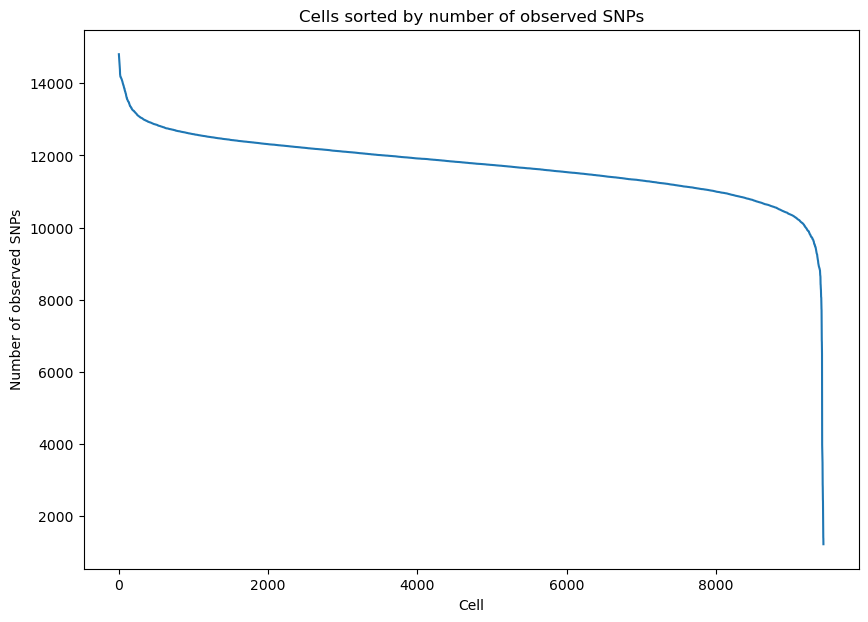

Please determine y-axis threshold in the plot to filter low-quality cells with low number of observed SNPs.   10000


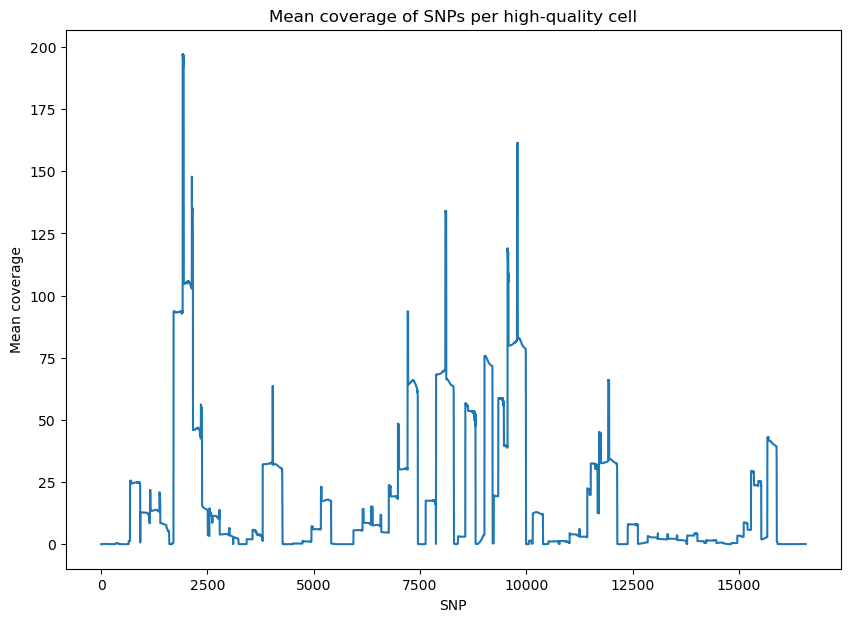

Please determine y-axis threshold in the plot to filter low-quality SNPs with low coverage.   5


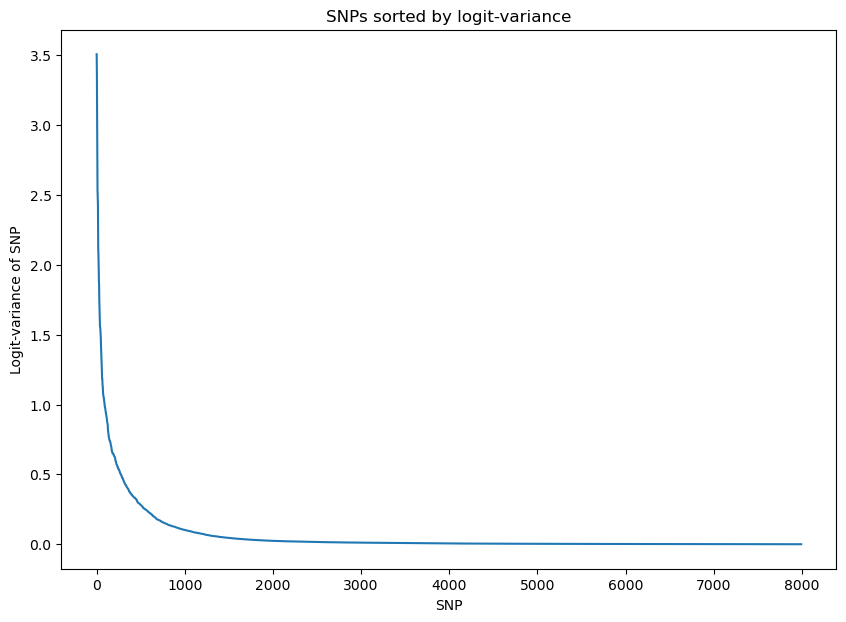

Please determine y-axis threshold in the plot to filter low-quality SNPs with low logit-variance.   0.5
Finish filtering low-quality data, 9204 cells and 274 SNPs will be used for downstream analysis.
Start training VAE.
Epoch[10/2000], Cost: 4.140039
Epoch[20/2000], Cost: 2.781532
Epoch[30/2000], Cost: 2.710119
Epoch[40/2000], Cost: 2.696343
Epoch[50/2000], Cost: 2.689610
Epoch[60/2000], Cost: 2.684979
Epoch[70/2000], Cost: 2.681585
Epoch[80/2000], Cost: 2.678909
Epoch[90/2000], Cost: 2.675725
Epoch[100/2000], Cost: 2.672750
Epoch[110/2000], Cost: 2.670449
Epoch[120/2000], Cost: 2.668268
Epoch[130/2000], Cost: 2.665436
Epoch[140/2000], Cost: 2.663404
Epoch[150/2000], Cost: 2.661055
Epoch[160/2000], Cost: 2.659076
Epoch[170/2000], Cost: 2.656859
Epoch[180/2000], Cost: 2.654499
Epoch[190/2000], Cost: 2.652469
Epoch[200/2000], Cost: 2.650249
Epoch[210/2000], Cost: 2.648030
Epoch[220/2000], Cost: 2.645898
Epoch[230/2000], Cost: 2.643624
Epoch[240/2000], Cost: 2.641637
Epoch[250/2000], Cos

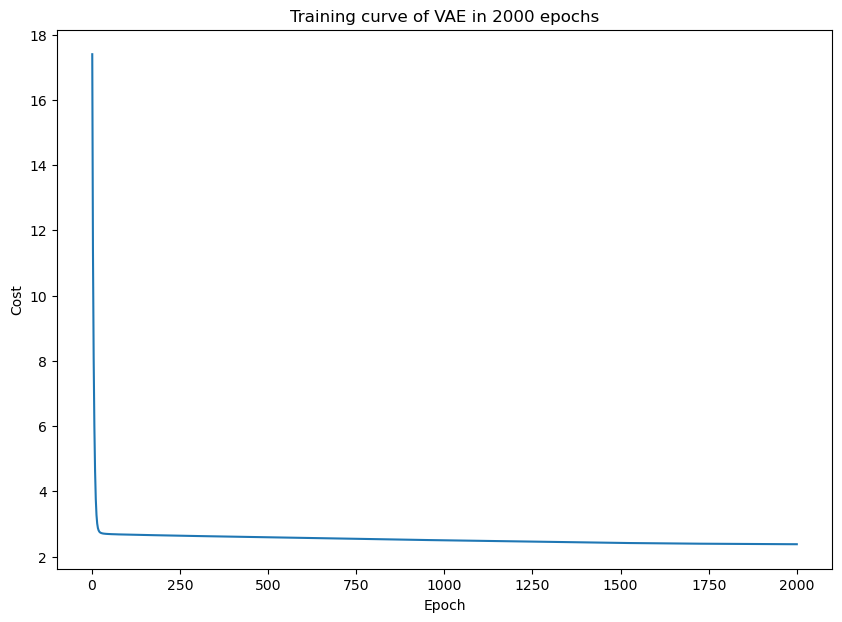

Start learning PCA and UMAP of latent space in VAE.
Finish learning, PCA and UMAP of latent space will be shown below.


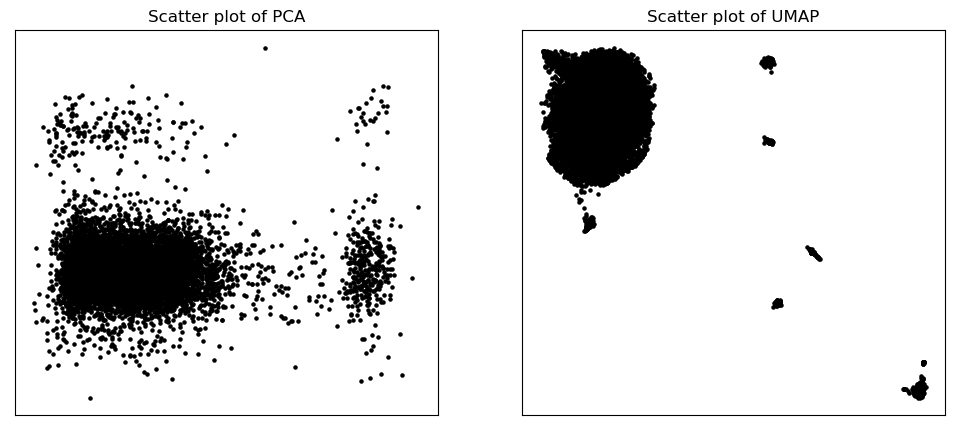

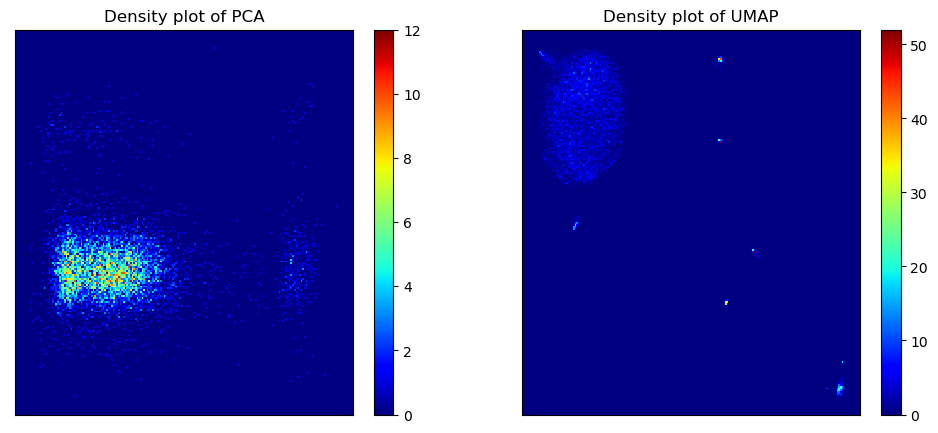

Start clustering.
Finish clustering.
PCA and UMAP of individual clusters will be shown below.


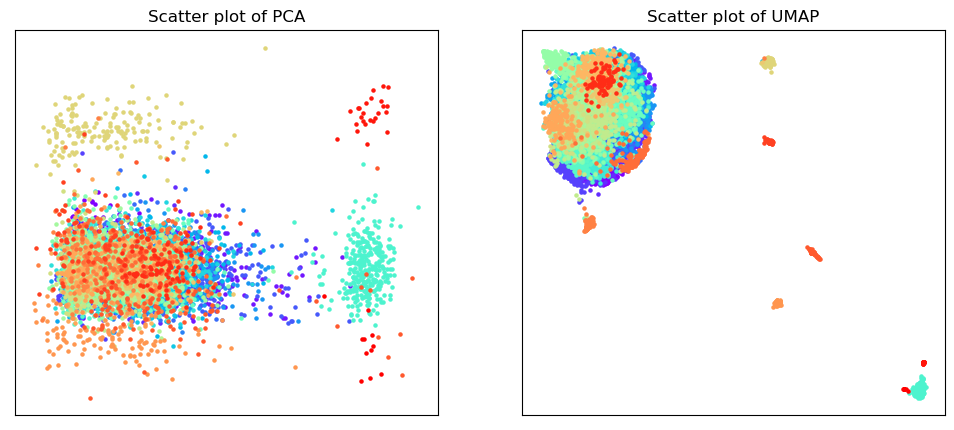

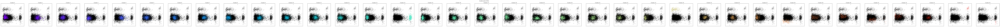

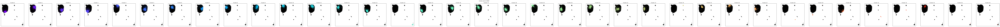

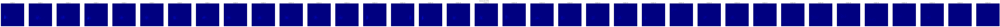

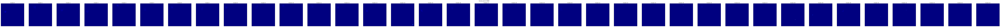

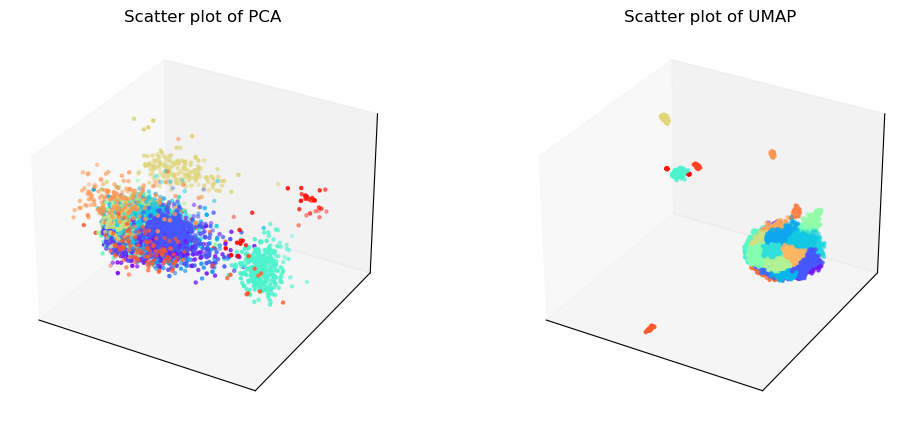

Phylogenetic tree in latent space will be shown below.


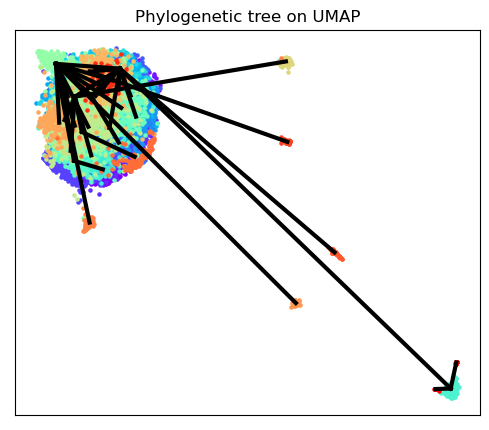

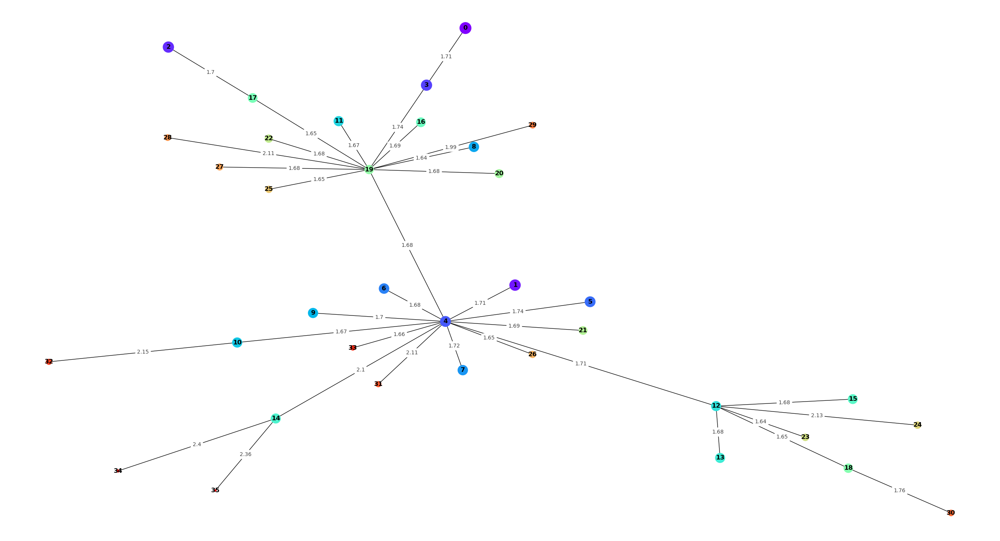

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:261: RuntimeWarning: divide by zero encountered in true_divide


SNP-allelic ratios of 9204 cells and 50 SNPs will be shown below.


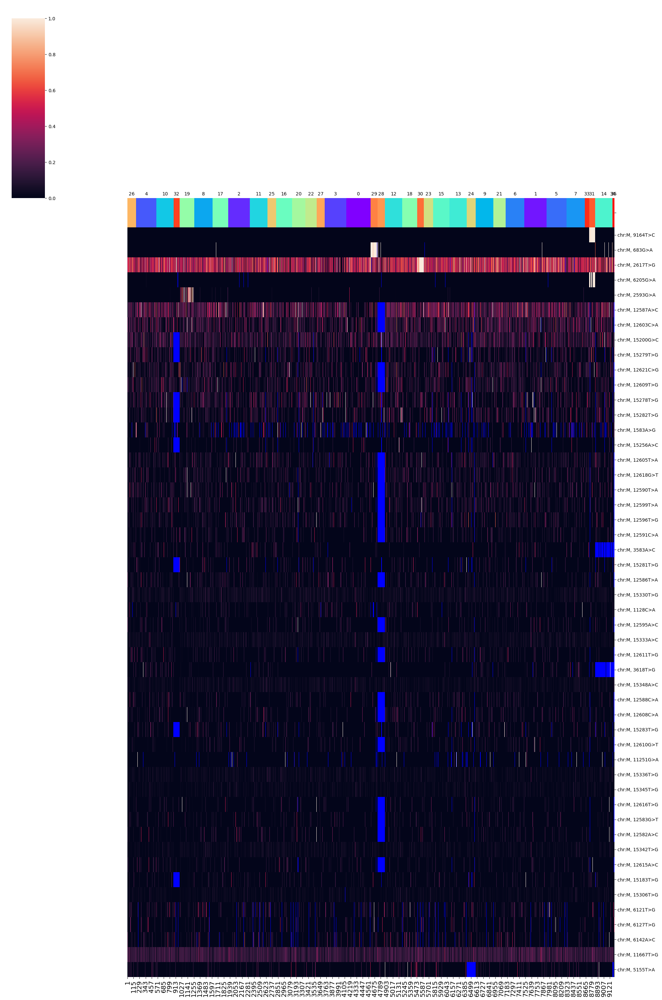

SNPs sorted by lowest p-value will be shown below


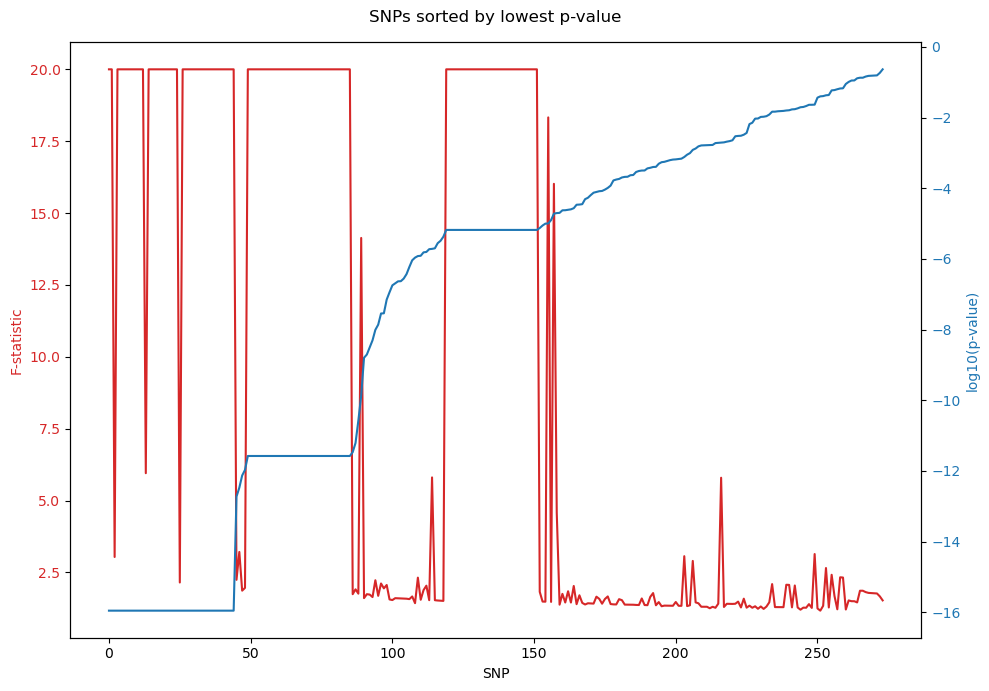

In [1]:
%run /home/u3570318/mount2/figures_final2/notebook2/SNPmanifold.ipynb
test1 = SNP_VAE(AD = "/home/u3570318/mount2/figures_final2/data/BPDCN/cellSNP.tag.AD.mtx", DP = "/home/u3570318/mount2/figures_final2/data/BPDCN/cellSNP.tag.DP.mtx", variant_name = "/home/u3570318/mount2/figures_final2/data/BPDCN/variant_name.tsv")
test1.filtering()
test1.training()
test1.clustering()
test1.phylogeny()

PCA and UMAP of individual clusters will be shown below.


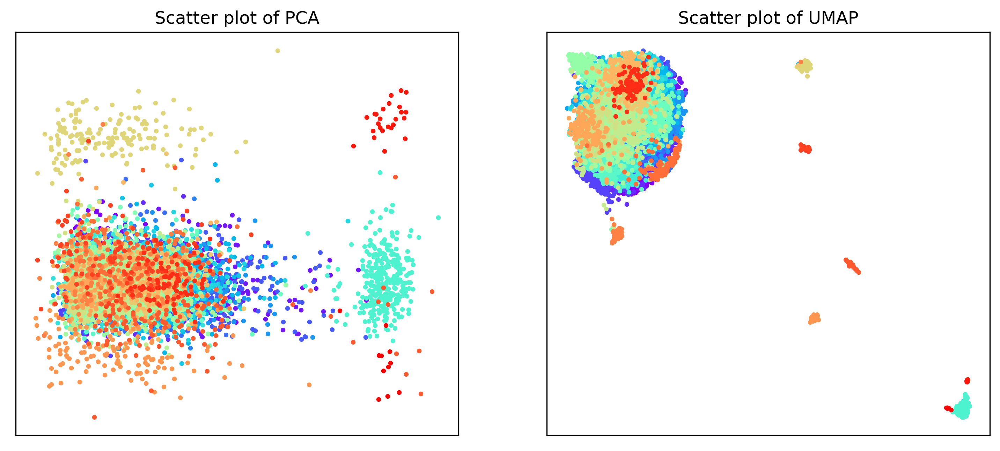

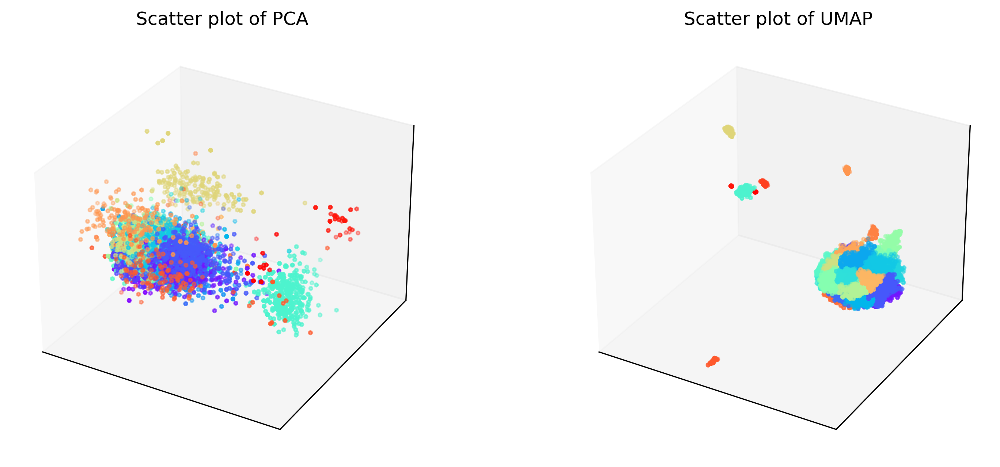

Phylogenetic tree in latent space will be shown below.


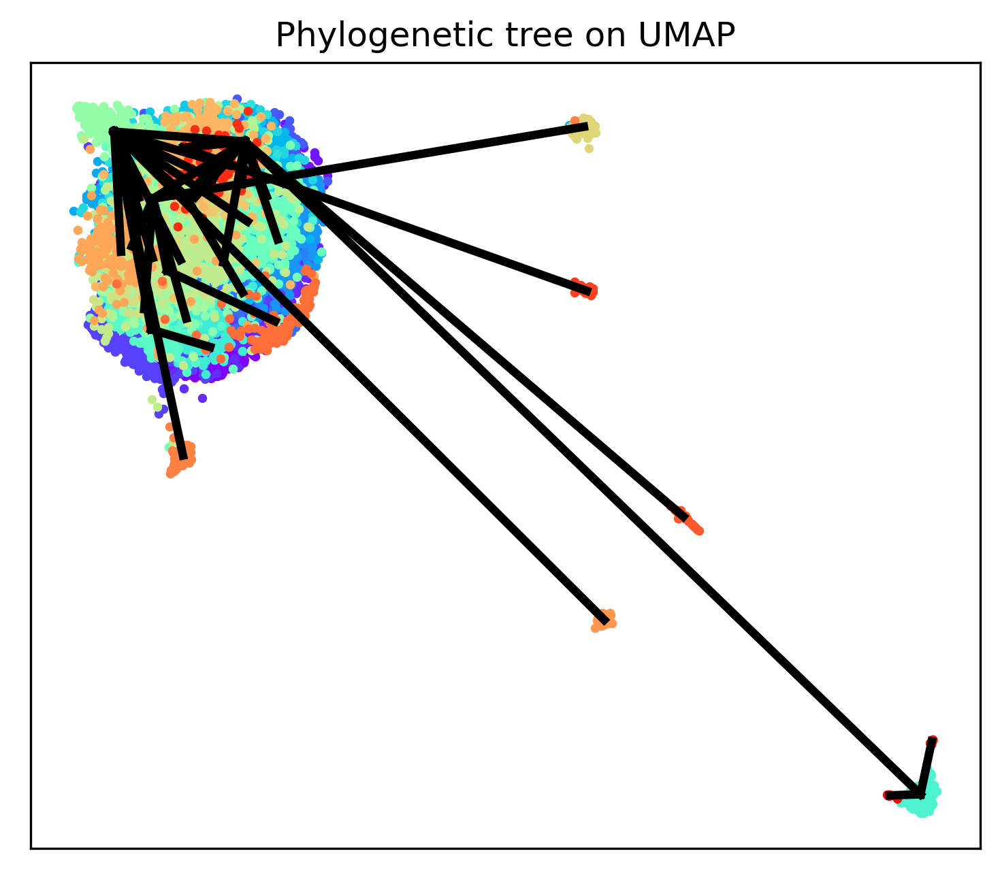

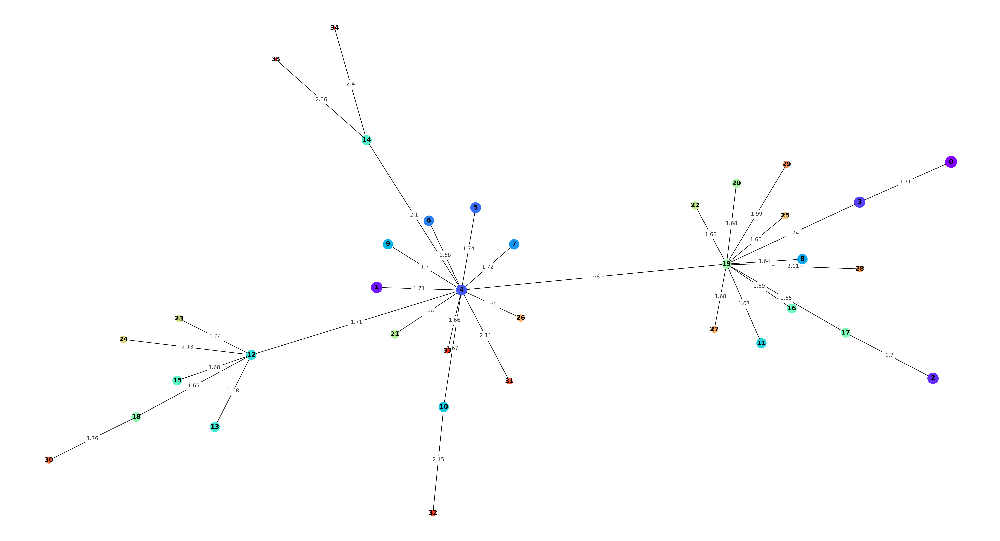

SNP-allelic ratios of 9204 cells and 100 SNPs will be shown below.


SNPs sorted by lowest p-value will be shown below


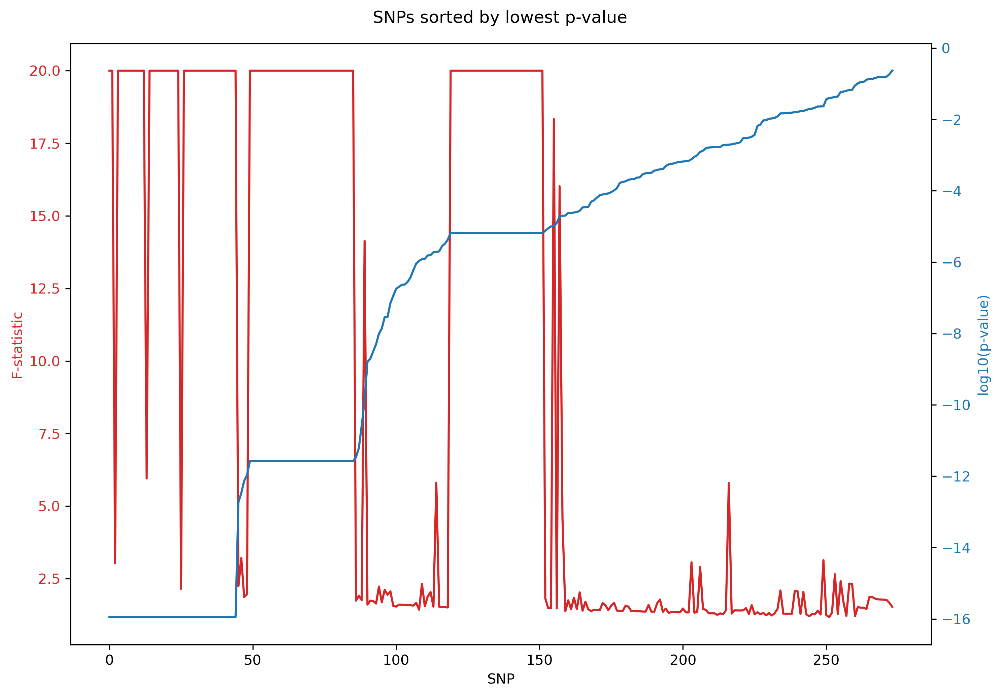

In [6]:
test1.phylogeny_summary(dpi = 300, SNP_no = 100, fontsize_y = 14, fontsize_x = 12, fontsize_c = 15)

PCA and UMAP of individual clusters will be shown below.


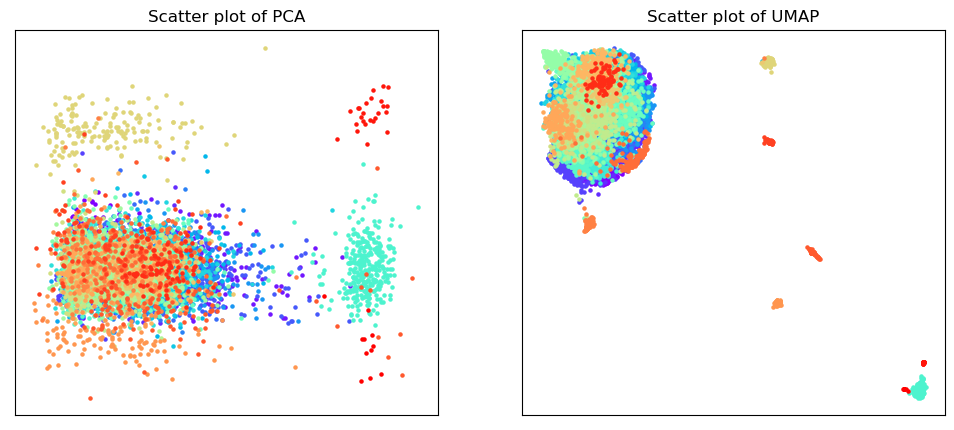

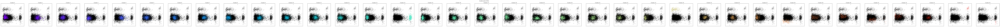

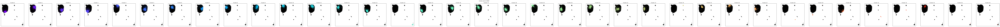

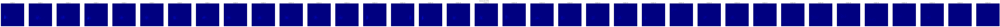

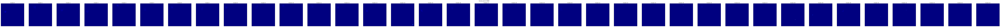

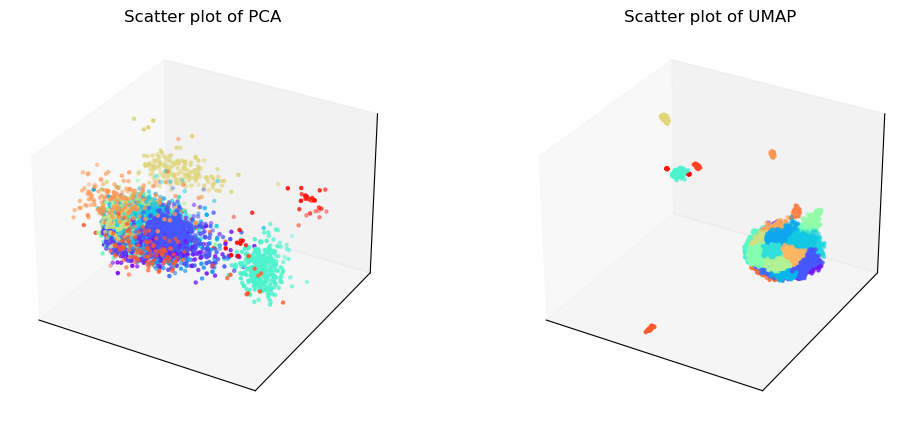

Phylogenetic tree in latent space will be shown below.


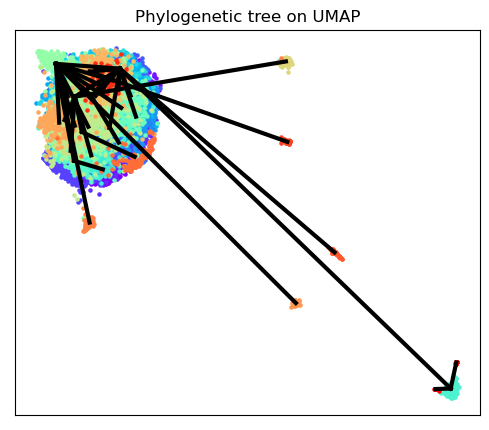

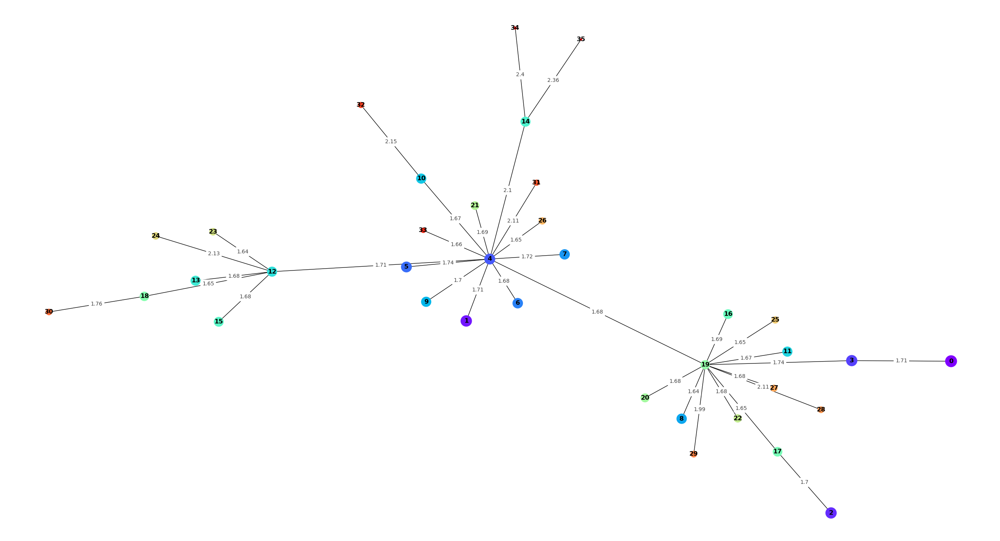

SNP-allelic ratios of 9204 cells and 100 SNPs will be shown below.


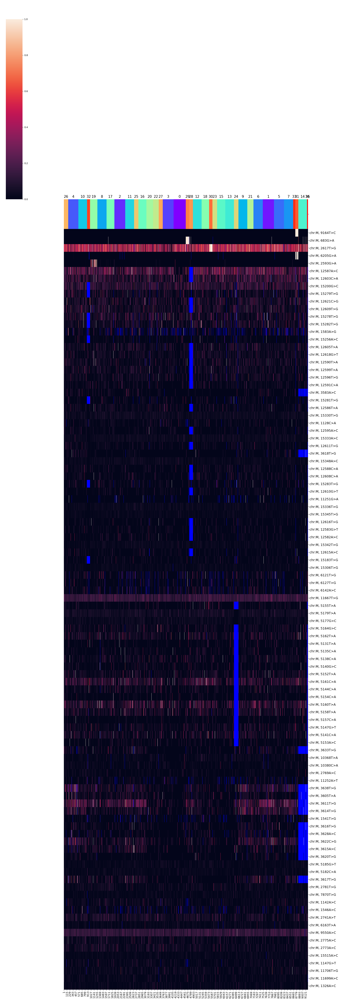

SNPs sorted by lowest p-value will be shown below


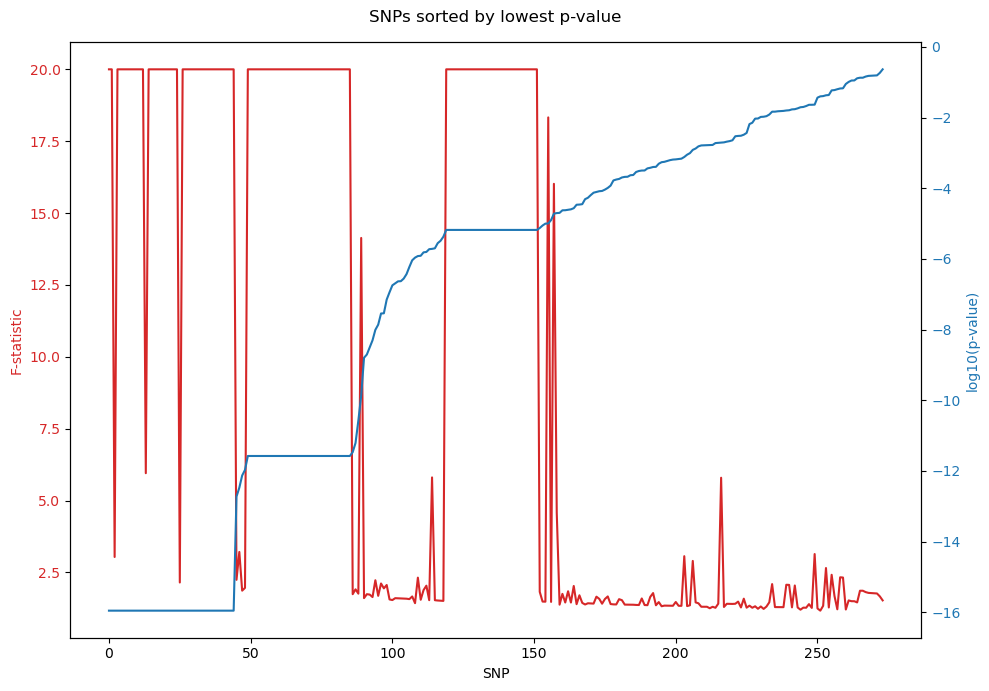

In [15]:
test1.phylogeny_summary(SNP_no = 100, fontsize_y = 14, fontsize_x = 12, fontsize_c = 15)

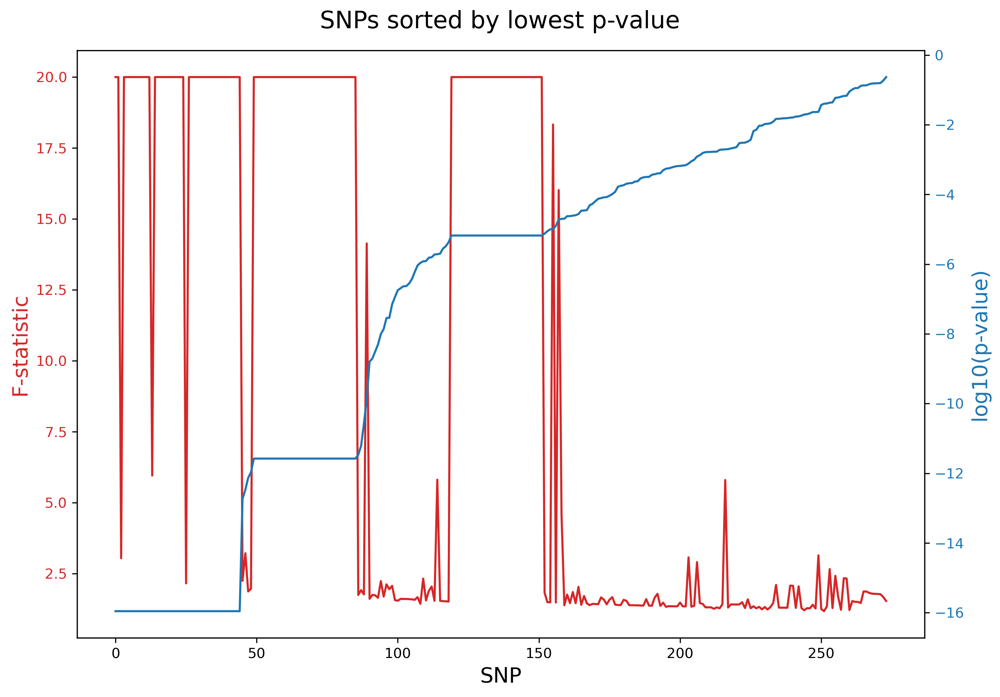

In [2]:
fig, ax1 = plt.subplots(dpi = 300)
fig.set_size_inches(10, 7)
fig.suptitle("SNPs sorted by lowest p-value", fontsize = 17)

ax1.set_xlabel('SNP', fontsize = 15)
ax1.set_ylabel('F-statistic', color = 'tab:red', fontsize = 15)
ax1.plot(np.arange(test1.SNP_total), test1.f_stat_ranked, color = 'tab:red')
ax1.tick_params(axis = 'y', labelcolor = 'tab:red')

ax2 = ax1.twinx()

color = 'tab:blue'
ax2.set_ylabel('log10(p-value)', color = 'tab:blue', fontsize = 15)
ax2.plot(np.arange(test1.SNP_total), np.log10(test1.p_value_ranked), color = 'tab:blue')
ax2.tick_params(axis = 'y', labelcolor = 'tab:blue')

fig.tight_layout()
plt.show()

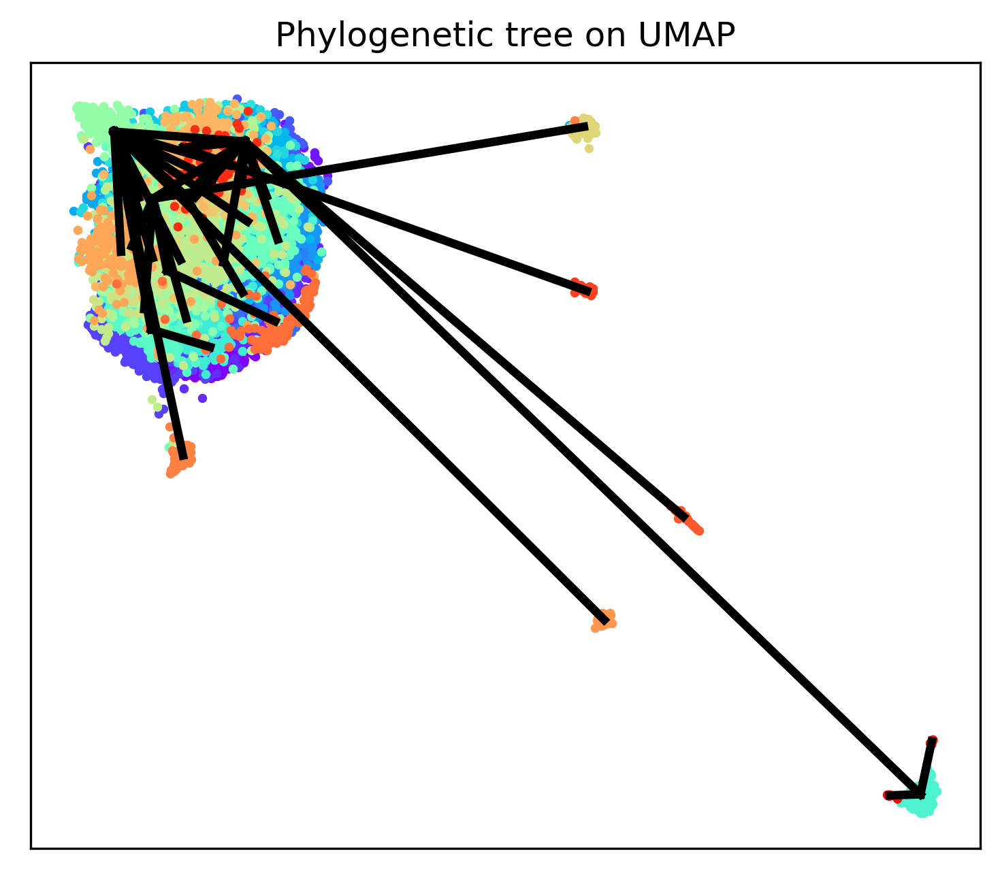

In [3]:
fig, axs = plt.subplots(1, 1, dpi = 300)
fig.set_size_inches(6, 5)

axs.set_title("Phylogenetic tree on UMAP")
axs.set_xticks([])
axs.set_yticks([])

for g in range(test1.cluster_no):

    axs.scatter(test1.embedding_2d[test1.clusters[g], 0], test1.embedding_2d[test1.clusters[g], 1], s = 5, color = test1.colors[g])

for g in range(len(test1.edge)):

    axs.plot([test1.centre_2d[test1.edge[g][0], 0], test1.centre_2d[test1.edge[g][1], 0]], [test1.centre_2d[test1.edge[g][0], 1], test1.centre_2d[test1.edge[g][1], 1]], linewidth = 3, color = "black")

plt.show()

Phylogenetic tree in latent space will be shown below.


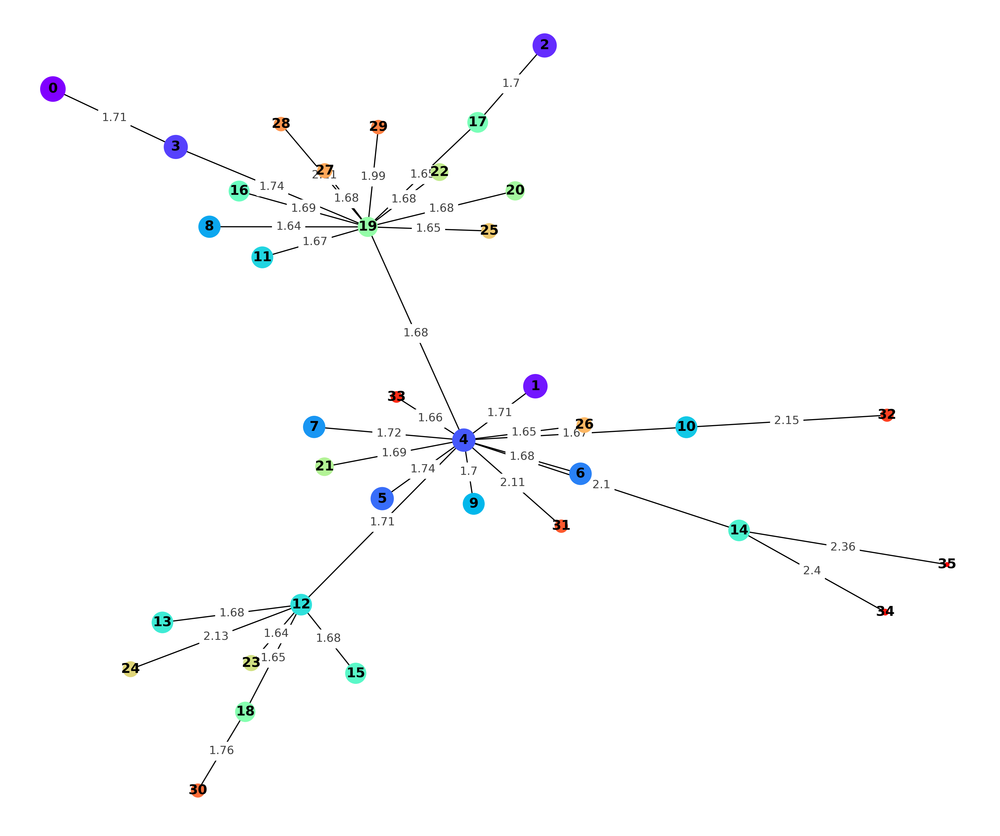

In [4]:
print(f"Phylogenetic tree in latent space will be shown below.")

graph = nx.Graph()

for u in range(len(test1.edge)):

    graph.add_edge(test1.edge[u][0], test1.edge[u][1], weight = test1.edge_weight[u], length = test1.edge_length_normalized[u])

pos = nx.spring_layout(graph, iterations = 3000, weight = 'weight')

plt.figure(figsize = (12, 10), dpi = 300) 
nx.draw(graph, pos, with_labels = True, font_weight = 'bold', node_size = test1.cluster_size[test1.connect_order], node_color = test1.colors[test1.connect_order])
nx.draw_networkx_edge_labels(graph, pos, nx.get_edge_attributes(graph, 'length'), rotate = False, alpha = 0.75)

plt.show()

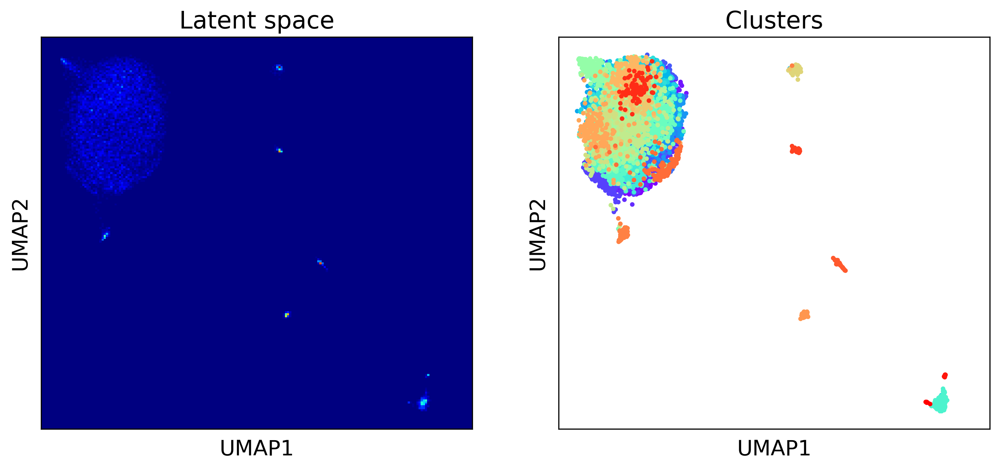

In [7]:
fig, axs = plt.subplots(1, 2, dpi = 300)
fig.set_size_inches(12, 5)

axs[0].hist2d(test1.embedding_2d[:, 0], test1.embedding_2d[:, 1], bins = (200, 200), cmap = plt.cm.jet, range = np.array([(test1.xlim_embedding_2d[0], test1.xlim_embedding_2d[1] + 1), test1.ylim_embedding_2d]))
axs[0].set_xticks([])
axs[0].set_yticks([])
axs[0].set_title("Latent space", fontsize = 17)
axs[0].set_xlabel("UMAP1", fontsize = 15)
axs[0].set_ylabel("UMAP2", fontsize = 15)

axs[1].set_title("Clusters", fontsize = 17)

for w in range(test1.cluster_no):
    
    axs[1].scatter(test1.embedding_2d[test1.clusters[w], 0], test1.embedding_2d[test1.clusters[w], 1], s = 5, color = test1.colors[w])
    
axs[1].set_xticks([])
axs[1].set_yticks([])
axs[1].set_xlabel("UMAP1", fontsize = 15)
axs[1].set_ylabel("UMAP2", fontsize = 15)
axs[1].set_xlim(np.array((test1.xlim_embedding_2d[0], test1.xlim_embedding_2d[1] + 1)))
axs[1].set_ylim(np.array(test1.ylim_embedding_2d))

plt.show()

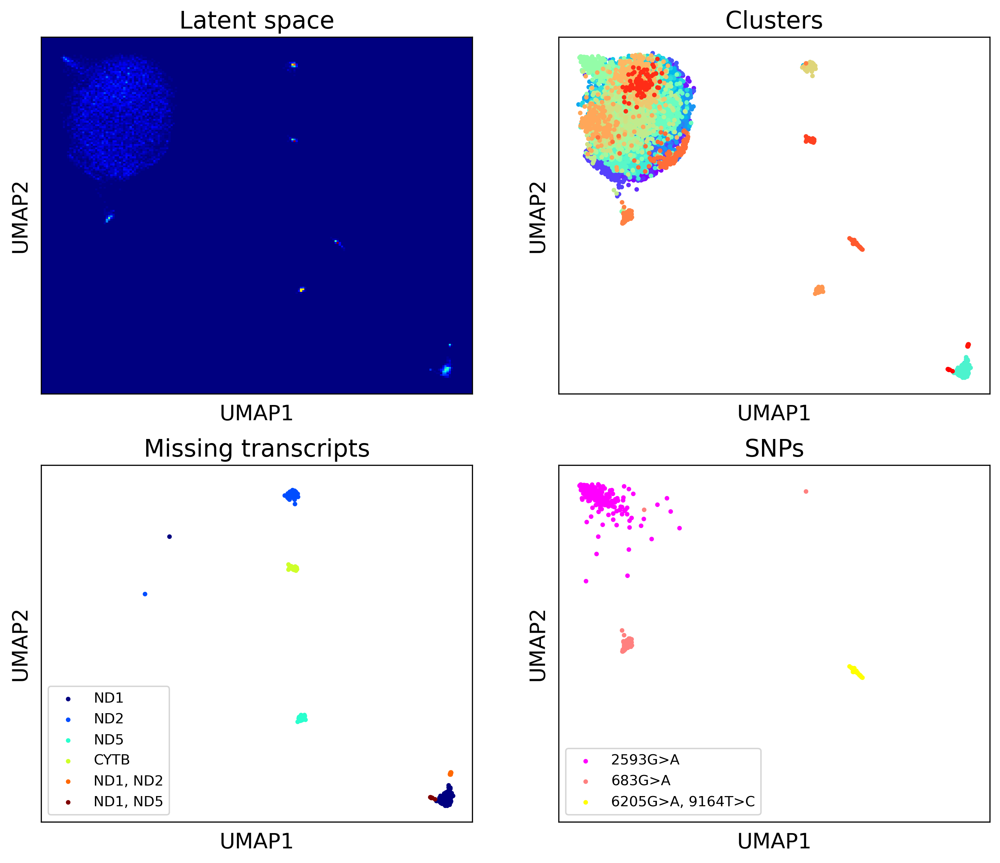

In [52]:
fig, axs = plt.subplots(2, 2, dpi = 300)
fig.set_size_inches(12, 10)

axs[0, 0].hist2d(test1.embedding_2d[:, 0], test1.embedding_2d[:, 1], bins = (200, 200), cmap = plt.cm.jet, range = np.array([test1.xlim_embedding_2d, test1.ylim_embedding_2d]))
axs[0, 0].set_xticks([])
axs[0, 0].set_yticks([])
axs[0, 0].set_title("Latent space", fontsize = 17)
axs[0, 0].set_xlabel("UMAP1", fontsize = 15)
axs[0, 0].set_ylabel("UMAP2", fontsize = 15)

axs[0, 1].set_title("Clusters", fontsize = 17)

for w in range(test1.cluster_no):
    
    axs[0, 1].scatter(test1.embedding_2d[test1.clusters[w], 0], test1.embedding_2d[test1.clusters[w], 1], s = 5, color = test1.colors[w])
    
axs[0, 1].set_xticks([])
axs[0, 1].set_yticks([])
axs[0, 1].set_xlabel("UMAP1", fontsize = 15)
axs[0, 1].set_ylabel("UMAP2", fontsize = 15)

axs[1, 1].set_title("SNPs", fontsize = 17)

colors = cm.spring(np.linspace(0, 1, 3))

axs[1, 1].scatter(test1.embedding_2d[test1.clusters[19], 0], test1.embedding_2d[test1.clusters[19], 1], s = 5, color = colors[0], label = '2593G>A')

axs[1, 1].scatter(test1.embedding_2d[test1.clusters[29], 0], test1.embedding_2d[test1.clusters[29], 1], s = 5, color = colors[1], label = '683G>A')
    
axs[1, 1].scatter(test1.embedding_2d[test1.clusters[31], 0], test1.embedding_2d[test1.clusters[31], 1], s = 5, color = colors[2], label = '6205G>A, 9164T>C')
    
axs[1, 1].set_xticks([])
axs[1, 1].set_yticks([])
axs[1, 1].set_xlim(test1.xlim_embedding_2d)
axs[1, 1].set_ylim(test1.ylim_embedding_2d)
axs[1, 1].set_xlabel("UMAP1", fontsize = 15)
axs[1, 1].set_ylabel("UMAP2", fontsize = 15)
axs[1, 1].legend(loc ="lower left", fontsize = "10")

axs[1, 0].set_title("Missing transcripts", fontsize = 17)

colors = cm.jet(np.linspace(0, 1, 6))

axs[1, 0].scatter(test1.embedding_2d[test1.clusters[14], 0], test1.embedding_2d[test1.clusters[14], 1], s = 5, color = colors[0], label = 'ND1')
    
axs[1, 0].scatter(test1.embedding_2d[test1.clusters[24], 0], test1.embedding_2d[test1.clusters[24], 1], s = 5, color = colors[1], label = 'ND2')
    
axs[1, 0].scatter(test1.embedding_2d[test1.clusters[28], 0], test1.embedding_2d[test1.clusters[28], 1], s = 5, color = colors[2], label = 'ND5')

axs[1, 0].scatter(test1.embedding_2d[test1.clusters[32], 0], test1.embedding_2d[test1.clusters[32], 1], s = 5, color = colors[3], label = 'CYTB')

axs[1, 0].scatter(test1.embedding_2d[test1.clusters[34], 0], test1.embedding_2d[test1.clusters[34], 1], s = 5, color = colors[4], label = 'ND1, ND2')

axs[1, 0].scatter(test1.embedding_2d[test1.clusters[35], 0], test1.embedding_2d[test1.clusters[35], 1], s = 5, color = colors[5], label = 'ND1, ND5')
    
axs[1, 0].set_xticks([])
axs[1, 0].set_yticks([])
axs[1, 0].set_xlim(test1.xlim_embedding_2d)
axs[1, 0].set_ylim(test1.ylim_embedding_2d)
axs[1, 0].set_xlabel("UMAP1", fontsize = 15)
axs[1, 0].set_ylabel("UMAP2", fontsize = 15)
axs[1, 0].legend(loc ="lower left", fontsize = "10")

plt.show()

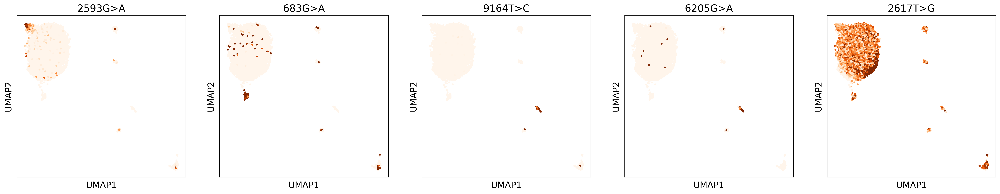

In [53]:
SNP_no = 100

AF_sorted_missing_to_zero = np.copy(test1.AF_sorted)
AF_sorted_missing_to_zero[np.isnan(test1.AF_sorted)] = 0

color_AF = cm.Oranges(np.linspace(0, 1, 101))
embedding_2d_sorted = test1.embedding_2d[test1.cell_sorted, :]

fig, axs = plt.subplots(1, 5, dpi = 300)
fig.set_size_inches(30, 5)
    
position1 = 4
title1 = "2593G>A"

AF_density = np.round(AF_sorted_missing_to_zero[:SNP_no, :][position1, :] * 100).astype(int)
counter = collections.Counter(AF_density)
numbers_AF = list(counter.keys())

axs[0].set_title(title1, fontsize = 17)

for j in numbers_AF:

    axs[0].scatter(embedding_2d_sorted[AF_density == j, 0], embedding_2d_sorted[AF_density == j, 1], s = 5, color = color_AF[j])

axs[0].set_xticks([])
axs[0].set_yticks([])
axs[0].set_xlabel("UMAP1", fontsize = 15)
axs[0].set_ylabel("UMAP2", fontsize = 15)

position1 = 1
title1 = "683G>A"

AF_density = np.round(AF_sorted_missing_to_zero[:SNP_no, :][position1, :] * 100).astype(int)
counter = collections.Counter(AF_density)
numbers_AF = list(counter.keys())

axs[1].set_title(title1, fontsize = 17)

for j in numbers_AF:

    axs[1].scatter(embedding_2d_sorted[AF_density == j, 0], embedding_2d_sorted[AF_density == j, 1], s = 5, color = color_AF[j])

axs[1].set_xticks([])
axs[1].set_yticks([])
axs[1].set_xlabel("UMAP1", fontsize = 15)
axs[1].set_ylabel("UMAP2", fontsize = 15)

position1 = 0
title1 = "9164T>C"

AF_density = np.round(AF_sorted_missing_to_zero[:SNP_no, :][position1, :] * 100).astype(int)
counter = collections.Counter(AF_density)
numbers_AF = list(counter.keys())

axs[2].set_title(title1, fontsize = 17)

for j in numbers_AF:

    axs[2].scatter(embedding_2d_sorted[AF_density == j, 0], embedding_2d_sorted[AF_density == j, 1], s = 5, color = color_AF[j])

axs[2].set_xticks([])
axs[2].set_yticks([])
axs[2].set_xlabel("UMAP1", fontsize = 15)
axs[2].set_ylabel("UMAP2", fontsize = 15)

position1 = 3
title1 = "6205G>A"

AF_density = np.round(AF_sorted_missing_to_zero[:SNP_no, :][position1, :] * 100).astype(int)
counter = collections.Counter(AF_density)
numbers_AF = list(counter.keys())

axs[3].set_title(title1, fontsize = 17)

for j in numbers_AF:

    axs[3].scatter(embedding_2d_sorted[AF_density == j, 0], embedding_2d_sorted[AF_density == j, 1], s = 5, color = color_AF[j])

axs[3].set_xticks([])
axs[3].set_yticks([])
axs[3].set_xlabel("UMAP1", fontsize = 15)
axs[3].set_ylabel("UMAP2", fontsize = 15)

position1 = 2
title1 = "2617T>G"

AF_density = np.round(AF_sorted_missing_to_zero[:SNP_no, :][position1, :] * 100).astype(int)
counter = collections.Counter(AF_density)
numbers_AF = list(counter.keys())

axs[4].set_title(title1, fontsize = 17)

for j in numbers_AF:

    axs[4].scatter(embedding_2d_sorted[AF_density == j, 0], embedding_2d_sorted[AF_density == j, 1], s = 5, color = color_AF[j])

axs[4].set_xticks([])
axs[4].set_yticks([])
axs[4].set_xlabel("UMAP1", fontsize = 15)
axs[4].set_ylabel("UMAP2", fontsize = 15)

plt.show()

In [54]:
refer = pd.read_csv("/home/u3570318/mount2/figures_final2/data/BPDCN/GSM5534705_BPDCN712_10x_scRNAseq_MetaData.txt", delimiter = '\t')
sample = pd.read_csv("/home/u3570318/mount2/figures_final2/data/BPDCN/sample.csv")

include = []
include_sample = []

for w in range(len(sample["sample"].to_list())):
    
    if sample["sample"].to_list()[w] in refer.index.to_numpy():
    
        include.append(np.where(refer.index.to_numpy() == sample["sample"].to_list()[w])[0][0])
        include_sample.append(True)
        
    elif sample["sample"].to_list()[w] not in refer.index.to_numpy():
    
        include_sample.append(False)


import collections
counter = collections.Counter(refer["CellType"].to_numpy()[include][test1.cell_filter[include_sample]])
counter.keys()

dict_keys(['cDC', 'T', 'CTL', 'NK', 'LateE', 'B', 'EarlyE', 'ProMono', 'pDC', 'Mono', 'ncMono', 'HSC', 'Plasma', 'Prog'])

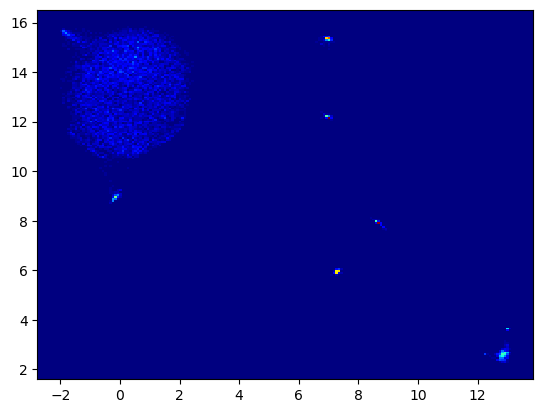

In [55]:
emb = test1.embedding_2d[np.array(include_sample)[test1.cell_filter], :]
plt.hist2d(emb[:, 0], emb[:, 1], range = [test1.xlim_embedding_2d, test1.ylim_embedding_2d], bins = 200, cmap = plt.cm.jet)
plt.show()

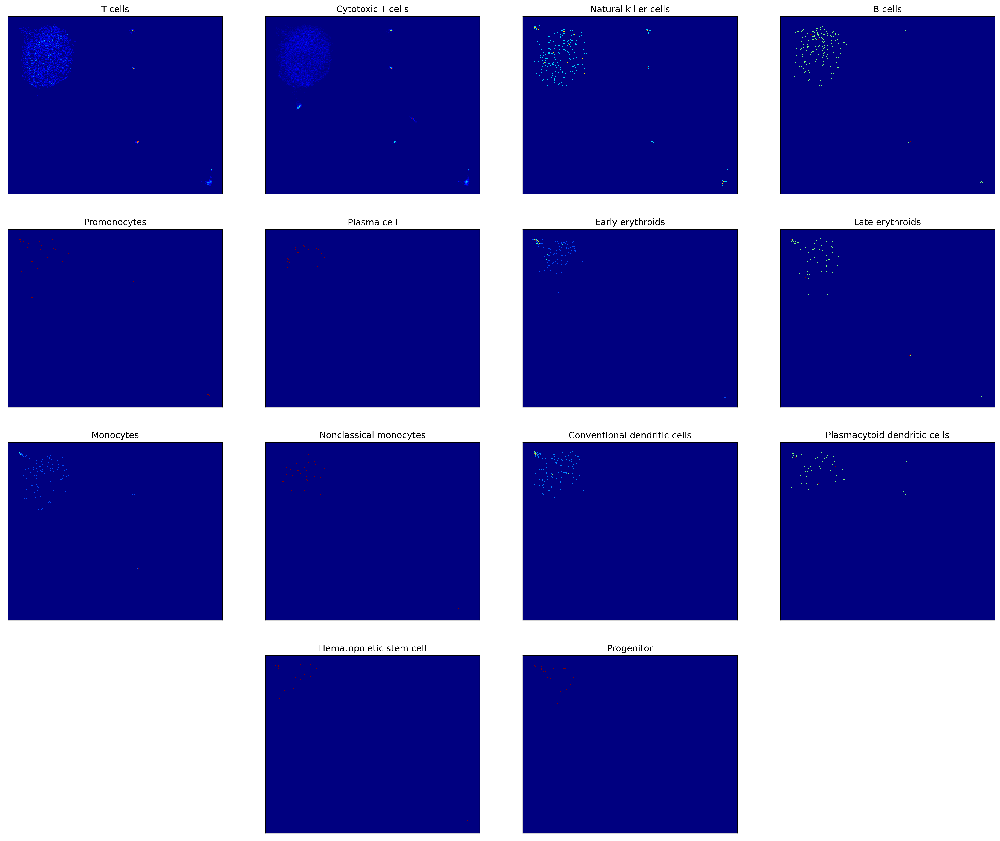

In [56]:
index = ['T', 'CTL', 'NK', 'B', 'ProMono', 'Plasma', 'EarlyE', 'LateE', 'Mono', 'ncMono', 'cDC', 'pDC', 'HSC', 'Prog']
titles = ["T cells", "Cytotoxic T cells", "Natural killer cells", "B cells", "Promonocytes", "Plasma cell", "Early erythroids", "Late erythroids", "Monocytes", "Nonclassical monocytes", "Conventional dendritic cells", "Plasmacytoid dendritic cells", "Hematopoietic stem cell", "Progenitor"]

fig, axs = plt.subplots(4, 4, dpi = 300)
fig.set_size_inches(24, 20)

for w in range(4):
    
    place = np.where(refer["CellType"].to_numpy()[include][test1.cell_filter[include_sample]] == index[w])[0]
    axs[0, w].hist2d(emb[place, 0], emb[place, 1], range = [test1.xlim_embedding_2d, test1.ylim_embedding_2d], bins = 200, cmap = plt.cm.jet)
    axs[0, w].set_xticks([])
    axs[0, w].set_yticks([])
    axs[0, w].set_title(titles[w])
    
    place = np.where(refer["CellType"].to_numpy()[include][test1.cell_filter[include_sample]] == index[w + 4])[0]
    axs[1, w].hist2d(emb[place, 0], emb[place, 1], range = [test1.xlim_embedding_2d, test1.ylim_embedding_2d], bins = 200, cmap = plt.cm.jet)
    axs[1, w].set_xticks([])
    axs[1, w].set_yticks([])
    axs[1, w].set_title(titles[w + 4])
    
    place = np.where(refer["CellType"].to_numpy()[include][test1.cell_filter[include_sample]] == index[w + 8])[0]
    axs[2, w].hist2d(emb[place, 0], emb[place, 1], range = [test1.xlim_embedding_2d, test1.ylim_embedding_2d], bins = 200, cmap = plt.cm.jet)
    axs[2, w].set_xticks([])
    axs[2, w].set_yticks([])
    axs[2, w].set_title(titles[w + 8])
    
place = np.where(refer["CellType"].to_numpy()[include][test1.cell_filter[include_sample]] == index[12])[0]
axs[3, 1].hist2d(emb[place, 0], emb[place, 1], range = [test1.xlim_embedding_2d, test1.ylim_embedding_2d], bins = 200, cmap = plt.cm.jet)
axs[3, 1].set_xticks([])
axs[3, 1].set_yticks([])
axs[3, 1].set_title(titles[12])

place = np.where(refer["CellType"].to_numpy()[include][test1.cell_filter[include_sample]] == index[13])[0]
axs[3, 2].hist2d(emb[place, 0], emb[place, 1], range = [test1.xlim_embedding_2d, test1.ylim_embedding_2d], bins = 200, cmap = plt.cm.jet)
axs[3, 2].set_xticks([])
axs[3, 2].set_yticks([])
axs[3, 2].set_title(titles[13])

fig.delaxes(axs[3, 0])
fig.delaxes(axs[3, 3])

plt.show()

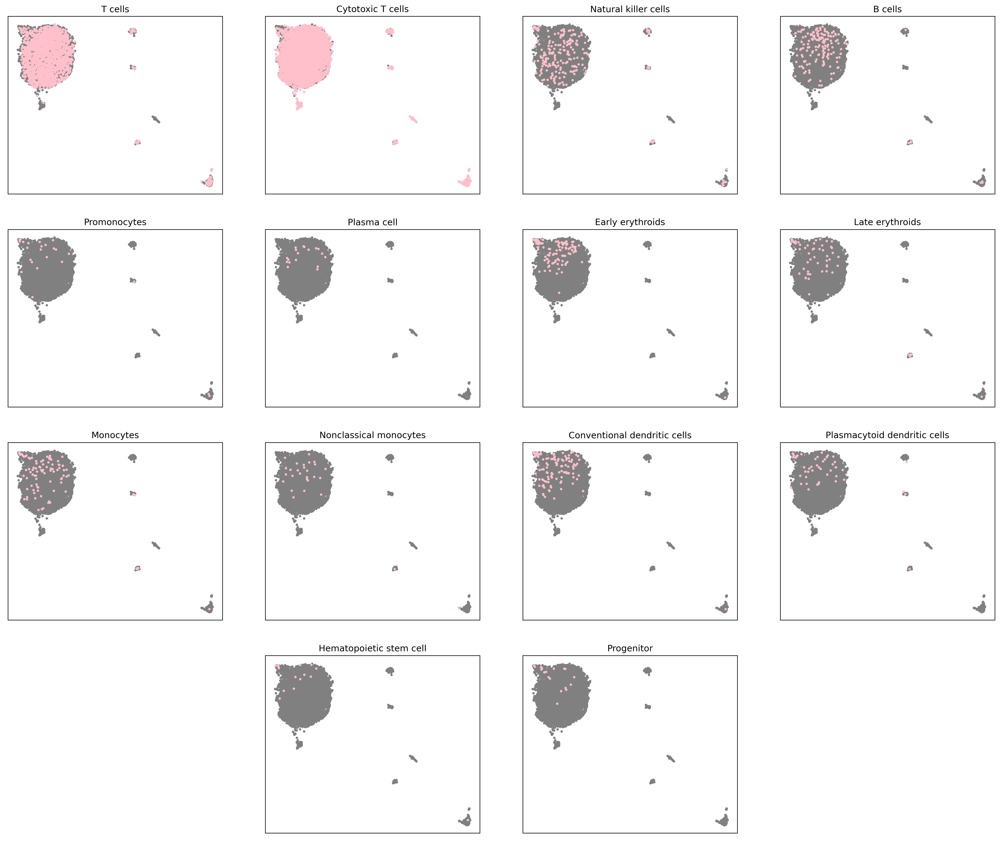

In [58]:
index = ['T', 'CTL', 'NK', 'B', 'ProMono', 'Plasma', 'EarlyE', 'LateE', 'Mono', 'ncMono', 'cDC', 'pDC', 'HSC', 'Prog']
titles = ["T cells", "Cytotoxic T cells", "Natural killer cells", "B cells", "Promonocytes", "Plasma cell", "Early erythroids", "Late erythroids", "Monocytes", "Nonclassical monocytes", "Conventional dendritic cells", "Plasmacytoid dendritic cells", "Hematopoietic stem cell", "Progenitor"]
c1 = "grey"
c2 = "pink"

fig, axs = plt.subplots(4, 4, dpi = 300)
fig.set_size_inches(24, 20)

for w in range(4):
    
    place = np.where(refer["CellType"].to_numpy()[include][test1.cell_filter[include_sample]] == index[w])[0]
    axs[0, w].scatter(emb[:, 0], emb[:, 1], s = 5, c = c1)
    axs[0, w].scatter(emb[place, 0], emb[place, 1], s = 5, c = c2)
    axs[0, w].set_xticks([])
    axs[0, w].set_yticks([])
    axs[0, w].set_title(titles[w])
    axs[0, w].set_xlim(test1.xlim_embedding_2d)
    axs[0, w].set_ylim(test1.ylim_embedding_2d)
    
    place = np.where(refer["CellType"].to_numpy()[include][test1.cell_filter[include_sample]] == index[w + 4])[0]
    axs[1, w].scatter(emb[:, 0], emb[:, 1], s = 5, c = c1)
    axs[1, w].scatter(emb[place, 0], emb[place, 1], s = 5, c = c2)
    axs[1, w].set_xticks([])
    axs[1, w].set_yticks([])
    axs[1, w].set_title(titles[w + 4])
    axs[1, w].set_xlim(test1.xlim_embedding_2d)
    axs[1, w].set_ylim(test1.ylim_embedding_2d)
    
    place = np.where(refer["CellType"].to_numpy()[include][test1.cell_filter[include_sample]] == index[w + 8])[0]
    axs[2, w].scatter(emb[:, 0], emb[:, 1], s = 5, c = c1)
    axs[2, w].scatter(emb[place, 0], emb[place, 1], s = 5, c = c2)
    axs[2, w].set_xticks([])
    axs[2, w].set_yticks([])
    axs[2, w].set_title(titles[w + 8])
    axs[2, w].set_xlim(test1.xlim_embedding_2d)
    axs[2, w].set_ylim(test1.ylim_embedding_2d)
    
place = np.where(refer["CellType"].to_numpy()[include][test1.cell_filter[include_sample]] == index[12])[0]
axs[3, 1].scatter(emb[:, 0], emb[:, 1], s = 5, c = c1)
axs[3, 1].scatter(emb[place, 0], emb[place, 1], s = 5, c = c2)
axs[3, 1].set_xticks([])
axs[3, 1].set_yticks([])
axs[3, 1].set_title(titles[12])
axs[3, 1].set_xlim(test1.xlim_embedding_2d)
axs[3, 1].set_ylim(test1.ylim_embedding_2d)

place = np.where(refer["CellType"].to_numpy()[include][test1.cell_filter[include_sample]] == index[13])[0]
axs[3, 2].scatter(emb[:, 0], emb[:, 1], s = 5, c = c1)
axs[3, 2].scatter(emb[place, 0], emb[place, 1], s = 5, c = c2)
axs[3, 2].set_xticks([])
axs[3, 2].set_yticks([])
axs[3, 2].set_title(titles[13])
axs[3, 2].set_xlim(test1.xlim_embedding_2d)
axs[3, 2].set_ylim(test1.ylim_embedding_2d)

fig.delaxes(axs[3, 0])
fig.delaxes(axs[3, 3])

plt.show()

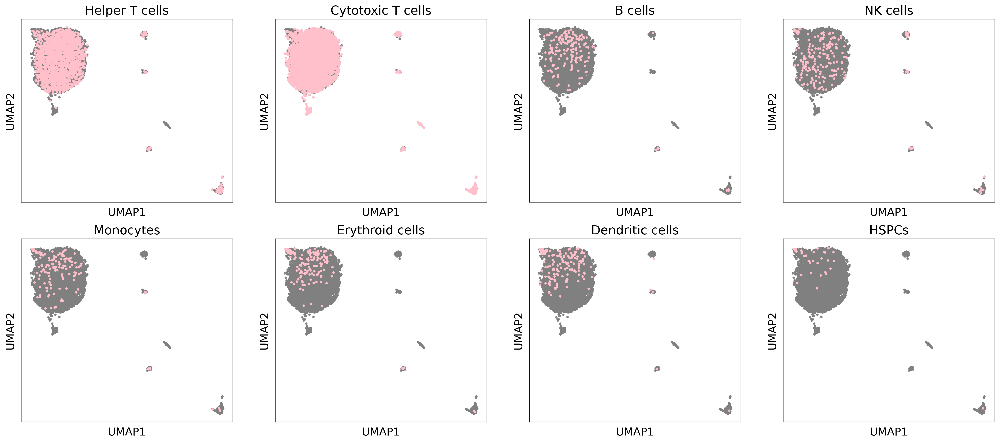

In [60]:
index = ['T', 'CTL', 'NK', 'B', 'ProMono', 'Plasma', 'EarlyE', 'LateE', 'Mono', 'ncMono', 'cDC', 'pDC', 'HSC', 'Prog']
titles = ["T cells", "Cytotoxic T cells", "Natural killer cells", "B cells", "Promonocytes", "Plasma cell", "Early erythroids", "Late erythroids", "Monocytes", "Nonclassical monocytes", "Conventional dendritic cells", "Plasmacytoid dendritic cells", "Hematopoietic stem cell", "Progenitor"]
c1 = "grey"
c2 = "pink"

fig, axs = plt.subplots(2, 4, dpi = 300)
fig.set_size_inches(24, 10)

axs[0, 0].scatter(emb[:, 0], emb[:, 1], s = 5, c = c1)
place = np.where(refer["CellType"].to_numpy()[include][test1.cell_filter[include_sample]] == 'T')[0]
axs[0, 0].scatter(emb[place, 0], emb[place, 1], s = 5, c = c2)
axs[0, 0].set_xticks([])
axs[0, 0].set_yticks([])
axs[0, 0].set_title("Helper T cells", fontsize = 17)
axs[0, 0].set_xlim(test1.xlim_embedding_2d)
axs[0, 0].set_ylim(test1.ylim_embedding_2d)
axs[0, 0].set_xlabel("UMAP1", fontsize = 15)
axs[0, 0].set_ylabel("UMAP2", fontsize = 15)

axs[0, 1].scatter(emb[:, 0], emb[:, 1], s = 5, c = c1)
place = np.where(refer["CellType"].to_numpy()[include][test1.cell_filter[include_sample]] == 'CTL')[0]
axs[0, 1].scatter(emb[place, 0], emb[place, 1], s = 5, c = c2)
axs[0, 1].set_xticks([])
axs[0, 1].set_yticks([])
axs[0, 1].set_title("Cytotoxic T cells", fontsize = 17)
axs[0, 1].set_xlim(test1.xlim_embedding_2d)
axs[0, 1].set_ylim(test1.ylim_embedding_2d)
axs[0, 1].set_xlabel("UMAP1", fontsize = 15)
axs[0, 1].set_ylabel("UMAP2", fontsize = 15)

axs[0, 2].scatter(emb[:, 0], emb[:, 1], s = 5, c = c1)
place = np.where(refer["CellType"].to_numpy()[include][test1.cell_filter[include_sample]] == 'B')[0]
axs[0, 2].scatter(emb[place, 0], emb[place, 1], s = 5, c = c2)
place = np.where(refer["CellType"].to_numpy()[include][test1.cell_filter[include_sample]] == 'Plasma')[0]
axs[0, 2].scatter(emb[place, 0], emb[place, 1], s = 5, c = c2)
axs[0, 2].set_xticks([])
axs[0, 2].set_yticks([])
axs[0, 2].set_title("B cells", fontsize = 17)
axs[0, 2].set_xlim(test1.xlim_embedding_2d)
axs[0, 2].set_ylim(test1.ylim_embedding_2d)
axs[0, 2].set_xlabel("UMAP1", fontsize = 15)
axs[0, 2].set_ylabel("UMAP2", fontsize = 15)

axs[0, 3].scatter(emb[:, 0], emb[:, 1], s = 5, c = c1)
place = np.where(refer["CellType"].to_numpy()[include][test1.cell_filter[include_sample]] == 'NK')[0]
axs[0, 3].scatter(emb[place, 0], emb[place, 1], s = 5, c = c2)
axs[0, 3].set_xticks([])
axs[0, 3].set_yticks([])
axs[0, 3].set_title("NK cells", fontsize = 17)
axs[0, 3].set_xlim(test1.xlim_embedding_2d)
axs[0, 3].set_ylim(test1.ylim_embedding_2d)
axs[0, 3].set_xlabel("UMAP1", fontsize = 15)
axs[0, 3].set_ylabel("UMAP2", fontsize = 15)

axs[1, 0].scatter(emb[:, 0], emb[:, 1], s = 5, c = c1)
place = np.where(refer["CellType"].to_numpy()[include][test1.cell_filter[include_sample]] == 'ProMono')[0]
axs[1, 0].scatter(emb[place, 0], emb[place, 1], s = 5, c = c2)
place = np.where(refer["CellType"].to_numpy()[include][test1.cell_filter[include_sample]] == 'Mono')[0]
axs[1, 0].scatter(emb[place, 0], emb[place, 1], s = 5, c = c2)
place = np.where(refer["CellType"].to_numpy()[include][test1.cell_filter[include_sample]] == 'ncMono')[0]
axs[1, 0].scatter(emb[place, 0], emb[place, 1], s = 5, c = c2)
axs[1, 0].set_xticks([])
axs[1, 0].set_yticks([])
axs[1, 0].set_title("Monocytes", fontsize = 17)
axs[1, 0].set_xlim(test1.xlim_embedding_2d)
axs[1, 0].set_ylim(test1.ylim_embedding_2d)
axs[1, 0].set_xlabel("UMAP1", fontsize = 15)
axs[1, 0].set_ylabel("UMAP2", fontsize = 15)

axs[1, 1].scatter(emb[:, 0], emb[:, 1], s = 5, c = c1)
place = np.where(refer["CellType"].to_numpy()[include][test1.cell_filter[include_sample]] == 'EarlyE')[0]
axs[1, 1].scatter(emb[place, 0], emb[place, 1], s = 5, c = c2)
place = np.where(refer["CellType"].to_numpy()[include][test1.cell_filter[include_sample]] == 'LateE')[0]
axs[1, 1].scatter(emb[place, 0], emb[place, 1], s = 5, c = c2)
axs[1, 1].set_xticks([])
axs[1, 1].set_yticks([])
axs[1, 1].set_title("Erythroid cells", fontsize = 17)
axs[1, 1].set_xlim(test1.xlim_embedding_2d)
axs[1, 1].set_ylim(test1.ylim_embedding_2d)
axs[1, 1].set_xlabel("UMAP1", fontsize = 15)
axs[1, 1].set_ylabel("UMAP2", fontsize = 15)

axs[1, 2].scatter(emb[:, 0], emb[:, 1], s = 5, c = c1)
place = np.where(refer["CellType"].to_numpy()[include][test1.cell_filter[include_sample]] == 'cDC')[0]
axs[1, 2].scatter(emb[place, 0], emb[place, 1], s = 5, c = c2)
place = np.where(refer["CellType"].to_numpy()[include][test1.cell_filter[include_sample]] == 'pDC')[0]
axs[1, 2].scatter(emb[place, 0], emb[place, 1], s = 5, c = c2)
axs[1, 2].set_xticks([])
axs[1, 2].set_yticks([])
axs[1, 2].set_title("Dendritic cells", fontsize = 17)
axs[1, 2].set_xlim(test1.xlim_embedding_2d)
axs[1, 2].set_ylim(test1.ylim_embedding_2d)
axs[1, 2].set_xlabel("UMAP1", fontsize = 15)
axs[1, 2].set_ylabel("UMAP2", fontsize = 15)

axs[1, 3].scatter(emb[:, 0], emb[:, 1], s = 5, c = c1)
place = np.where(refer["CellType"].to_numpy()[include][test1.cell_filter[include_sample]] == 'HSC')[0]
axs[1, 3].scatter(emb[place, 0], emb[place, 1], s = 5, c = c2)
place = np.where(refer["CellType"].to_numpy()[include][test1.cell_filter[include_sample]] == 'Prog')[0]
axs[1, 3].scatter(emb[place, 0], emb[place, 1], s = 5, c = c2)
axs[1, 3].set_xticks([])
axs[1, 3].set_yticks([])
axs[1, 3].set_title("HSPCs", fontsize = 17)
axs[1, 3].set_xlim(test1.xlim_embedding_2d)
axs[1, 3].set_ylim(test1.ylim_embedding_2d)
axs[1, 3].set_xlabel("UMAP1", fontsize = 15)
axs[1, 3].set_ylabel("UMAP2", fontsize = 15)

plt.show()

replicate: BPDCN712.2


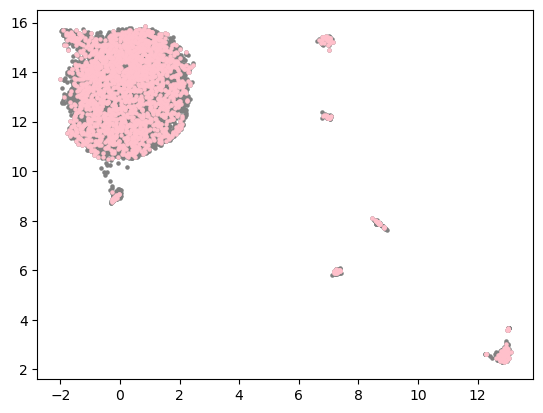

replicate: BPDCN712.4


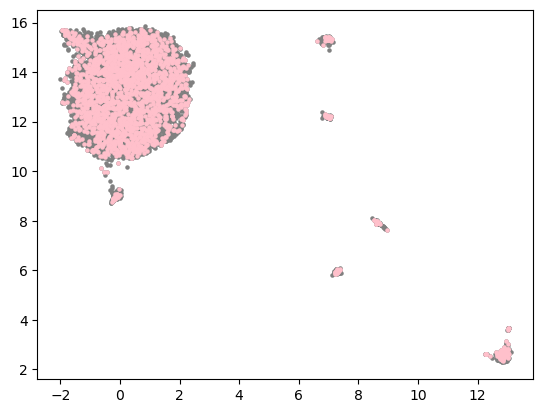

replicate: BPDCN712.1


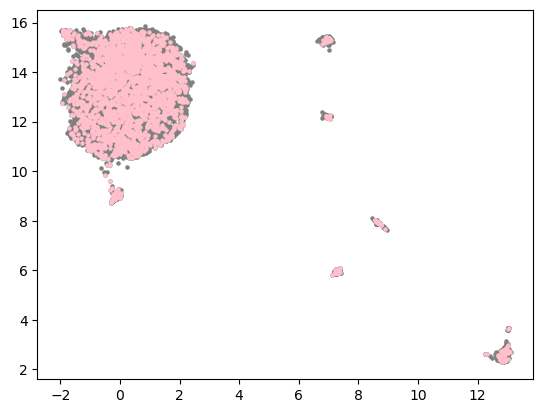

replicate: BPDCN712.3


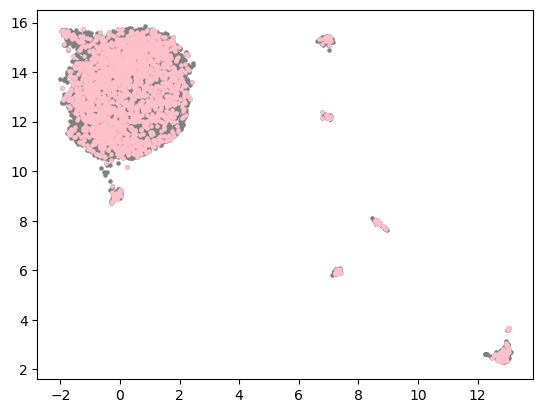

TET2.S792*: no call


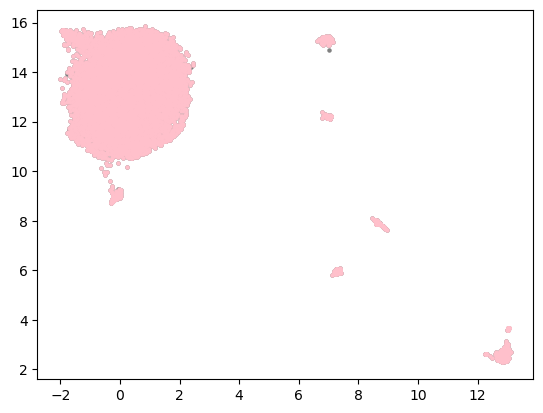

TET2.S792*: wildtype


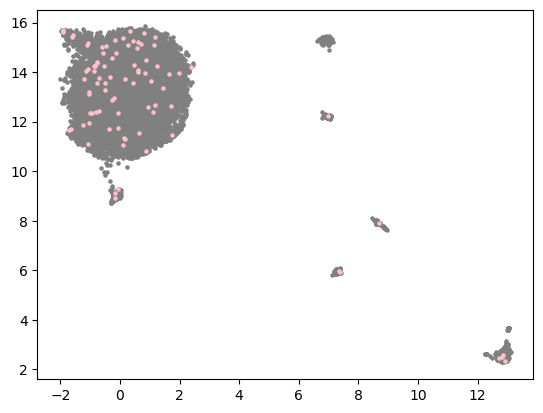

TET2.S792*: mutant


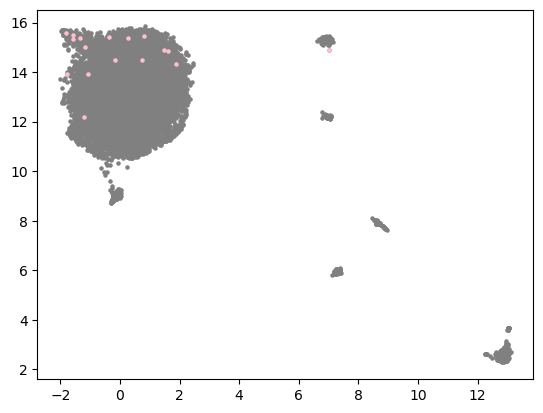

TET2.Q1034*: no call


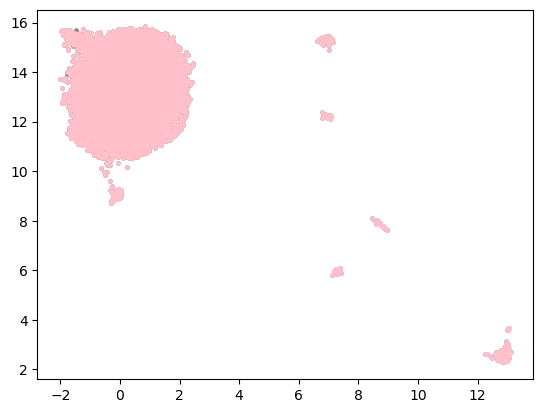

TET2.Q1034*: wildtype


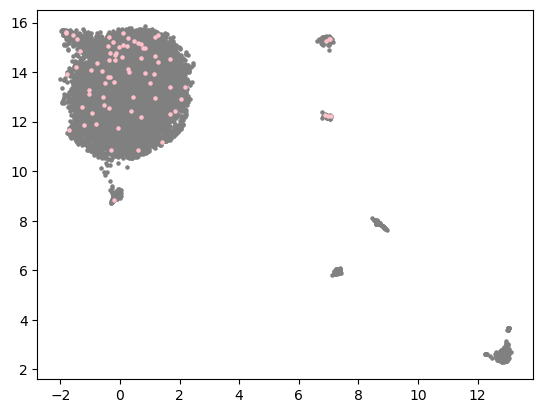

TET2.Q1034*: mutant


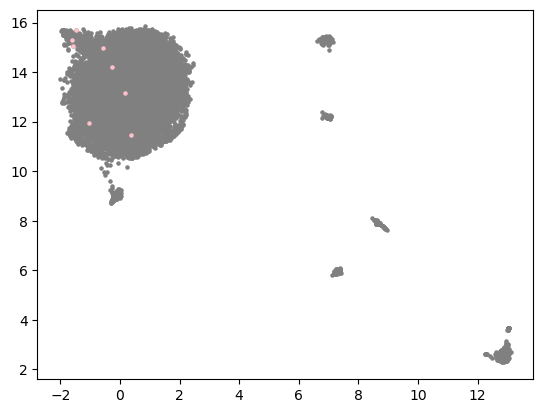

TET2.R1216*: no call


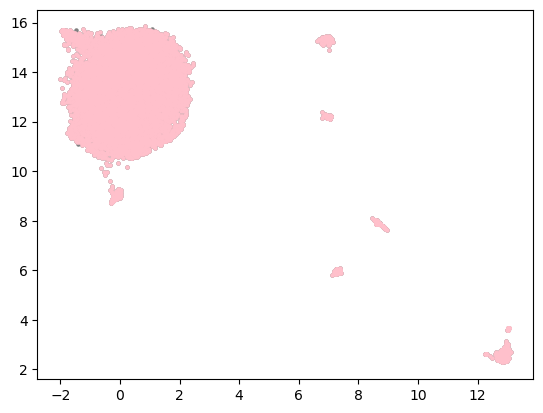

TET2.R1216*: wildtype


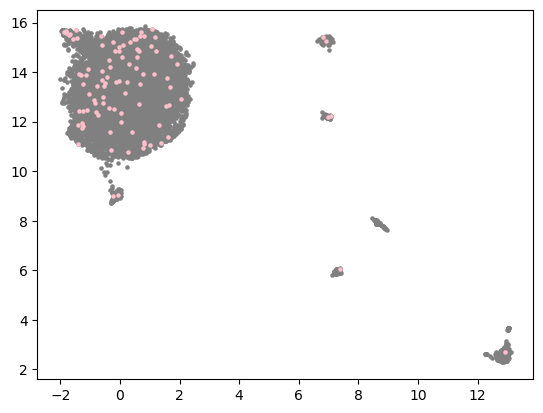

TET2.R1216*: mutant


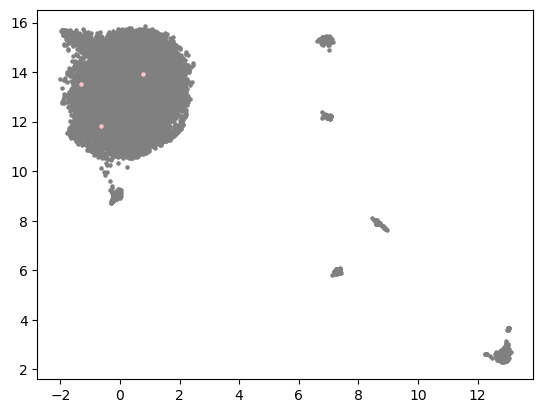

TET2.H1380Y: no call


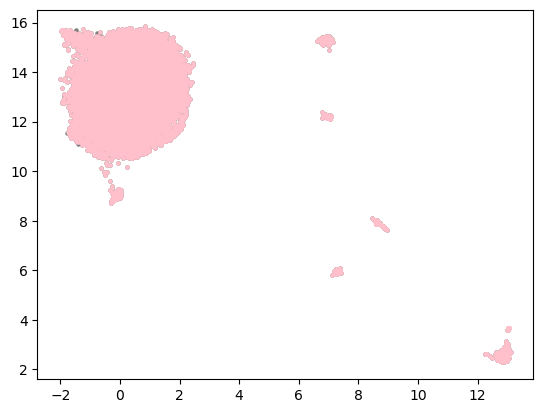

TET2.H1380Y: wildtype


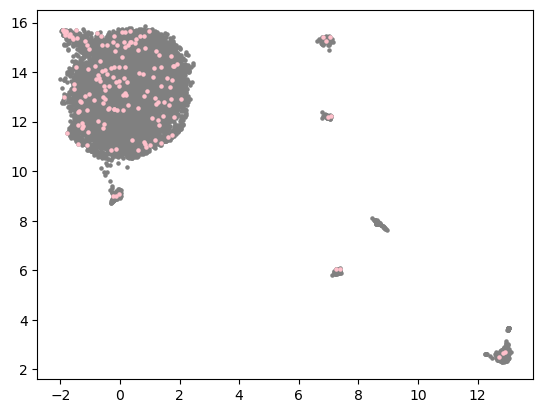

TET2.H1380Y: mutant


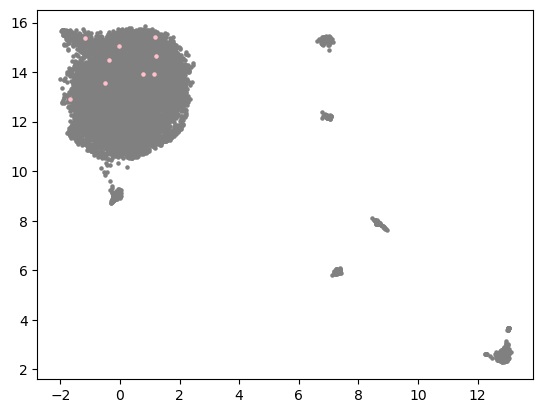

ACAP2.L97M: wildtype


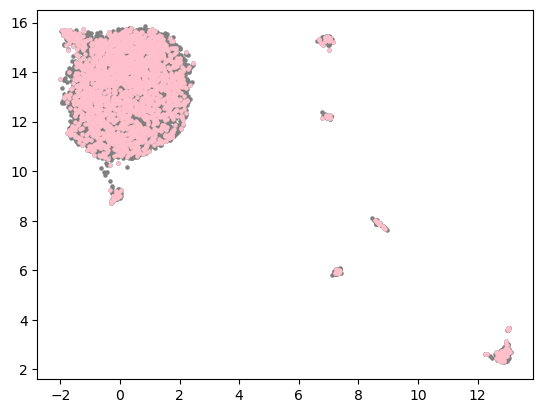

ACAP2.L97M: no call


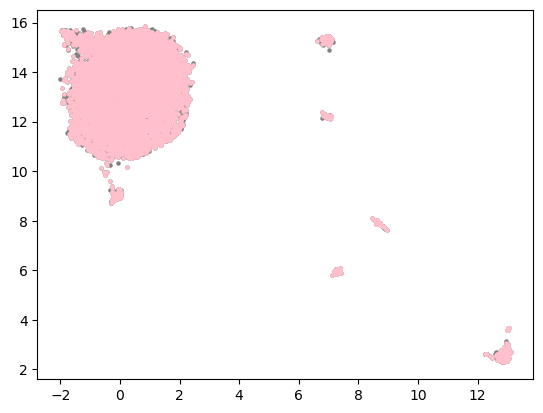

ACAP2.L97M: mutant


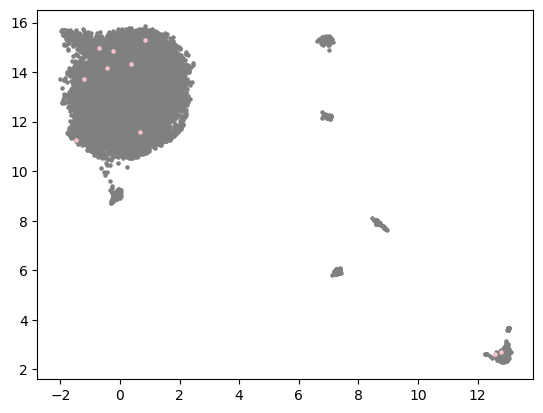

ASXL1.G642fs: no call


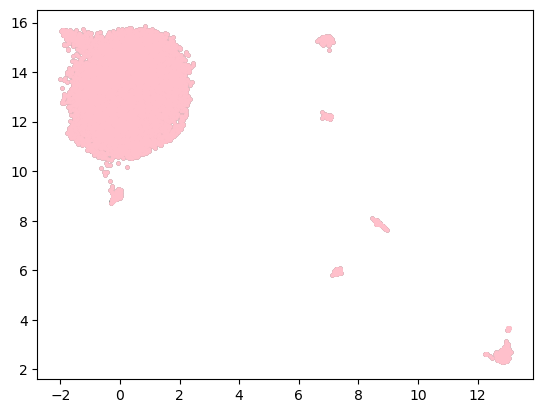

ASXL1.G642fs: wildtype


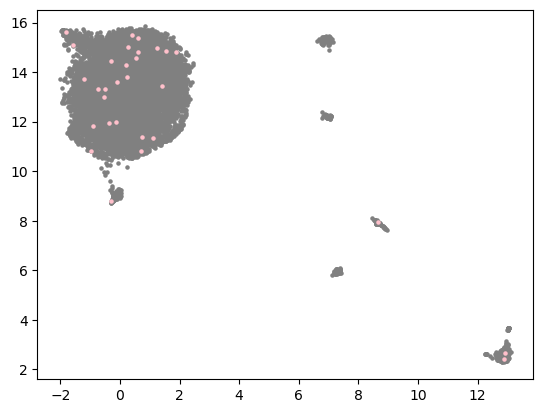

ASXL1.G642fs: mutant


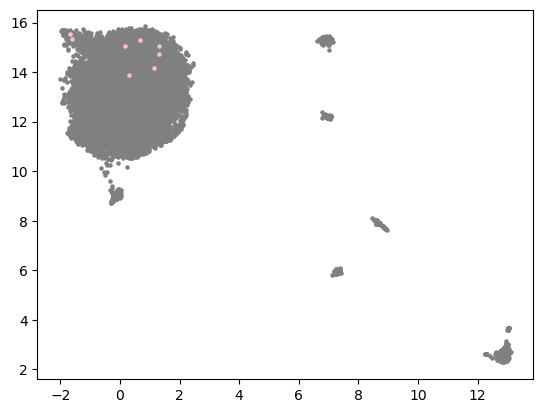

CWF19L2.K221R: no call


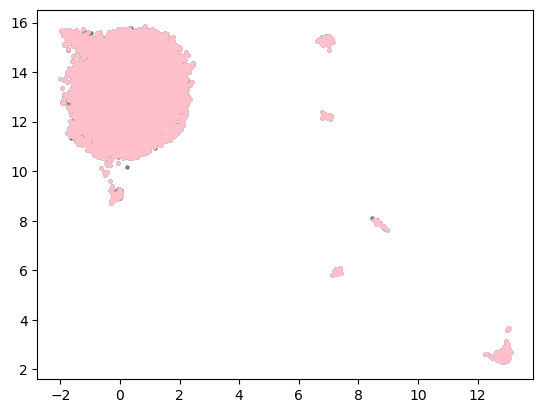

CWF19L2.K221R: wildtype


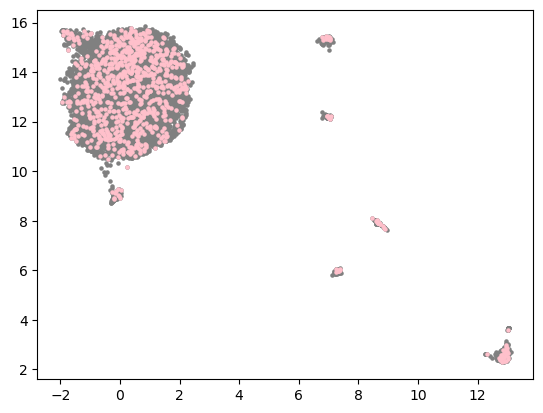

CWF19L2.K221R: mutant


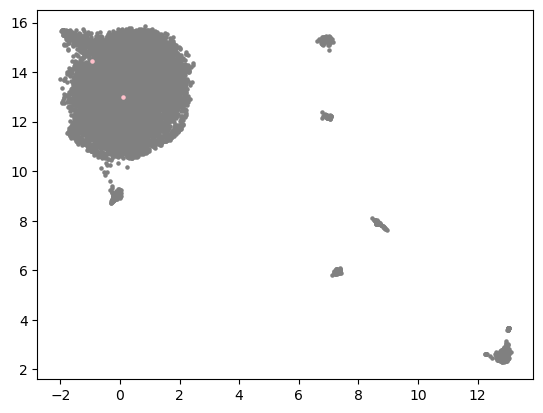

DOLPP1.R227S: no call


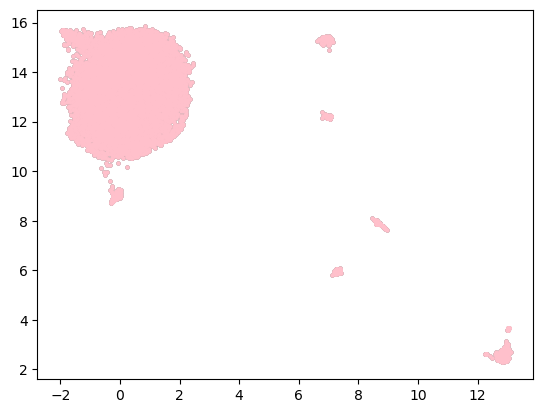

DOLPP1.R227S: wildtype


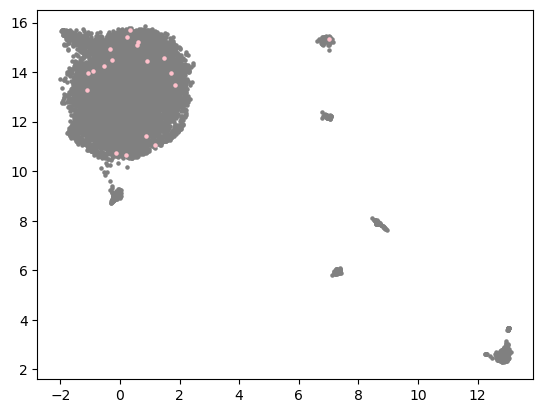

HNRNPUL1.F559F: no call


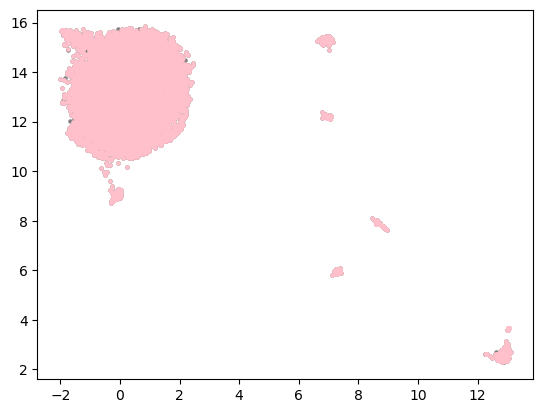

HNRNPUL1.F559F: wildtype


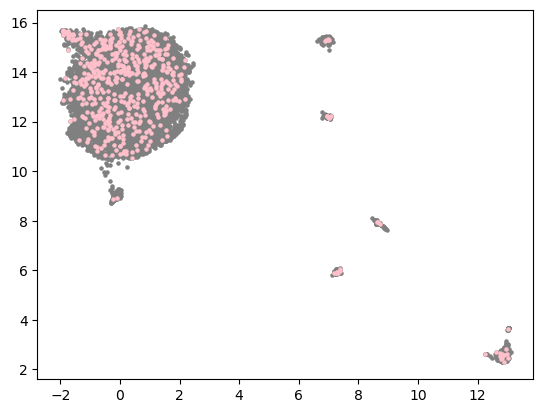

HNRNPUL1.F559F: mutant


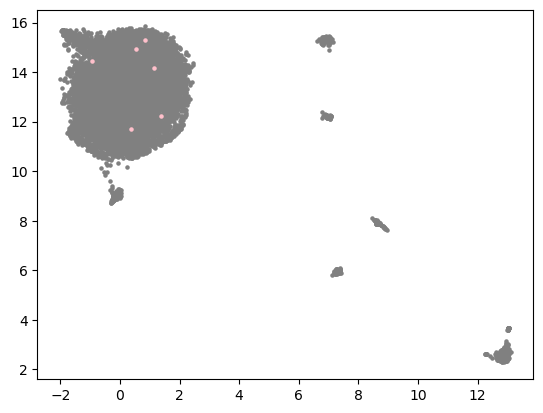

MAP4K5.P667S: no call


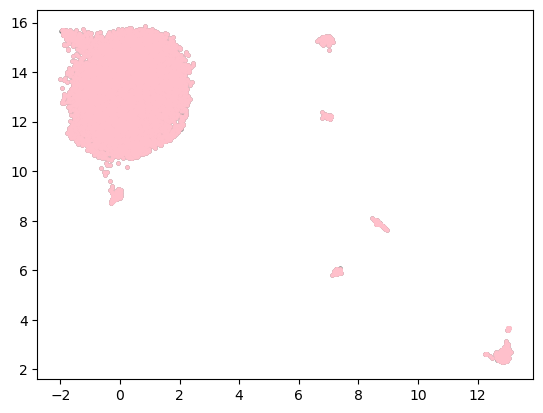

MAP4K5.P667S: wildtype


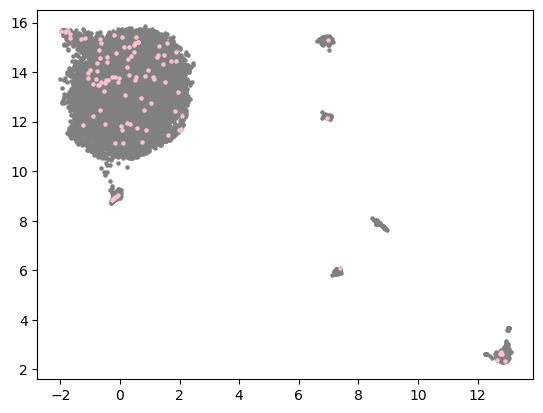

MAP4K5.P667S: mutant


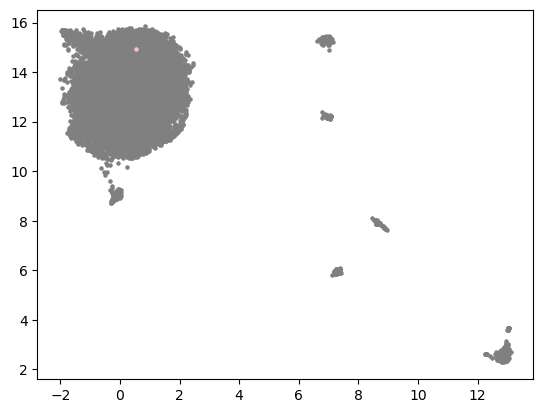

RAB9A.3pUTR: no call


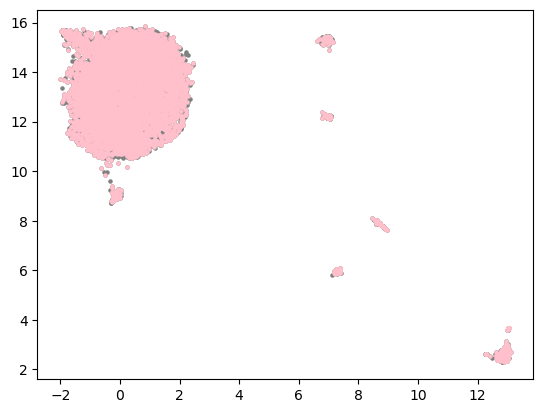

RAB9A.3pUTR: wildtype


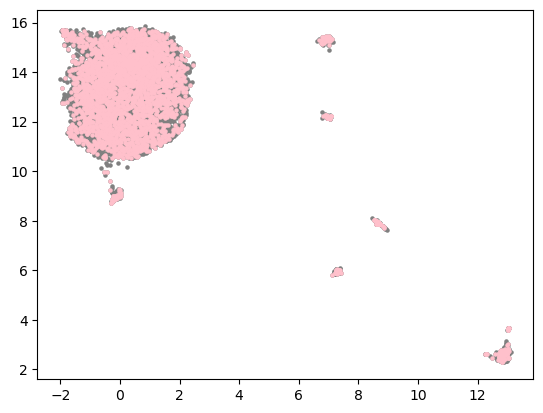

RAB9A.3pUTR: mutant


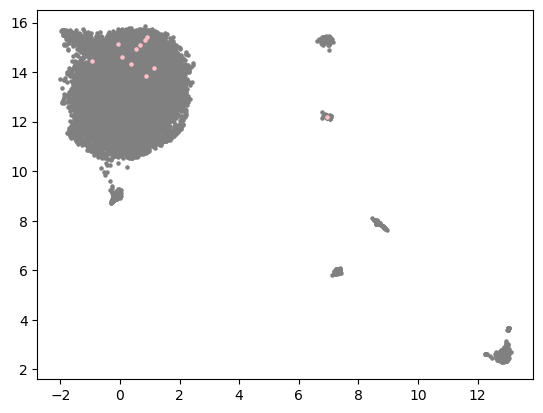

MTAP.rearr: no call


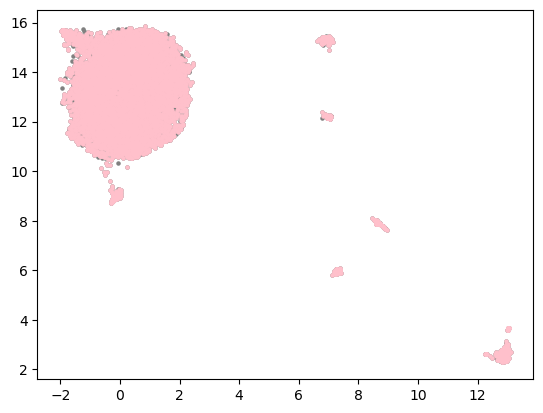

MTAP.rearr: wildtype


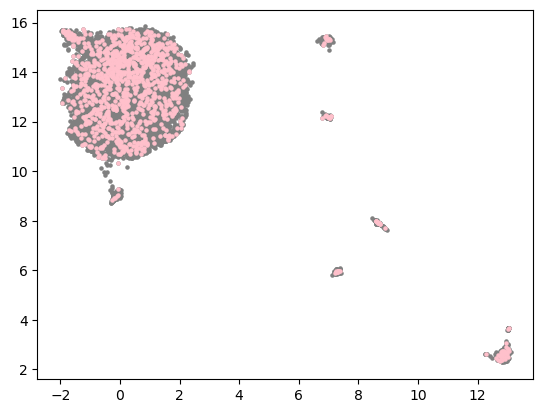

MTAP.rearr: mutant


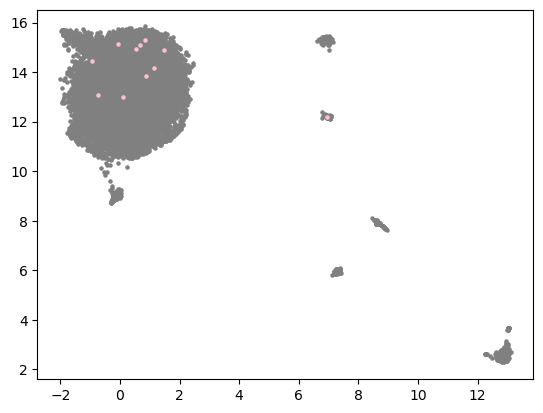

In [61]:
trait = ['replicate', 'TET2.S792*', 'TET2.Q1034*', 'TET2.R1216*',
       'TET2.H1380Y', 'ACAP2.L97M', 'ASXL1.G642fs', 'CWF19L2.K221R',
       'DOLPP1.R227S', 'HNRNPUL1.F559F', 'MAP4K5.P667S', 'RAB9A.3pUTR',
       'MTAP.rearr']

for k in trait:

    counter = collections.Counter(refer[k].to_numpy()[include][test1.cell_filter[include_sample]])

    for w in list(counter.keys()):

        print(k + ": " + w)
        place = np.where(refer[k].to_numpy()[include][test1.cell_filter[include_sample]] == w)[0]
        plt.scatter(emb[:, 0], emb[:, 1], s = 5, c = c1)
        plt.scatter(emb[place, 0], emb[place, 1], s = 5, c = c2)
        plt.xlim(test1.xlim_embedding_2d)
        plt.ylim(test1.ylim_embedding_2d)
        plt.show()

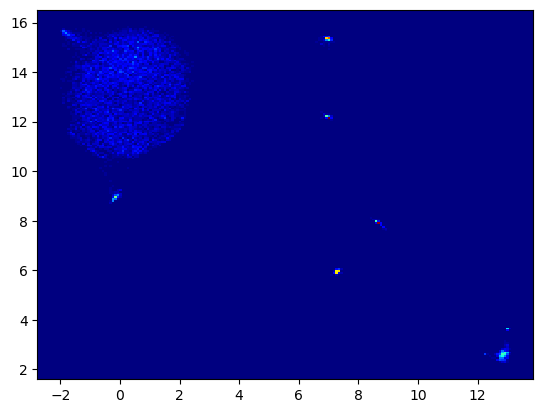

CASSQAGAANTEAFF


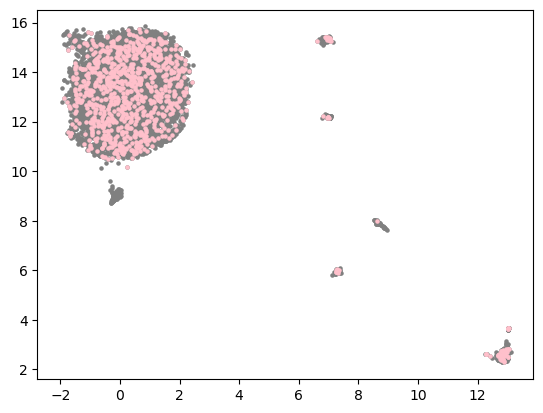

CASSLVEEKLFF


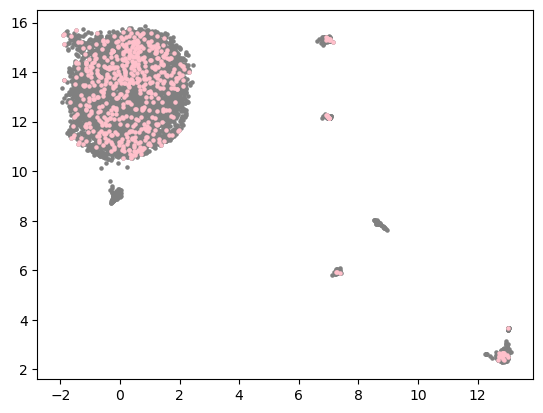

CASSLTGGSYNEQFF


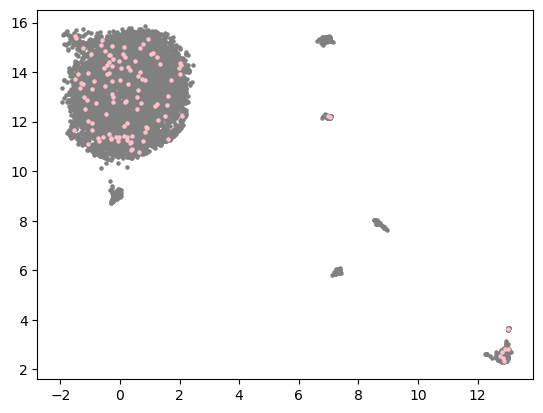

nan


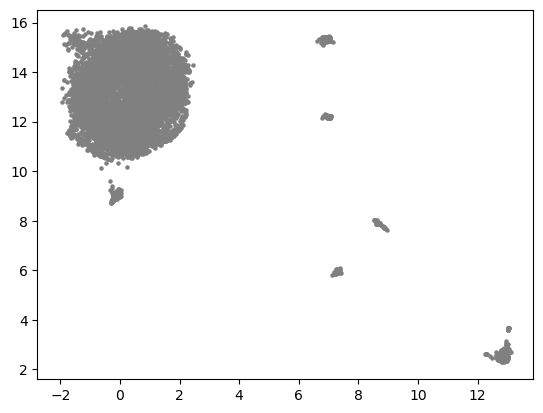

CASSPFEETQYF


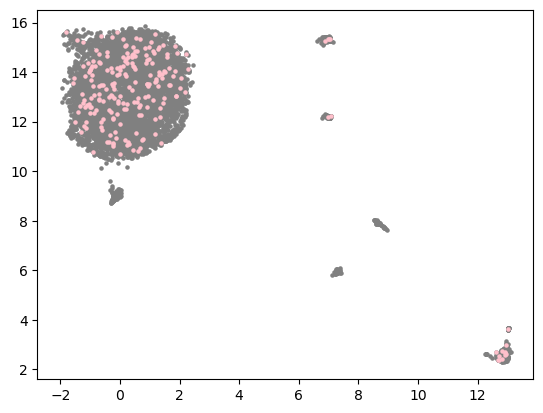

CASAPNFGQELTYEQYF


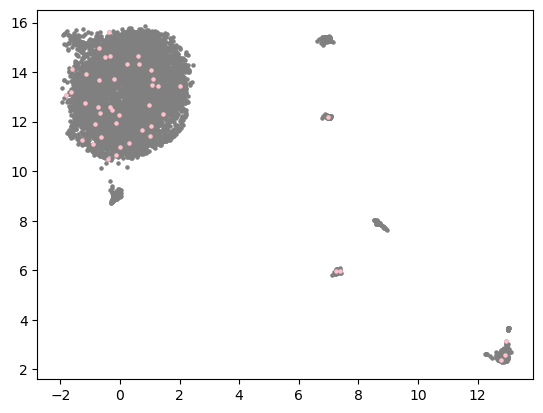

CASSFRQGYNEQFF


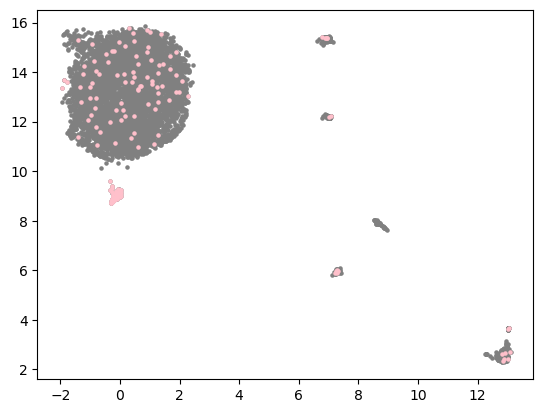

CSVEDLGMDSPSYNEQFF


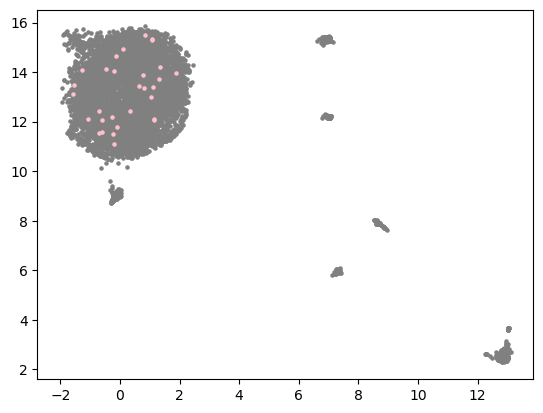

CASSYPLWGGARQPQHF


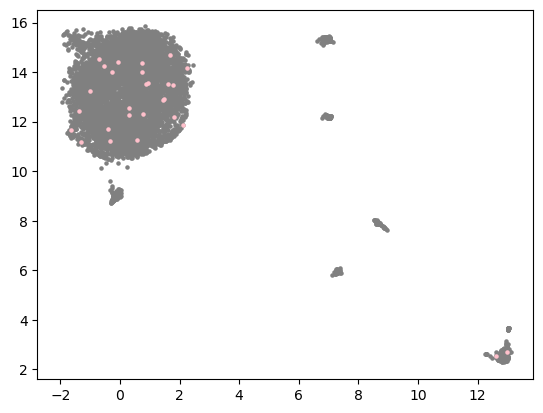

CASSLEWGNPSTYEQYF


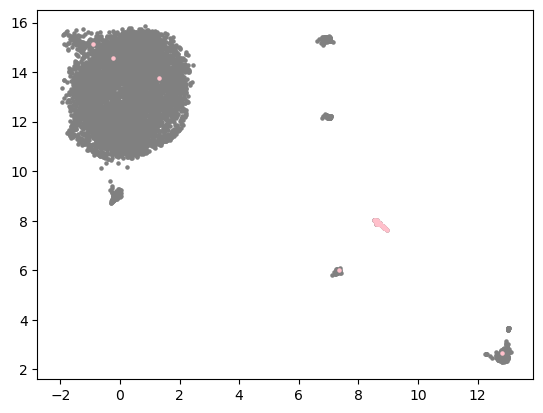

CASSATRAETQYF


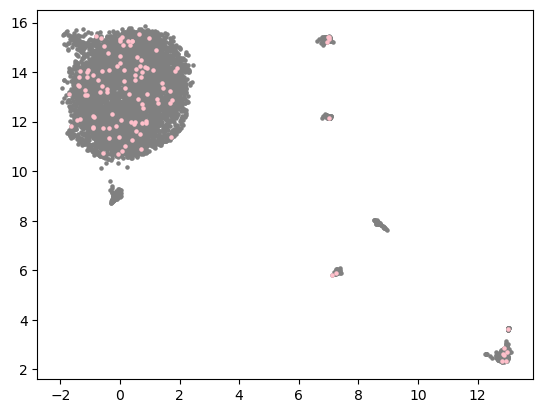

CASSRYRGGTEAFF


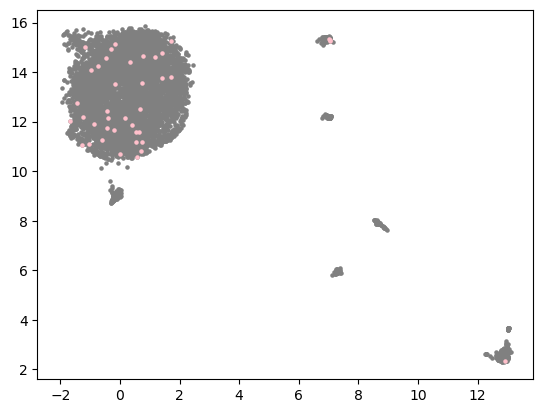

CASSFRLATDTQYF


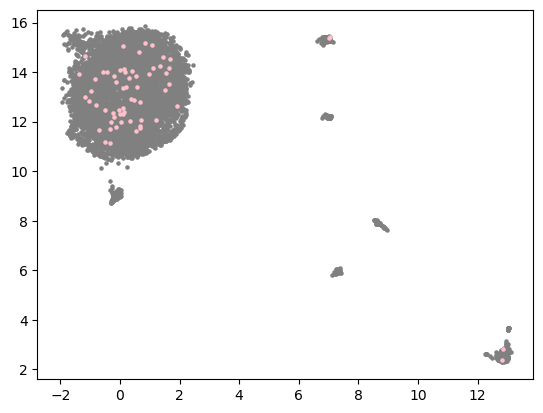

CASSLTSGDPTDTQYF


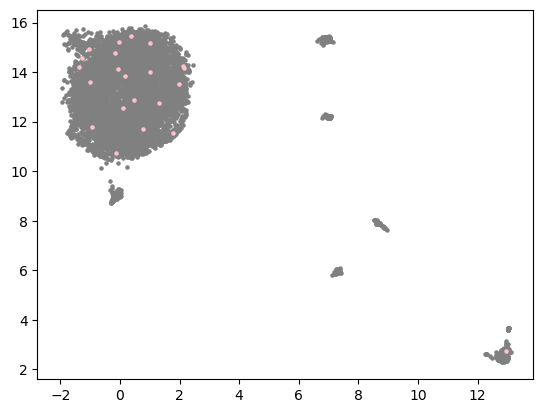

CASSPGFGKLFF


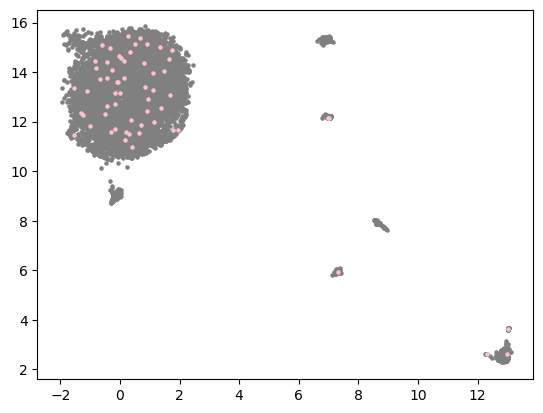

CASIPGPGTSGYNEQFF


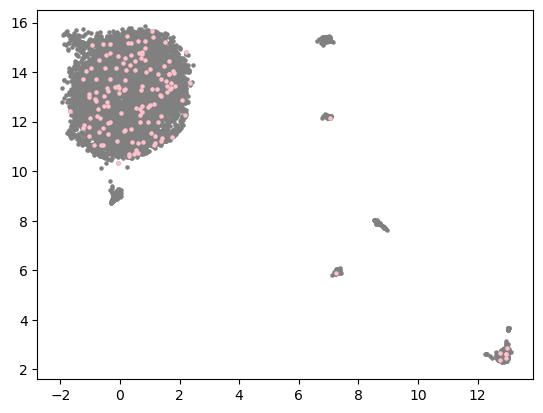

CASSQVGHSADTQYF


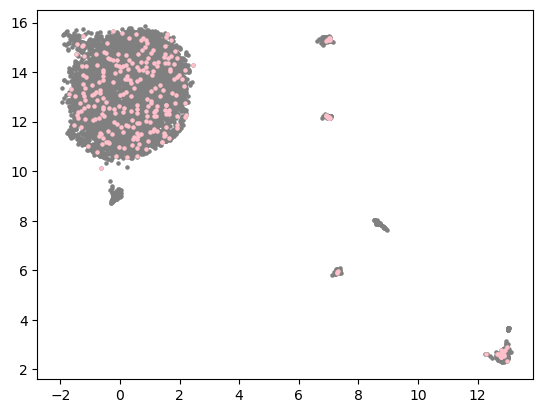

CASSLGGTVSYEQYF


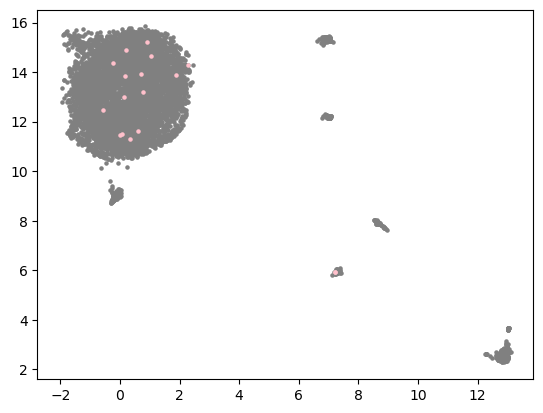

CASSLAWGAYEQYF


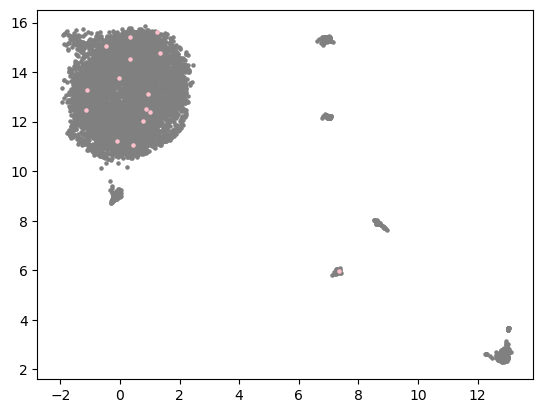

CASSSRDRGGLVPGELFF


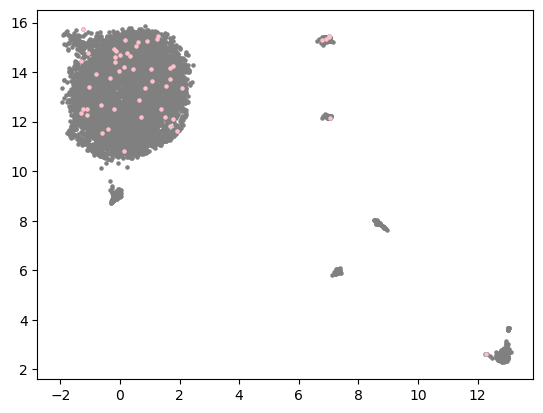

CSARDIHTYNEQFF


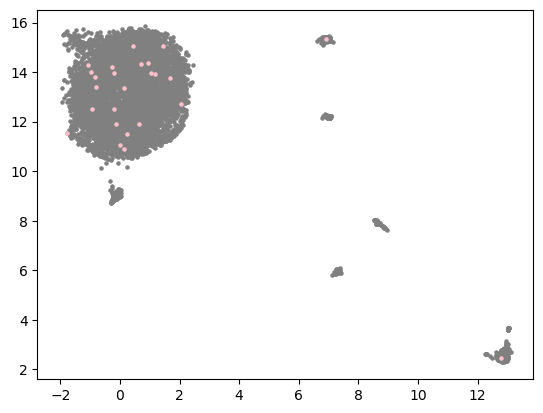

CATSGGWGGETQYF


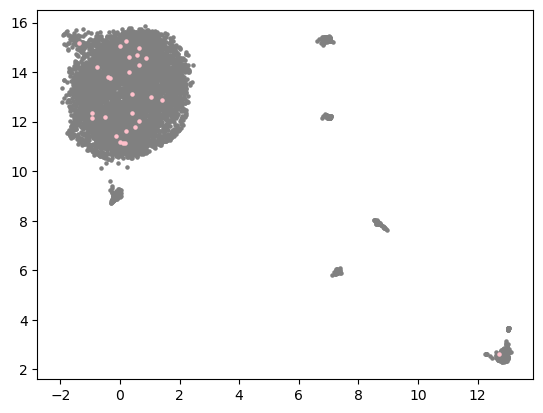

CSANPGQGVDEQYF


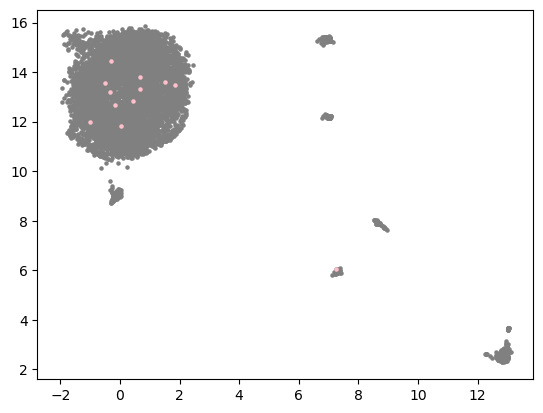

CATPGSLNYGYTF


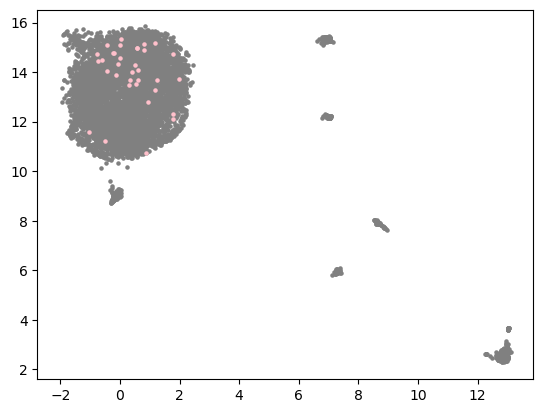

CASSLVSGEVNEKLFF


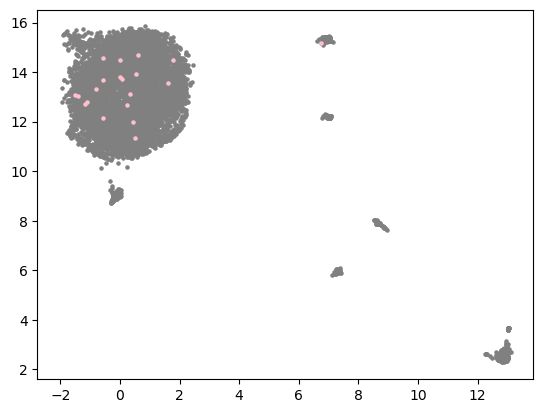

CSVGTGGTNEKLFF


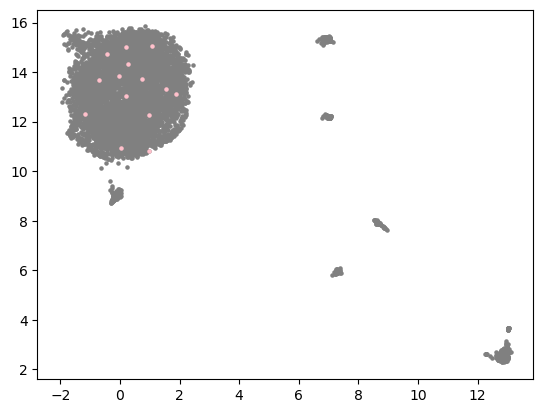

CASGILGTQYF


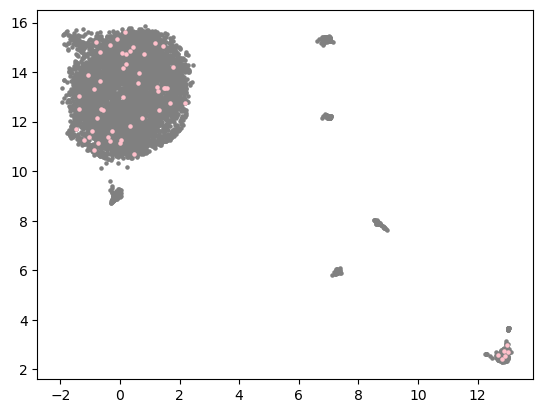

CASSQFPAPGPGEAQHF


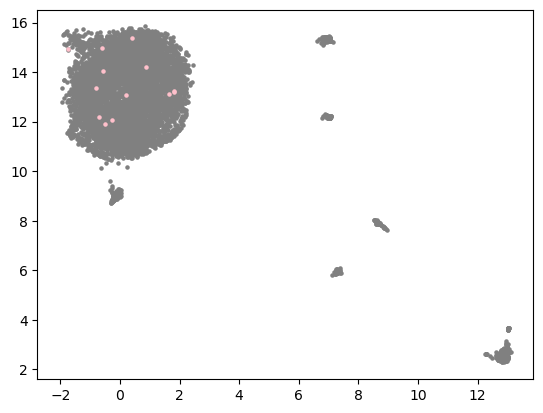

CASSLYWTDTQYF


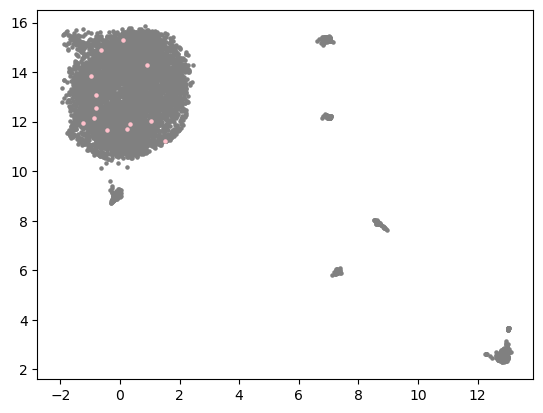

CASRRGSSEQFF


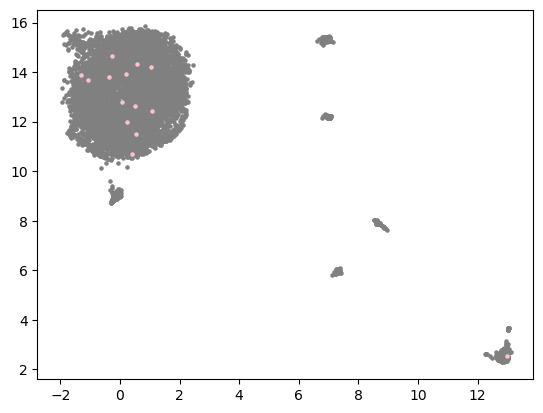

CASSPGGNEQFF


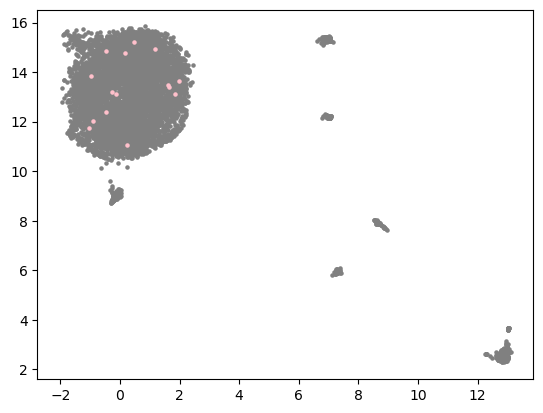

CASSYRLPGPGELFF


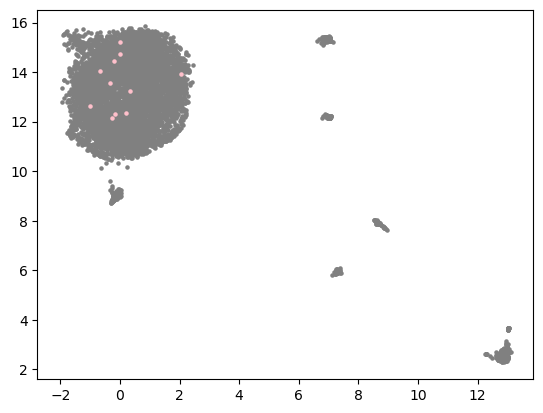

CASSLGWTENTGELFF


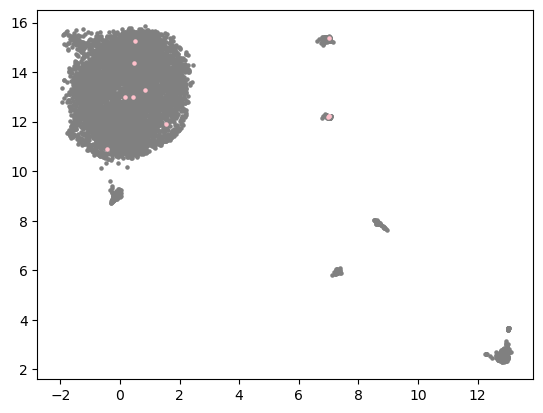

In [62]:
TCR = pd.read_csv("/home/u3570318/mount2/BPDCN712_10x_MAESTER/GSM5534712_BPDCN712_TCR_clonotypes.csv")

include_T = []
include_sample_T = []

for w in range(len(sample["sample"].to_list())):
    
    if sample["sample"].to_list()[w][:-2] in TCR["BC"].to_numpy():
    
        include_T.append(np.where(TCR["BC"].to_numpy() == sample["sample"].to_list()[w][:-2])[0][0])
        include_sample_T.append(True)
        
    elif sample["sample"].to_list()[w][:-2] not in TCR["BC"].to_numpy():
    
        include_sample_T.append(False)
        
emb_T = test1.embedding_2d[np.array(include_sample_T)[test1.cell_filter], :]
plt.hist2d(emb[:, 0], emb[:, 1], range = [test1.xlim_embedding_2d, test1.ylim_embedding_2d], bins = 200, cmap = plt.cm.jet)
plt.show()

counter = collections.Counter(TCR["TRB_CDR3"].to_numpy()[include_T][test1.cell_filter[include_sample_T]])
values = list(counter.values())
keys = list(counter.keys())


for w in list(np.array(list(counter.keys()))[np.array(values) > 10]):
    
    print(w)
    place = np.where(TCR["TRB_CDR3"].to_numpy()[include_T][test1.cell_filter[include_sample_T]] == w)[0]
    plt.scatter(emb_T[:, 0], emb_T[:, 1], s = 5, c = c1)
    plt.scatter(emb_T[place, 0], emb_T[place, 1], s = 5, c = c2)
    plt.xlim(test1.xlim_embedding_2d)
    plt.ylim(test1.ylim_embedding_2d)
    plt.show()

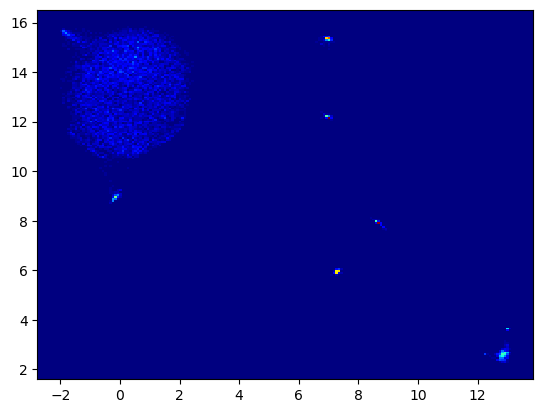

CASSQAGAANTEAFF


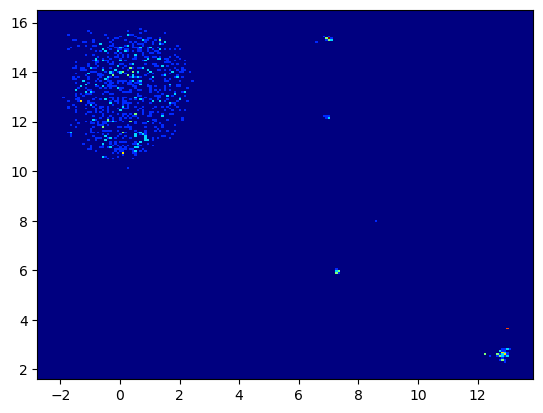

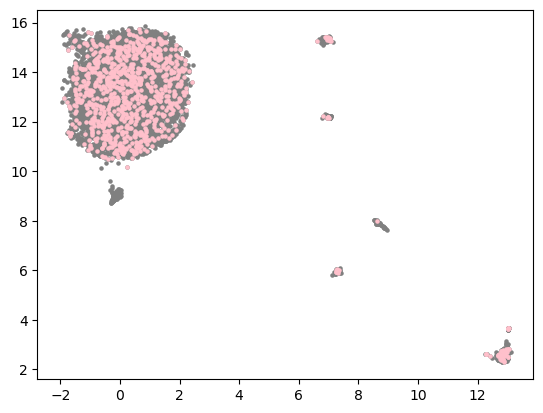

CASSLVEEKLFF


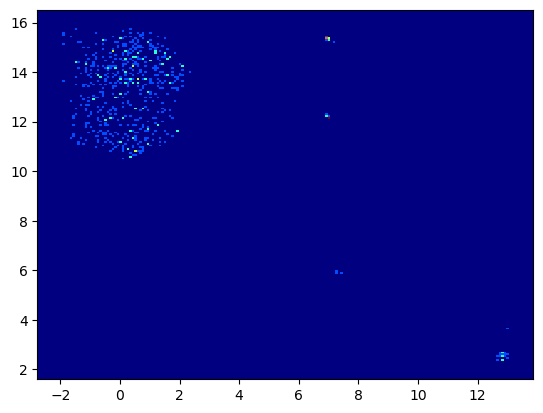

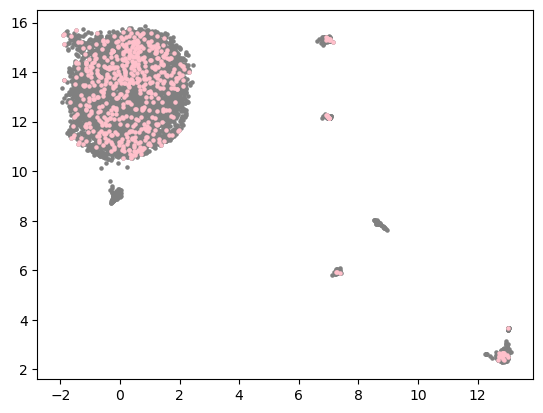

CASSLTGGSYNEQFF


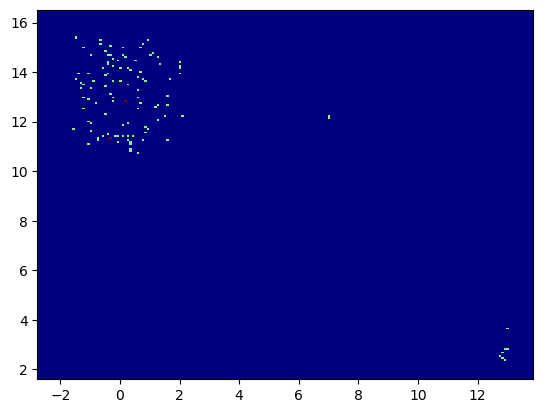

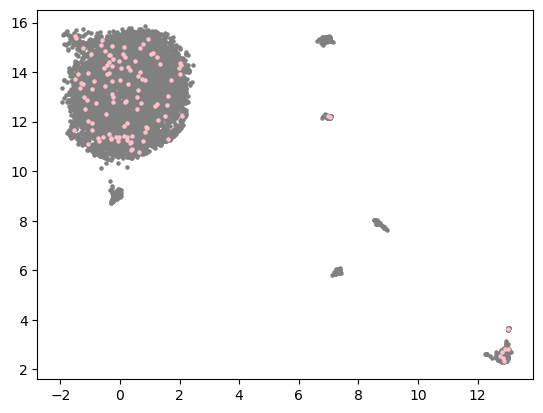

nan


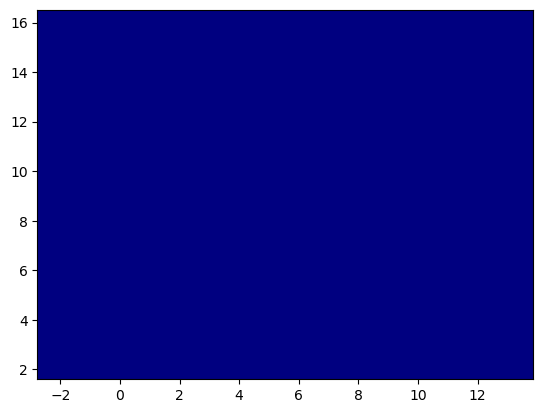

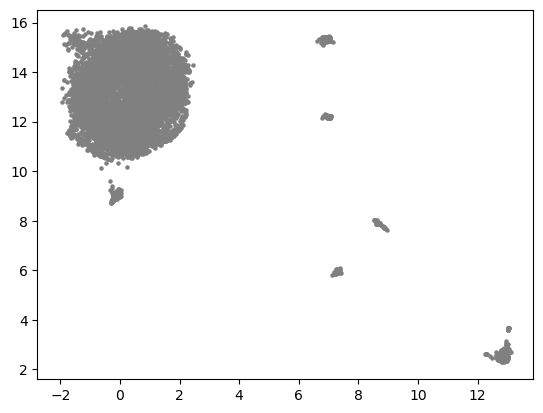

CASSPFEETQYF


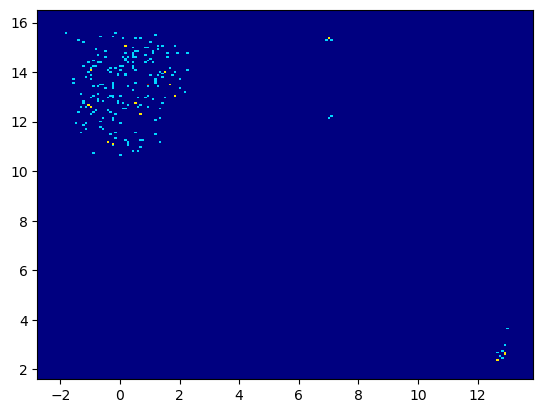

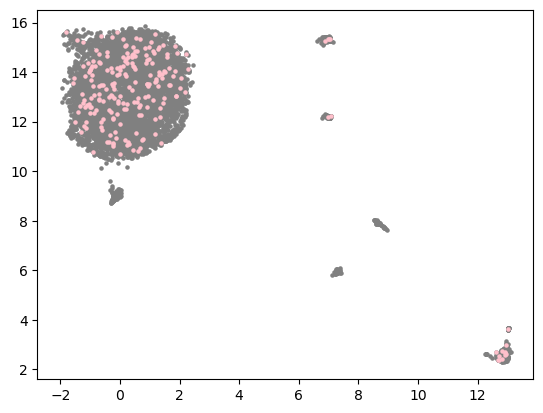

CASSFRQGYNEQFF


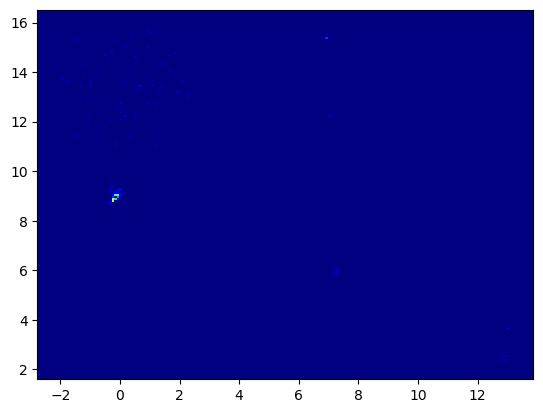

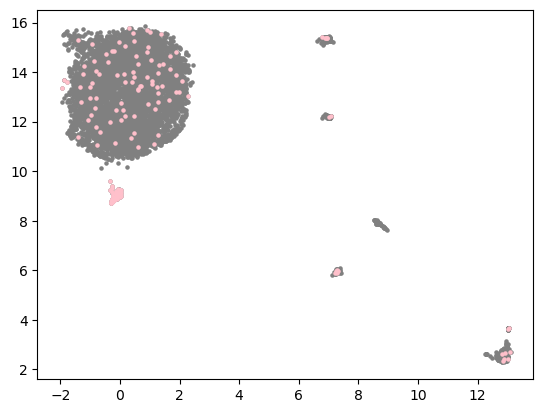

CASSLEWGNPSTYEQYF


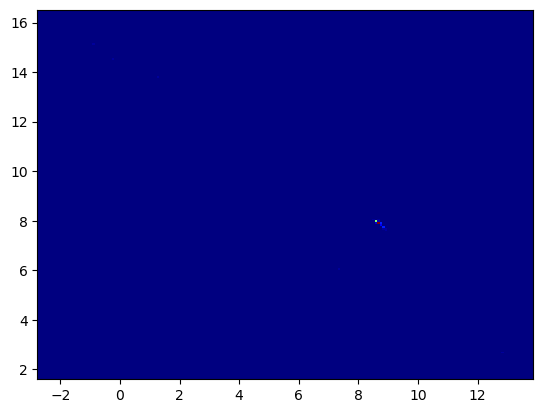

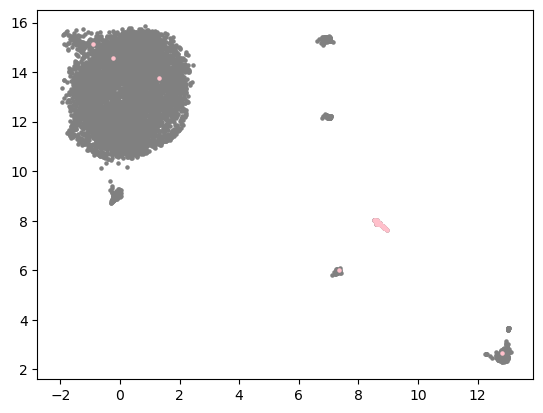

CASSATRAETQYF


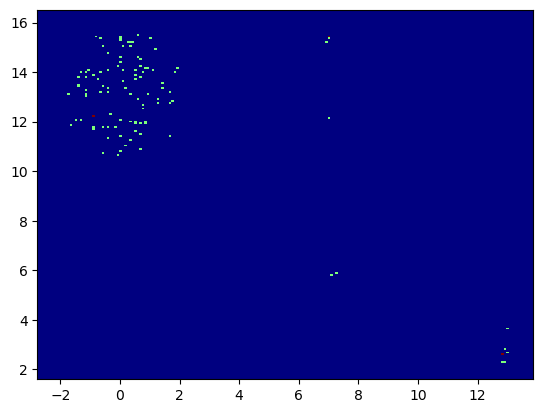

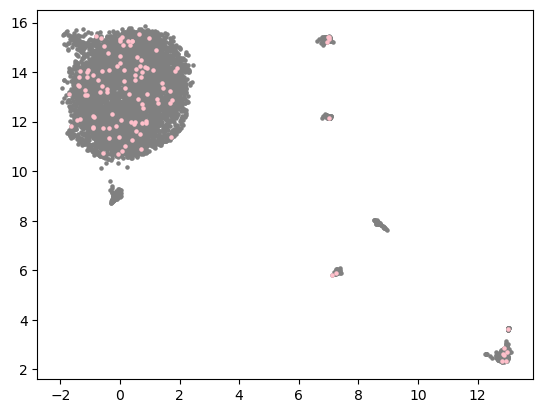

CASIPGPGTSGYNEQFF


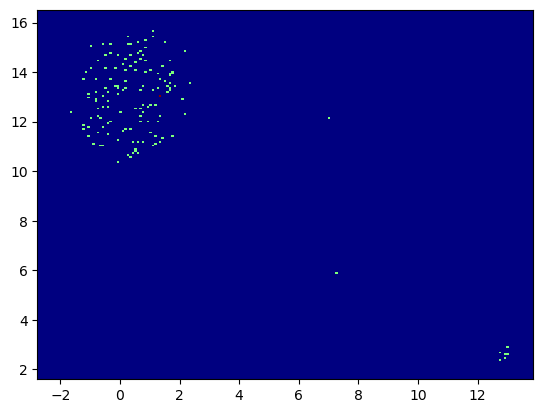

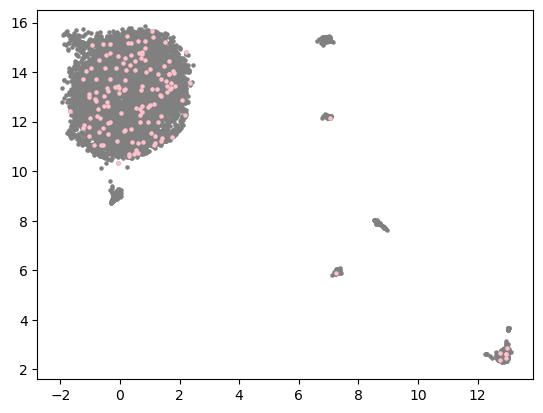

CASSQVGHSADTQYF


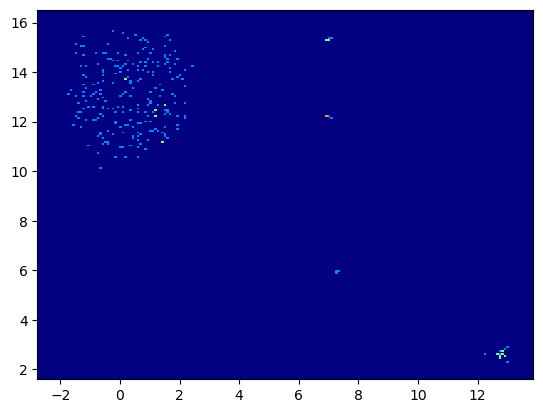

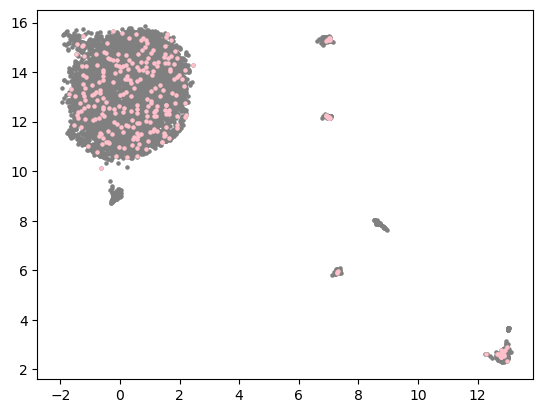

In [63]:
TCR = pd.read_csv("/home/u3570318/mount2/BPDCN712_10x_MAESTER/GSM5534712_BPDCN712_TCR_clonotypes.csv")

include_T = []
include_sample_T = []

for w in range(len(sample["sample"].to_list())):
    
    if sample["sample"].to_list()[w][:-2] in TCR["BC"].to_numpy():
    
        include_T.append(np.where(TCR["BC"].to_numpy() == sample["sample"].to_list()[w][:-2])[0][0])
        include_sample_T.append(True)
        
    elif sample["sample"].to_list()[w][:-2] not in TCR["BC"].to_numpy():
    
        include_sample_T.append(False)
        
emb_T = test1.embedding_2d[np.array(include_sample_T)[test1.cell_filter], :]
plt.hist2d(emb[:, 0], emb[:, 1], range = [test1.xlim_embedding_2d, test1.ylim_embedding_2d], bins = 200, cmap = plt.cm.jet)
plt.show()

counter = collections.Counter(TCR["TRB_CDR3"].to_numpy()[include_T][test1.cell_filter[include_sample_T]])
values = list(counter.values())
keys = list(counter.keys())


for w in list(np.array(list(counter.keys()))[np.array(values) >= 90]):
    
    print(w)
    place = np.where(TCR["TRB_CDR3"].to_numpy()[include_T][test1.cell_filter[include_sample_T]] == w)[0]
    plt.hist2d(emb_T[place, 0], emb_T[place, 1], range = [test1.xlim_embedding_2d, test1.ylim_embedding_2d], bins = 200, cmap = plt.cm.jet)
    plt.show()
    plt.scatter(emb_T[:, 0], emb_T[:, 1], s = 5, c = c1)
    plt.scatter(emb_T[place, 0], emb_T[place, 1], s = 5, c = c2)
    plt.xlim(test1.xlim_embedding_2d)
    plt.ylim(test1.ylim_embedding_2d)
    plt.show()

In [64]:
np.flip(np.sort(values))[:20]

array([1302,  946,  582,  263,  224,  217,  139,  113,  108,   90,   62,
         60,   54,   52,   44,   40,   34,   30,   28,   27])

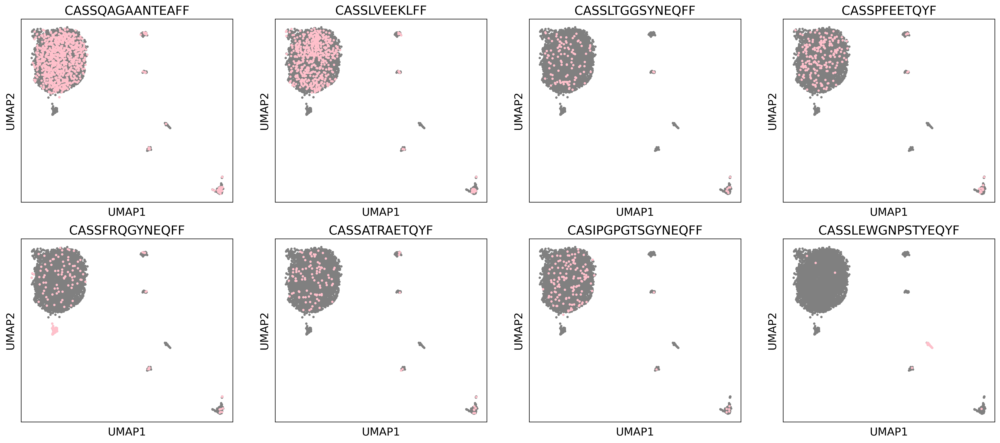

In [67]:
fig, axs = plt.subplots(2, 4, dpi = 300)
fig.set_size_inches(24, 10)

list_bar = ['CASSQAGAANTEAFF',
 'CASSLVEEKLFF',
 'CASSLTGGSYNEQFF',
 'CASSPFEETQYF',
 'CASSFRQGYNEQFF',
 'CASSATRAETQYF',
 'CASIPGPGTSGYNEQFF',
 'CASSLEWGNPSTYEQYF']

for g in range(4):
    
    w = list_bar[g]
    place = np.where(TCR["TRB_CDR3"].to_numpy()[include_T][test1.cell_filter[include_sample_T]] == w)[0]
    axs[0, g].scatter(emb_T[:, 0], emb_T[:, 1], s = 5, c = c1)
    axs[0, g].scatter(emb_T[place, 0], emb_T[place, 1], s = 5, c = c2)
    axs[0, g].set_xlim(test1.xlim_embedding_2d)
    axs[0, g].set_ylim(test1.ylim_embedding_2d)
    axs[0, g].set_title(w, fontsize = 17)
    axs[0, g].set_xticks([])
    axs[0, g].set_yticks([])
    axs[0, g].set_xlabel("UMAP1", fontsize = 15)
    axs[0, g].set_ylabel("UMAP2", fontsize = 15)
    
    w = list_bar[4 + g]
    place = np.where(TCR["TRB_CDR3"].to_numpy()[include_T][test1.cell_filter[include_sample_T]] == w)[0]
    axs[1, g].scatter(emb_T[:, 0], emb_T[:, 1], s = 5, c = c1)
    axs[1, g].scatter(emb_T[place, 0], emb_T[place, 1], s = 5, c = c2)
    axs[1, g].set_xlim(test1.xlim_embedding_2d)
    axs[1, g].set_ylim(test1.ylim_embedding_2d)
    axs[1, g].set_title(w, fontsize = 17)
    axs[1, g].set_xticks([])
    axs[1, g].set_yticks([])
    axs[1, g].set_xlabel("UMAP1", fontsize = 15)
    axs[1, g].set_ylabel("UMAP2", fontsize = 15)
    
plt.show()

In [66]:
list(np.array(list(counter.keys()))[np.array(values) >= 90])

['CASSQAGAANTEAFF',
 'CASSLVEEKLFF',
 'CASSLTGGSYNEQFF',
 'nan',
 'CASSPFEETQYF',
 'CASSFRQGYNEQFF',
 'CASSLEWGNPSTYEQYF',
 'CASSATRAETQYF',
 'CASIPGPGTSGYNEQFF',
 'CASSQVGHSADTQYF']

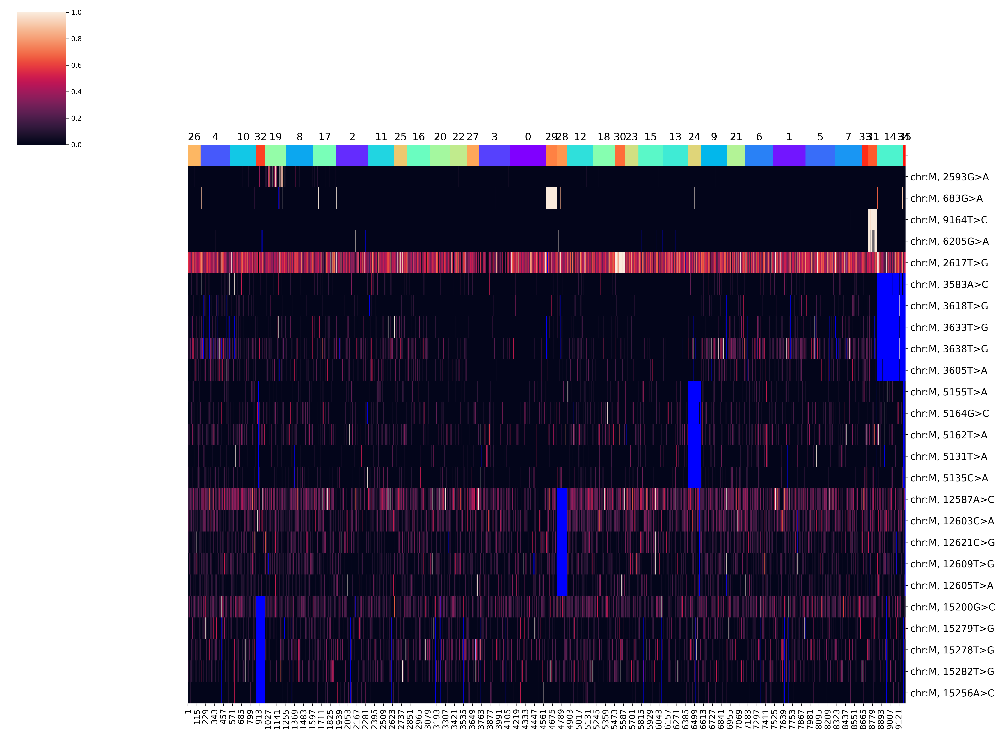

In [72]:
dpi = 300
SNP_no = 100
fontsize_y = 14
fontsize_x = 12
fontsize_c = 15

order_SNP = [4, 1, 0, 3, 2, 21, 29, 68, 73, 74, 49, 52, 53, 54, 55, 5, 6, 9, 10, 15, 7, 8, 11, 12, 14]
    
clus_colors = pd.Series(test1.assigned_label[test1.cell_sorted]).map(dict(zip(np.arange(0, test1.cluster_no), test1.colors)))
clus_colors.index = pd.RangeIndex(start = 1, stop = test1.cell_total + 1, step = 1)

cmap = mpl.colormaps['rocket'] 
cmap.set_bad("blue")

if test1.is_VCF == True:

    fig = sns.clustermap(pd.DataFrame(test1.AF_sorted[:SNP_no, :][order_SNP, :], index = test1.VCF_filtered["TEXT"].to_numpy()[test1.rank_SNP][:SNP_no][order_SNP], columns = np.arange(1, test1.cell_total + 1)), row_cluster = False, col_cluster = False, col_colors = clus_colors, figsize = (20, 25 * 0.6), cmap = cmap, vmin = 0, vmax = 1)

elif test1.is_VCF == False:

    fig = sns.clustermap(pd.DataFrame(test1.AF_sorted[:SNP_no, :][order_SNP, :], index = test1.VCF_filtered[0].to_numpy()[test1.rank_SNP][:SNP_no][order_SNP], columns = np.arange(1, test1.cell_total + 1)), row_cluster = False, col_cluster = False, col_colors = clus_colors, figsize = (20, 25 * 0.6), cmap = cmap, vmin = 0, vmax = 1)

fig.ax_col_colors.set_xticks(moving_average(np.cumsum([0] + list(test1.cluster_size[test1.cluster_order])), 2))

if fontsize_c == None:

    fig.ax_col_colors.set_xticklabels(np.array(test1.cluster_order))

elif fontsize_c != None:

    fig.ax_col_colors.set_xticklabels(np.array(test1.cluster_order), fontsize = fontsize_c)

fig.ax_col_colors.xaxis.set_tick_params(size = 0)
fig.ax_col_colors.xaxis.tick_top()

if fontsize_x != None:

    fig.ax_heatmap.set_xticklabels(fig.ax_heatmap.get_xmajorticklabels(), fontsize = fontsize_x)

if fontsize_y != None:

    fig.ax_heatmap.set_yticklabels(fig.ax_heatmap.get_ymajorticklabels(), fontsize = fontsize_y)

plt.gcf().set_dpi(dpi)
plt.show()

In [11]:
np.savetxt("assigned_label.csv", test1.assigned_label, delimiter=",")
np.savetxt("embedding_2d.csv", test1.embedding_2d, delimiter=",")
np.savetxt("cell_filter.csv", test1.cell_filter, delimiter=",")
np.savetxt("SNP_filter.csv", test1.SNP_filter, delimiter=",")
np.savetxt("latent.csv", test1.latent, delimiter=",")

In [1]:
import numpy as np
import pandas as pd
import matplotlib.cm as cm 
import matplotlib.pyplot as plt

embedding_2d = np.genfromtxt("embedding_2d.csv", delimiter=",")
cell_filter = np.array(np.genfromtxt("cell_filter.csv", delimiter=","), dtype=bool)

refer = pd.read_csv("/home/u3570318/mount2/figures_final2/data/BPDCN/GSM5534705_BPDCN712_10x_scRNAseq_MetaData.txt", delimiter = '\t')
sample = pd.read_csv("/home/u3570318/mount2/figures_final2/data/BPDCN/sample.csv")

include = []
include_sample = []

for w in range(len(sample["sample"].to_list())):
    
    if sample["sample"].to_list()[w] in refer.index.to_numpy():
    
        include.append(np.where(refer.index.to_numpy() == sample["sample"].to_list()[w])[0][0])
        include_sample.append(True)
        
    elif sample["sample"].to_list()[w] not in refer.index.to_numpy():
    
        include_sample.append(False)

emb = embedding_2d[np.array(include_sample)[cell_filter], :]
        
import collections
counter = collections.Counter(refer["CellType"].to_numpy()[include][cell_filter[include_sample]])
counter.keys()

assigned_label = np.genfromtxt("assigned_label.csv", delimiter=",")

clusters = []
    
for g in range(36):

    clusters.append(np.where(assigned_label == g)[0])
    
import networkx as nx

In [2]:
cluster_size = []

for w in range(36):

    cluster_size.append(clusters[w].shape[0])

cluster_size = np.array(cluster_size)

edge_length_normalized = np.array([1.64, 1.65, 1.65, 1.67, 1.68, 1.68, 1.68, 1.68, 1.66, 1.68, 1.69, 1.69, 1.7, 1.7, 1.72, 1.74, 1.71, 1.74, 1.99, 2.1, 2.11, 2.11, 2.4, 1.71, 1.64, 1.65, 1.68, 1.68, 1.71, 1.65, 1.76, 2.13, 1.67, 2.15, 2.36])

edge_length = np.sqrt(137) * edge_length_normalized

edge_weight = 1 / (edge_length ** 2)

connect_order = [19, 8, 25, 17, 11, 20, 22, 27, 4, 33, 6, 16, 21, 2, 9, 7, 3, 0, 5, 29, 14, 28, 31, 34, 12, 23, 18, 15, 13, 1, 26, 30, 24, 10, 32, 35]

edge = [[19, 8], [19, 25], [19, 17], [19, 11], [19, 20], [19, 22], [19, 27], [19, 4], [4, 33], [4, 6], [19, 16], [4, 21], [17, 2], [4, 9], [4, 7], [19, 3], [3, 0], [4, 5], [19, 29], [4, 14], [19, 28], [4, 31], [14, 34], [4, 12], [12, 23], [12, 18], [12, 15], [12, 13], [4, 1], [4, 26], [18, 30], [12, 24], [4, 10], [10, 32], [14, 35]]

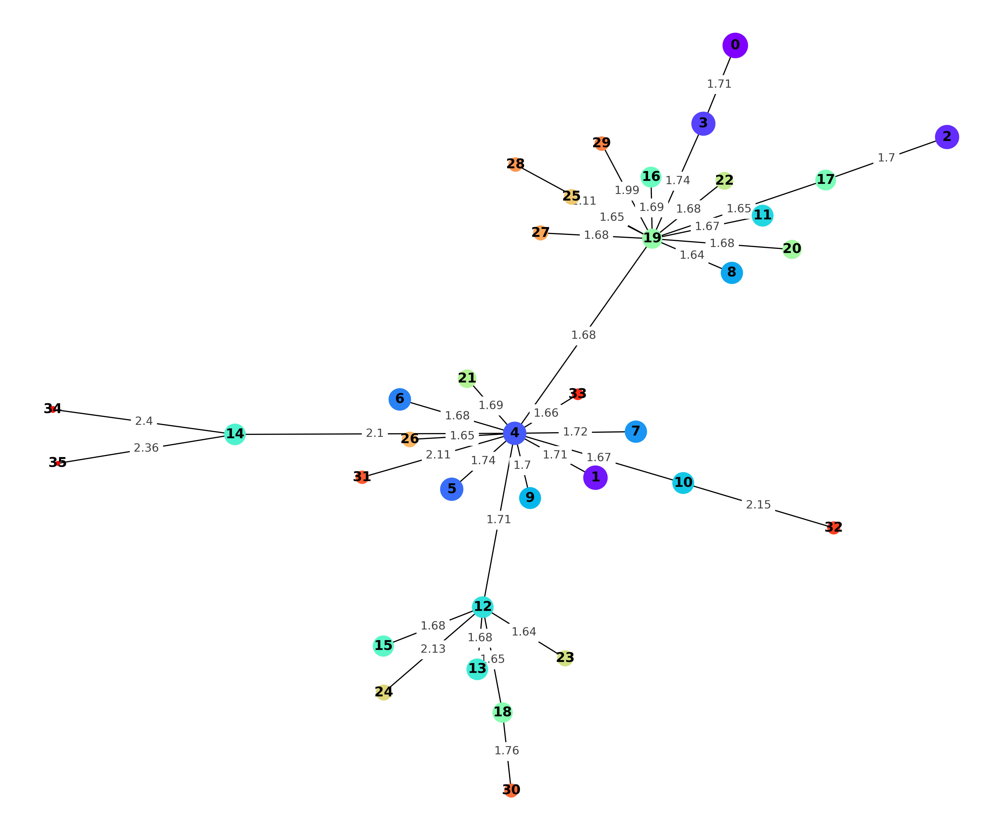

In [8]:
colors = cm.rainbow(np.linspace(0, 1, 36))

graph = nx.Graph()

for u in range(len(edge)):

    graph.add_edge(edge[u][0], edge[u][1], weight = edge_weight[u], length = edge_length_normalized[u])

pos = nx.spring_layout(graph, iterations = 3000, weight = 'weight')

plt.figure(figsize = (12, 10), dpi = 300) 
nx.draw(graph, pos, with_labels = True, font_weight = 'bold', node_size = cluster_size[connect_order], node_color = colors[connect_order])
nx.draw_networkx_edge_labels(graph, pos, nx.get_edge_attributes(graph, 'length'), rotate = False, alpha = 0.75)

plt.show()

In [17]:
color_AF = cm.Reds(np.linspace(0, 1, 101))

fig, axs = plt.subplots(2, 4, dpi = 300)
fig.set_size_inches(48, 20)
ax = axs.flatten()

k = 0
celltype = np.zeros(9126)
celltype[refer["CellType"].to_numpy()[include][cell_filter[include_sample]] == 'T'] = 1
celltype = celltype.astype(bool)

freq = np.zeros(36)

for w in range(36):
    
    freq[w] = np.sum(assigned_label[np.array(include_sample)[cell_filter]][celltype] == w)
    
freq = freq ** 2 / np.sum(freq) / cluster_size

graph = nx.Graph()

for u in range(len(edge)):

    graph.add_edge(edge[u][0], edge[u][1], weight = edge_weight[u], length = edge_length_normalized[u])

nx.draw(graph, pos, with_labels = True, font_weight = 'bold', node_size = cluster_size[connect_order], node_color = color_AF[np.round(freq[connect_order] * [100 / np.max(freq[connect_order])]).astype(int), :], ax = ax[k])
ax[k].set_title('Helper T cells', fontsize = 45)

k = 1
celltype = np.zeros(9126)
celltype[refer["CellType"].to_numpy()[include][cell_filter[include_sample]] == 'CTL'] = 1
celltype = celltype.astype(bool)

freq = np.zeros(36)

for w in range(36):
    
    freq[w] = np.sum(assigned_label[np.array(include_sample)[cell_filter]][celltype] == w)
    
freq = freq ** 2 / np.sum(freq) / cluster_size

graph = nx.Graph()

for u in range(len(edge)):

    graph.add_edge(edge[u][0], edge[u][1], weight = edge_weight[u], length = edge_length_normalized[u])

nx.draw(graph, pos, with_labels = True, font_weight = 'bold', node_size = cluster_size[connect_order], node_color = color_AF[np.round(freq[connect_order] * [100 / np.max(freq[connect_order])]).astype(int), :], ax = ax[k])
ax[k].set_title('Cytotoxic T cells', fontsize = 45)

k = 2
celltype = np.zeros(9126)
celltype[refer["CellType"].to_numpy()[include][cell_filter[include_sample]] == 'B'] = 1
celltype[refer["CellType"].to_numpy()[include][cell_filter[include_sample]] == 'Plasma'] = 1
celltype = celltype.astype(bool)

freq = np.zeros(36)

for w in range(36):
    
    freq[w] = np.sum(assigned_label[np.array(include_sample)[cell_filter]][celltype] == w)
    
freq = freq ** 2 / np.sum(freq) / cluster_size

graph = nx.Graph()

for u in range(len(edge)):

    graph.add_edge(edge[u][0], edge[u][1], weight = edge_weight[u], length = edge_length_normalized[u])

nx.draw(graph, pos, with_labels = True, font_weight = 'bold', node_size = cluster_size[connect_order], node_color = color_AF[np.round(freq[connect_order] * [100 / np.max(freq[connect_order])]).astype(int), :], ax = ax[k])
ax[k].set_title('B cells', fontsize = 45)

k = 3
celltype = np.zeros(9126)
celltype[refer["CellType"].to_numpy()[include][cell_filter[include_sample]] == 'NK'] = 1
celltype = celltype.astype(bool)

freq = np.zeros(36)

for w in range(36):
    
    freq[w] = np.sum(assigned_label[np.array(include_sample)[cell_filter]][celltype] == w)
    
freq = freq ** 2 / np.sum(freq) / cluster_size

graph = nx.Graph()

for u in range(len(edge)):

    graph.add_edge(edge[u][0], edge[u][1], weight = edge_weight[u], length = edge_length_normalized[u])

nx.draw(graph, pos, with_labels = True, font_weight = 'bold', node_size = cluster_size[connect_order], node_color = color_AF[np.round(freq[connect_order] * [100 / np.max(freq[connect_order])]).astype(int), :], ax = ax[k])
ax[k].set_title('NK cells', fontsize = 45)

k = 4
celltype = np.zeros(9126)
celltype[refer["CellType"].to_numpy()[include][cell_filter[include_sample]] == 'ProMono'] = 1
celltype[refer["CellType"].to_numpy()[include][cell_filter[include_sample]] == 'ncMono'] = 1
celltype[refer["CellType"].to_numpy()[include][cell_filter[include_sample]] == 'Mono'] = 1
celltype = celltype.astype(bool)

freq = np.zeros(36)

for w in range(36):
    
    freq[w] = np.sum(assigned_label[np.array(include_sample)[cell_filter]][celltype] == w)
    
freq = freq ** 2 / np.sum(freq) / cluster_size

graph = nx.Graph()

for u in range(len(edge)):

    graph.add_edge(edge[u][0], edge[u][1], weight = edge_weight[u], length = edge_length_normalized[u])

nx.draw(graph, pos, with_labels = True, font_weight = 'bold', node_size = cluster_size[connect_order], node_color = color_AF[np.round(freq[connect_order] * [100 / np.max(freq[connect_order])]).astype(int), :], ax = ax[k])
ax[k].set_title('Monocytes', fontsize = 45)

k = 5
celltype = np.zeros(9126)
celltype[refer["CellType"].to_numpy()[include][cell_filter[include_sample]] == 'LateE'] = 1
celltype[refer["CellType"].to_numpy()[include][cell_filter[include_sample]] == 'EarlyE'] = 1
celltype = celltype.astype(bool)

freq = np.zeros(36)

for w in range(36):
    
    freq[w] = np.sum(assigned_label[np.array(include_sample)[cell_filter]][celltype] == w)
    
freq = freq ** 2 / np.sum(freq) / cluster_size

graph = nx.Graph()

for u in range(len(edge)):

    graph.add_edge(edge[u][0], edge[u][1], weight = edge_weight[u], length = edge_length_normalized[u])

nx.draw(graph, pos, with_labels = True, font_weight = 'bold', node_size = cluster_size[connect_order], node_color = color_AF[np.round(freq[connect_order] * [100 / np.max(freq[connect_order])]).astype(int), :], ax = ax[k])
ax[k].set_title('Erythroid cells', fontsize = 45)

k = 6
celltype = np.zeros(9126)
celltype[refer["CellType"].to_numpy()[include][cell_filter[include_sample]] == 'cDC'] = 1
celltype[refer["CellType"].to_numpy()[include][cell_filter[include_sample]] == 'pDC'] = 1
celltype = celltype.astype(bool)

freq = np.zeros(36)

for w in range(36):
    
    freq[w] = np.sum(assigned_label[np.array(include_sample)[cell_filter]][celltype] == w)
    
freq = freq ** 2 / np.sum(freq) / cluster_size

graph = nx.Graph()

for u in range(len(edge)):

    graph.add_edge(edge[u][0], edge[u][1], weight = edge_weight[u], length = edge_length_normalized[u])

nx.draw(graph, pos, with_labels = True, font_weight = 'bold', node_size = cluster_size[connect_order], node_color = color_AF[np.round(freq[connect_order] * [100 / np.max(freq[connect_order])]).astype(int), :], ax = ax[k])
ax[k].set_title('Dendritic cells', fontsize = 45)

k = 7
celltype = np.zeros(9126)
celltype[refer["CellType"].to_numpy()[include][cell_filter[include_sample]] == 'HSC'] = 1
celltype[refer["CellType"].to_numpy()[include][cell_filter[include_sample]] == 'Prog'] = 1
celltype = celltype.astype(bool)

freq = np.zeros(36)

for w in range(36):
    
    freq[w] = np.sum(assigned_label[np.array(include_sample)[cell_filter]][celltype] == w)
    
freq = freq ** 2 / np.sum(freq) / cluster_size

graph = nx.Graph()

for u in range(len(edge)):

    graph.add_edge(edge[u][0], edge[u][1], weight = edge_weight[u], length = edge_length_normalized[u])

nx.draw(graph, pos, with_labels = True, font_weight = 'bold', node_size = cluster_size[connect_order], node_color = color_AF[np.round(freq[connect_order] * [100 / np.max(freq[connect_order])]).astype(int), :], ax = ax[k])
ax[k].set_title('HSPCs', fontsize = 45)

plt.show()

In [19]:
TCR = pd.read_csv("/home/u3570318/mount2/figures_final2/data/BPDCN/GSM5534712_BPDCN712_TCR_clonotypes.csv")

include_T = []
include_sample_T = []

for w in range(len(sample["sample"].to_list())):
    
    if sample["sample"].to_list()[w][:-2] in TCR["BC"].to_numpy():
    
        include_T.append(np.where(TCR["BC"].to_numpy() == sample["sample"].to_list()[w][:-2])[0][0])
        include_sample_T.append(True)
        
    elif sample["sample"].to_list()[w][:-2] not in TCR["BC"].to_numpy():
    
        include_sample_T.append(False)

counter = collections.Counter(TCR["TRB_CDR3"].to_numpy()[include_T][cell_filter[include_sample_T]])
values = list(counter.values())
keys = list(counter.keys())

list_bar = ['CASSQAGAANTEAFF',
 'CASSLVEEKLFF',
 'CASSLTGGSYNEQFF',
 'CASSPFEETQYF',
 'CASSFRQGYNEQFF',
 'CASSATRAETQYF',
 'CASIPGPGTSGYNEQFF',
 'CASSLEWGNPSTYEQYF']

In [24]:
color_AF = cm.Reds(np.linspace(0, 1, 101))
list_bar = ['CASSQAGAANTEAFF',
 'CASSLVEEKLFF',
 'CASSLTGGSYNEQFF',
 'CASSPFEETQYF',
 'CASSFRQGYNEQFF',
 'CASSATRAETQYF',
 'CASIPGPGTSGYNEQFF',
 'CASSLEWGNPSTYEQYF']

fig, axs = plt.subplots(2, 4, dpi = 300)
fig.set_size_inches(48, 20)
ax = axs.flatten()

for k in range(8):
    
    celltype = np.zeros(6567)
    celltype[TCR["TRB_CDR3"].to_numpy()[include_T][cell_filter[include_sample_T]] == list_bar[k]] = 1
    celltype = celltype.astype(bool)

    freq = np.zeros(36)

    for w in range(36):

        freq[w] = np.sum(assigned_label[np.array(include_sample_T)[cell_filter]][celltype] == w)

    freq = freq ** 2 / np.sum(freq) / cluster_size

    graph = nx.Graph()

    for u in range(len(edge)):

        graph.add_edge(edge[u][0], edge[u][1], weight = edge_weight[u], length = edge_length_normalized[u])

    nx.draw(graph, pos, with_labels = True, font_weight = 'bold', node_size = cluster_size[connect_order], node_color = color_AF[np.round(freq[connect_order] * [100 / np.max(freq[connect_order])]).astype(int), :], ax = ax[k])
    ax[k].set_title(list_bar[k], fontsize = 45)

plt.show()

In [1]:
import numpy as np
import pandas as pd
import matplotlib.cm as cm 
import matplotlib.pyplot as plt

embedding_2d = np.genfromtxt("embedding_2d.csv", delimiter=",")
cell_filter = np.array(np.genfromtxt("cell_filter.csv", delimiter=","), dtype=bool)

refer = pd.read_csv("/home/u3570318/mount2/figures_final2/data/BPDCN/GSM5534705_BPDCN712_10x_scRNAseq_MetaData.txt", delimiter = '\t')
sample = pd.read_csv("/home/u3570318/mount2/figures_final2/data/BPDCN/sample.csv")

include = []
include_sample = []

for w in range(len(sample["sample"].to_list())):
    
    if sample["sample"].to_list()[w] in refer.index.to_numpy():
    
        include.append(np.where(refer.index.to_numpy() == sample["sample"].to_list()[w])[0][0])
        include_sample.append(True)
        
    elif sample["sample"].to_list()[w] not in refer.index.to_numpy():
    
        include_sample.append(False)

emb = embedding_2d[np.array(include_sample)[cell_filter], :]
        
import collections
counter = collections.Counter(refer["CellType"].to_numpy()[include][cell_filter[include_sample]])
counter.keys()

assigned_label = np.genfromtxt("assigned_label.csv", delimiter=",")

clusters = []
    
for g in range(36):

    clusters.append(np.where(assigned_label == g)[0])
    
import networkx as nx

cluster_size = []

for w in range(36):

    cluster_size.append(clusters[w].shape[0])

cluster_size = np.array(cluster_size)

edge_length_normalized = np.array([1.64, 1.65, 1.65, 1.67, 1.68, 1.68, 1.68, 1.68, 1.66, 1.68, 1.69, 1.69, 1.7, 1.7, 1.72, 1.74, 1.71, 1.74, 1.99, 2.1, 2.11, 2.11, 2.4, 1.71, 1.64, 1.65, 1.68, 1.68, 1.71, 1.65, 1.76, 2.13, 1.67, 2.15, 2.36])

edge_length = np.sqrt(137) * edge_length_normalized

edge_weight = 1 / (edge_length ** 2)

connect_order = [19, 8, 25, 17, 11, 20, 22, 27, 4, 33, 6, 16, 21, 2, 9, 7, 3, 0, 5, 29, 14, 28, 31, 34, 12, 23, 18, 15, 13, 1, 26, 30, 24, 10, 32, 35]

edge = [[19, 8], [19, 25], [19, 17], [19, 11], [19, 20], [19, 22], [19, 27], [19, 4], [4, 33], [4, 6], [19, 16], [4, 21], [17, 2], [4, 9], [4, 7], [19, 3], [3, 0], [4, 5], [19, 29], [4, 14], [19, 28], [4, 31], [14, 34], [4, 12], [12, 23], [12, 18], [12, 15], [12, 13], [4, 1], [4, 26], [18, 30], [12, 24], [4, 10], [10, 32], [14, 35]]

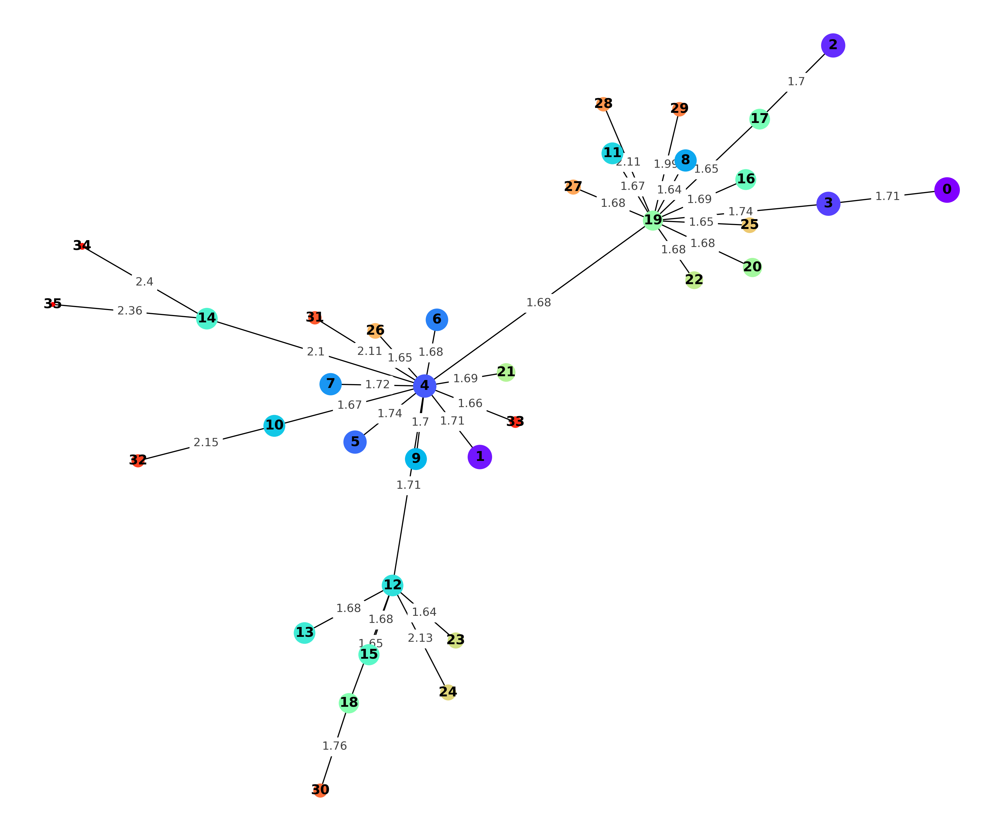

In [2]:
colors = cm.rainbow(np.linspace(0, 1, 36))

graph = nx.Graph()

for u in range(len(edge)):

    graph.add_edge(edge[u][0], edge[u][1], weight = edge_weight[u], length = edge_length_normalized[u])

pos = nx.spring_layout(graph, iterations = 3000, weight = 'weight')

plt.figure(figsize = (12, 10), dpi = 300) 
nx.draw(graph, pos, with_labels = True, font_weight = 'bold', node_size = cluster_size[connect_order], node_color = colors[connect_order])
nx.draw_networkx_edge_labels(graph, pos, nx.get_edge_attributes(graph, 'length'), rotate = False, alpha = 0.75)

plt.show()

In [3]:
color_AF = cm.Reds(np.linspace(0, 1, 101))

fig, axs = plt.subplots(2, 4, dpi = 300)
fig.set_size_inches(48, 20)
ax = axs.flatten()

k = 0
celltype = np.zeros(9126)
celltype[refer["CellType"].to_numpy()[include][cell_filter[include_sample]] == 'T'] = 1
celltype = celltype.astype(bool)

freq = np.zeros(36)

for w in range(36):
    
    freq[w] = np.sum(assigned_label[np.array(include_sample)[cell_filter]][celltype] == w)
    
freq = freq ** 2 / np.sum(freq) / cluster_size

graph = nx.Graph()

for u in range(len(edge)):

    graph.add_edge(edge[u][0], edge[u][1], weight = edge_weight[u], length = edge_length_normalized[u])

nx.draw(graph, pos, with_labels = True, font_weight = 'bold', node_size = cluster_size[connect_order], node_color = color_AF[np.round(freq[connect_order] * [100 / np.max(freq[connect_order])]).astype(int), :], ax = ax[k])
ax[k].set_title('Helper T cells', fontsize = 45)

k = 1
celltype = np.zeros(9126)
celltype[refer["CellType"].to_numpy()[include][cell_filter[include_sample]] == 'CTL'] = 1
celltype = celltype.astype(bool)

freq = np.zeros(36)

for w in range(36):
    
    freq[w] = np.sum(assigned_label[np.array(include_sample)[cell_filter]][celltype] == w)
    
freq = freq ** 2 / np.sum(freq) / cluster_size

graph = nx.Graph()

for u in range(len(edge)):

    graph.add_edge(edge[u][0], edge[u][1], weight = edge_weight[u], length = edge_length_normalized[u])

nx.draw(graph, pos, with_labels = True, font_weight = 'bold', node_size = cluster_size[connect_order], node_color = color_AF[np.round(freq[connect_order] * [100 / np.max(freq[connect_order])]).astype(int), :], ax = ax[k])
ax[k].set_title('Cytotoxic T cells', fontsize = 45)

k = 2
celltype = np.zeros(9126)
celltype[refer["CellType"].to_numpy()[include][cell_filter[include_sample]] == 'B'] = 1
celltype[refer["CellType"].to_numpy()[include][cell_filter[include_sample]] == 'Plasma'] = 1
celltype = celltype.astype(bool)

freq = np.zeros(36)

for w in range(36):
    
    freq[w] = np.sum(assigned_label[np.array(include_sample)[cell_filter]][celltype] == w)
    
freq = freq ** 2 / np.sum(freq) / cluster_size

graph = nx.Graph()

for u in range(len(edge)):

    graph.add_edge(edge[u][0], edge[u][1], weight = edge_weight[u], length = edge_length_normalized[u])

nx.draw(graph, pos, with_labels = True, font_weight = 'bold', node_size = cluster_size[connect_order], node_color = color_AF[np.round(freq[connect_order] * [100 / np.max(freq[connect_order])]).astype(int), :], ax = ax[k])
ax[k].set_title('B cells', fontsize = 45)

k = 3
celltype = np.zeros(9126)
celltype[refer["CellType"].to_numpy()[include][cell_filter[include_sample]] == 'NK'] = 1
celltype = celltype.astype(bool)

freq = np.zeros(36)

for w in range(36):
    
    freq[w] = np.sum(assigned_label[np.array(include_sample)[cell_filter]][celltype] == w)
    
freq = freq ** 2 / np.sum(freq) / cluster_size

graph = nx.Graph()

for u in range(len(edge)):

    graph.add_edge(edge[u][0], edge[u][1], weight = edge_weight[u], length = edge_length_normalized[u])

nx.draw(graph, pos, with_labels = True, font_weight = 'bold', node_size = cluster_size[connect_order], node_color = color_AF[np.round(freq[connect_order] * [100 / np.max(freq[connect_order])]).astype(int), :], ax = ax[k])
ax[k].set_title('NK cells', fontsize = 45)

k = 4
celltype = np.zeros(9126)
celltype[refer["CellType"].to_numpy()[include][cell_filter[include_sample]] == 'ProMono'] = 1
celltype[refer["CellType"].to_numpy()[include][cell_filter[include_sample]] == 'ncMono'] = 1
celltype[refer["CellType"].to_numpy()[include][cell_filter[include_sample]] == 'Mono'] = 1
celltype = celltype.astype(bool)

freq = np.zeros(36)

for w in range(36):
    
    freq[w] = np.sum(assigned_label[np.array(include_sample)[cell_filter]][celltype] == w)
    
freq = freq ** 2 / np.sum(freq) / cluster_size

graph = nx.Graph()

for u in range(len(edge)):

    graph.add_edge(edge[u][0], edge[u][1], weight = edge_weight[u], length = edge_length_normalized[u])

nx.draw(graph, pos, with_labels = True, font_weight = 'bold', node_size = cluster_size[connect_order], node_color = color_AF[np.round(freq[connect_order] * [100 / np.max(freq[connect_order])]).astype(int), :], ax = ax[k])
ax[k].set_title('Monocytes', fontsize = 45)

k = 5
celltype = np.zeros(9126)
celltype[refer["CellType"].to_numpy()[include][cell_filter[include_sample]] == 'LateE'] = 1
celltype[refer["CellType"].to_numpy()[include][cell_filter[include_sample]] == 'EarlyE'] = 1
celltype = celltype.astype(bool)

freq = np.zeros(36)

for w in range(36):
    
    freq[w] = np.sum(assigned_label[np.array(include_sample)[cell_filter]][celltype] == w)
    
freq = freq ** 2 / np.sum(freq) / cluster_size

graph = nx.Graph()

for u in range(len(edge)):

    graph.add_edge(edge[u][0], edge[u][1], weight = edge_weight[u], length = edge_length_normalized[u])

nx.draw(graph, pos, with_labels = True, font_weight = 'bold', node_size = cluster_size[connect_order], node_color = color_AF[np.round(freq[connect_order] * [100 / np.max(freq[connect_order])]).astype(int), :], ax = ax[k])
ax[k].set_title('Erythroid cells', fontsize = 45)

k = 6
celltype = np.zeros(9126)
celltype[refer["CellType"].to_numpy()[include][cell_filter[include_sample]] == 'cDC'] = 1
celltype[refer["CellType"].to_numpy()[include][cell_filter[include_sample]] == 'pDC'] = 1
celltype = celltype.astype(bool)

freq = np.zeros(36)

for w in range(36):
    
    freq[w] = np.sum(assigned_label[np.array(include_sample)[cell_filter]][celltype] == w)
    
freq = freq ** 2 / np.sum(freq) / cluster_size

graph = nx.Graph()

for u in range(len(edge)):

    graph.add_edge(edge[u][0], edge[u][1], weight = edge_weight[u], length = edge_length_normalized[u])

nx.draw(graph, pos, with_labels = True, font_weight = 'bold', node_size = cluster_size[connect_order], node_color = color_AF[np.round(freq[connect_order] * [100 / np.max(freq[connect_order])]).astype(int), :], ax = ax[k])
ax[k].set_title('Dendritic cells', fontsize = 45)

k = 7
celltype = np.zeros(9126)
celltype[refer["CellType"].to_numpy()[include][cell_filter[include_sample]] == 'HSC'] = 1
celltype[refer["CellType"].to_numpy()[include][cell_filter[include_sample]] == 'Prog'] = 1
celltype = celltype.astype(bool)

freq = np.zeros(36)

for w in range(36):
    
    freq[w] = np.sum(assigned_label[np.array(include_sample)[cell_filter]][celltype] == w)
    
freq = freq ** 2 / np.sum(freq) / cluster_size

graph = nx.Graph()

for u in range(len(edge)):

    graph.add_edge(edge[u][0], edge[u][1], weight = edge_weight[u], length = edge_length_normalized[u])

nx.draw(graph, pos, with_labels = True, font_weight = 'bold', node_size = cluster_size[connect_order], node_color = color_AF[np.round(freq[connect_order] * [100 / np.max(freq[connect_order])]).astype(int), :], ax = ax[k])
ax[k].set_title('HSPCs', fontsize = 45)

plt.show()

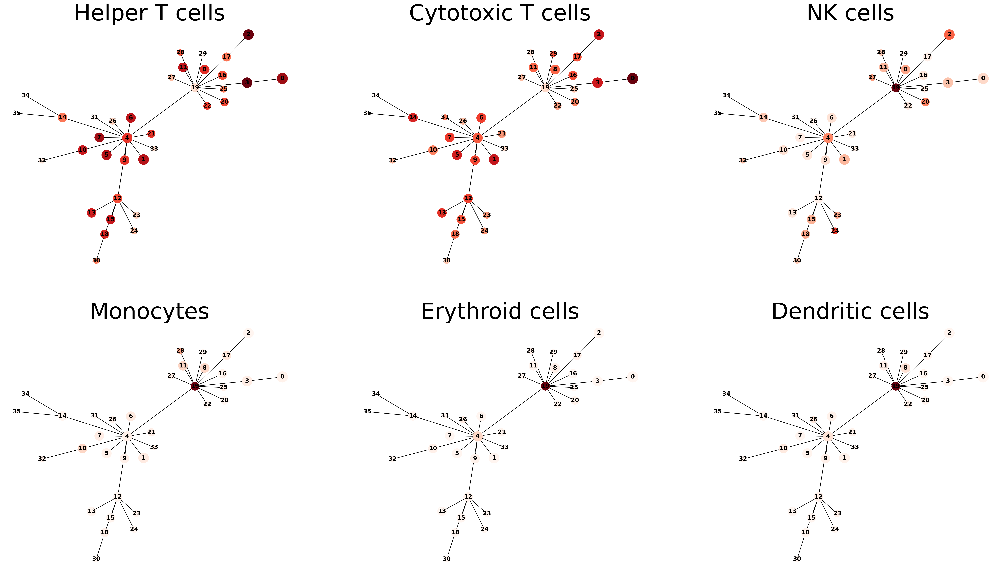

In [6]:
color_AF = cm.Reds(np.linspace(0, 1, 101))

fig, axs = plt.subplots(2, 3, dpi = 300)
fig.set_size_inches(36, 20)
ax = axs.flatten()

k = 0
celltype = np.zeros(9126)
celltype[refer["CellType"].to_numpy()[include][cell_filter[include_sample]] == 'T'] = 1
celltype = celltype.astype(bool)

freq = np.zeros(36)

for w in range(36):
    
    freq[w] = np.sum(assigned_label[np.array(include_sample)[cell_filter]][celltype] == w)
    
freq = freq ** 2 / np.sum(freq) / cluster_size

graph = nx.Graph()

for u in range(len(edge)):

    graph.add_edge(edge[u][0], edge[u][1], weight = edge_weight[u], length = edge_length_normalized[u])

nx.draw(graph, pos, with_labels = True, font_weight = 'bold', node_size = cluster_size[connect_order], node_color = color_AF[np.round(freq[connect_order] * [100 / np.max(freq[connect_order])]).astype(int), :], ax = ax[k])
ax[k].set_title('Helper T cells', fontsize = 45)

k = 1
celltype = np.zeros(9126)
celltype[refer["CellType"].to_numpy()[include][cell_filter[include_sample]] == 'CTL'] = 1
celltype = celltype.astype(bool)

freq = np.zeros(36)

for w in range(36):
    
    freq[w] = np.sum(assigned_label[np.array(include_sample)[cell_filter]][celltype] == w)
    
freq = freq ** 2 / np.sum(freq) / cluster_size

graph = nx.Graph()

for u in range(len(edge)):

    graph.add_edge(edge[u][0], edge[u][1], weight = edge_weight[u], length = edge_length_normalized[u])

nx.draw(graph, pos, with_labels = True, font_weight = 'bold', node_size = cluster_size[connect_order], node_color = color_AF[np.round(freq[connect_order] * [100 / np.max(freq[connect_order])]).astype(int), :], ax = ax[k])
ax[k].set_title('Cytotoxic T cells', fontsize = 45)

k = 2
celltype = np.zeros(9126)
celltype[refer["CellType"].to_numpy()[include][cell_filter[include_sample]] == 'NK'] = 1
celltype = celltype.astype(bool)

freq = np.zeros(36)

for w in range(36):
    
    freq[w] = np.sum(assigned_label[np.array(include_sample)[cell_filter]][celltype] == w)
    
freq = freq ** 2 / np.sum(freq) / cluster_size

graph = nx.Graph()

for u in range(len(edge)):

    graph.add_edge(edge[u][0], edge[u][1], weight = edge_weight[u], length = edge_length_normalized[u])

nx.draw(graph, pos, with_labels = True, font_weight = 'bold', node_size = cluster_size[connect_order], node_color = color_AF[np.round(freq[connect_order] * [100 / np.max(freq[connect_order])]).astype(int), :], ax = ax[k])
ax[k].set_title('NK cells', fontsize = 45)

k = 3
celltype = np.zeros(9126)
celltype[refer["CellType"].to_numpy()[include][cell_filter[include_sample]] == 'ProMono'] = 1
celltype[refer["CellType"].to_numpy()[include][cell_filter[include_sample]] == 'ncMono'] = 1
celltype[refer["CellType"].to_numpy()[include][cell_filter[include_sample]] == 'Mono'] = 1
celltype = celltype.astype(bool)

freq = np.zeros(36)

for w in range(36):
    
    freq[w] = np.sum(assigned_label[np.array(include_sample)[cell_filter]][celltype] == w)
    
freq = freq ** 2 / np.sum(freq) / cluster_size

graph = nx.Graph()

for u in range(len(edge)):

    graph.add_edge(edge[u][0], edge[u][1], weight = edge_weight[u], length = edge_length_normalized[u])

nx.draw(graph, pos, with_labels = True, font_weight = 'bold', node_size = cluster_size[connect_order], node_color = color_AF[np.round(freq[connect_order] * [100 / np.max(freq[connect_order])]).astype(int), :], ax = ax[k])
ax[k].set_title('Monocytes', fontsize = 45)

k = 4
celltype = np.zeros(9126)
celltype[refer["CellType"].to_numpy()[include][cell_filter[include_sample]] == 'LateE'] = 1
celltype[refer["CellType"].to_numpy()[include][cell_filter[include_sample]] == 'EarlyE'] = 1
celltype = celltype.astype(bool)

freq = np.zeros(36)

for w in range(36):
    
    freq[w] = np.sum(assigned_label[np.array(include_sample)[cell_filter]][celltype] == w)
    
freq = freq ** 2 / np.sum(freq) / cluster_size

graph = nx.Graph()

for u in range(len(edge)):

    graph.add_edge(edge[u][0], edge[u][1], weight = edge_weight[u], length = edge_length_normalized[u])

nx.draw(graph, pos, with_labels = True, font_weight = 'bold', node_size = cluster_size[connect_order], node_color = color_AF[np.round(freq[connect_order] * [100 / np.max(freq[connect_order])]).astype(int), :], ax = ax[k])
ax[k].set_title('Erythroid cells', fontsize = 45)

k = 5
celltype = np.zeros(9126)
celltype[refer["CellType"].to_numpy()[include][cell_filter[include_sample]] == 'cDC'] = 1
celltype[refer["CellType"].to_numpy()[include][cell_filter[include_sample]] == 'pDC'] = 1
celltype = celltype.astype(bool)

freq = np.zeros(36)

for w in range(36):
    
    freq[w] = np.sum(assigned_label[np.array(include_sample)[cell_filter]][celltype] == w)
    
freq = freq ** 2 / np.sum(freq) / cluster_size

graph = nx.Graph()

for u in range(len(edge)):

    graph.add_edge(edge[u][0], edge[u][1], weight = edge_weight[u], length = edge_length_normalized[u])

nx.draw(graph, pos, with_labels = True, font_weight = 'bold', node_size = cluster_size[connect_order], node_color = color_AF[np.round(freq[connect_order] * [100 / np.max(freq[connect_order])]).astype(int), :], ax = ax[k])
ax[k].set_title('Dendritic cells', fontsize = 45)

plt.show()

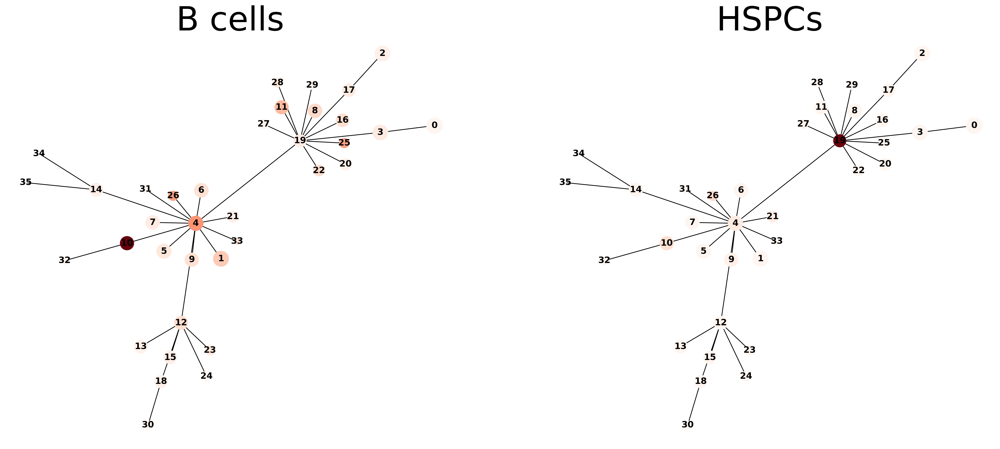

In [7]:
color_AF = cm.Reds(np.linspace(0, 1, 101))

fig, axs = plt.subplots(1, 2, dpi = 300)
fig.set_size_inches(24, 10)
ax = axs.flatten()

k = 0
celltype = np.zeros(9126)
celltype[refer["CellType"].to_numpy()[include][cell_filter[include_sample]] == 'B'] = 1
celltype[refer["CellType"].to_numpy()[include][cell_filter[include_sample]] == 'Plasma'] = 1
celltype = celltype.astype(bool)

freq = np.zeros(36)

for w in range(36):
    
    freq[w] = np.sum(assigned_label[np.array(include_sample)[cell_filter]][celltype] == w)
    
freq = freq ** 2 / np.sum(freq) / cluster_size

graph = nx.Graph()

for u in range(len(edge)):

    graph.add_edge(edge[u][0], edge[u][1], weight = edge_weight[u], length = edge_length_normalized[u])

nx.draw(graph, pos, with_labels = True, font_weight = 'bold', node_size = cluster_size[connect_order], node_color = color_AF[np.round(freq[connect_order] * [100 / np.max(freq[connect_order])]).astype(int), :], ax = ax[k])
ax[k].set_title('B cells', fontsize = 45)

k = 1
celltype = np.zeros(9126)
celltype[refer["CellType"].to_numpy()[include][cell_filter[include_sample]] == 'HSC'] = 1
celltype[refer["CellType"].to_numpy()[include][cell_filter[include_sample]] == 'Prog'] = 1
celltype = celltype.astype(bool)

freq = np.zeros(36)

for w in range(36):
    
    freq[w] = np.sum(assigned_label[np.array(include_sample)[cell_filter]][celltype] == w)
    
freq = freq ** 2 / np.sum(freq) / cluster_size

graph = nx.Graph()

for u in range(len(edge)):

    graph.add_edge(edge[u][0], edge[u][1], weight = edge_weight[u], length = edge_length_normalized[u])

nx.draw(graph, pos, with_labels = True, font_weight = 'bold', node_size = cluster_size[connect_order], node_color = color_AF[np.round(freq[connect_order] * [100 / np.max(freq[connect_order])]).astype(int), :], ax = ax[k])
ax[k].set_title('HSPCs', fontsize = 45)

plt.show()

In [8]:
TCR = pd.read_csv("/home/u3570318/mount2/figures_final2/data/BPDCN/GSM5534712_BPDCN712_TCR_clonotypes.csv")

include_T = []
include_sample_T = []

for w in range(len(sample["sample"].to_list())):
    
    if sample["sample"].to_list()[w][:-2] in TCR["BC"].to_numpy():
    
        include_T.append(np.where(TCR["BC"].to_numpy() == sample["sample"].to_list()[w][:-2])[0][0])
        include_sample_T.append(True)
        
    elif sample["sample"].to_list()[w][:-2] not in TCR["BC"].to_numpy():
    
        include_sample_T.append(False)

counter = collections.Counter(TCR["TRB_CDR3"].to_numpy()[include_T][cell_filter[include_sample_T]])
values = list(counter.values())
keys = list(counter.keys())

list_bar = ['CASSQAGAANTEAFF',
 'CASSLVEEKLFF',
 'CASSLTGGSYNEQFF',
 'CASSPFEETQYF',
 'CASSFRQGYNEQFF',
 'CASSATRAETQYF',
 'CASIPGPGTSGYNEQFF',
 'CASSLEWGNPSTYEQYF']

In [5]:
color_AF = cm.Reds(np.linspace(0, 1, 101))
list_bar = ['CASSQAGAANTEAFF',
 'CASSLVEEKLFF',
 'CASSLTGGSYNEQFF',
 'CASSPFEETQYF',
 'CASSFRQGYNEQFF',
 'CASSATRAETQYF',
 'CASIPGPGTSGYNEQFF',
 'CASSLEWGNPSTYEQYF']

fig, axs = plt.subplots(2, 4, dpi = 300)
fig.set_size_inches(48, 20)
ax = axs.flatten()

for k in range(8):
    
    celltype = np.zeros(6567)
    celltype[TCR["TRB_CDR3"].to_numpy()[include_T][cell_filter[include_sample_T]] == list_bar[k]] = 1
    celltype = celltype.astype(bool)

    freq = np.zeros(36)

    for w in range(36):

        freq[w] = np.sum(assigned_label[np.array(include_sample_T)[cell_filter]][celltype] == w)

    freq = freq ** 2 / np.sum(freq) / cluster_size

    graph = nx.Graph()

    for u in range(len(edge)):

        graph.add_edge(edge[u][0], edge[u][1], weight = edge_weight[u], length = edge_length_normalized[u])

    nx.draw(graph, pos, with_labels = True, font_weight = 'bold', node_size = cluster_size[connect_order], node_color = color_AF[np.round(freq[connect_order] * [100 / np.max(freq[connect_order])]).astype(int), :], ax = ax[k])
    ax[k].set_title(list_bar[k], fontsize = 45)

plt.show()

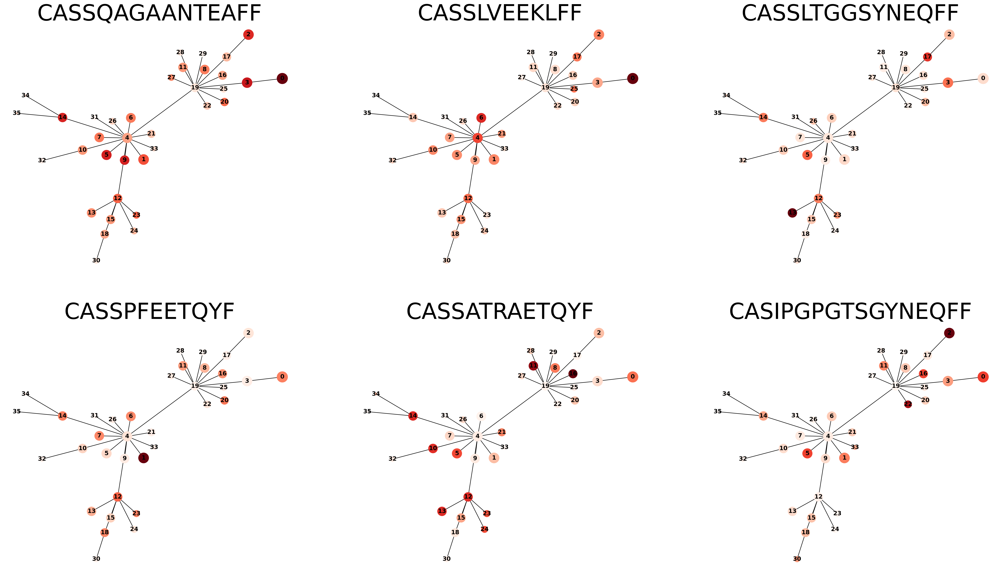

In [9]:
color_AF = cm.Reds(np.linspace(0, 1, 101))
list_bar = ['CASSQAGAANTEAFF',
 'CASSLVEEKLFF',
 'CASSLTGGSYNEQFF',
 'CASSPFEETQYF',
 'CASSATRAETQYF',
 'CASIPGPGTSGYNEQFF']

fig, axs = plt.subplots(2, 3, dpi = 300)
fig.set_size_inches(36, 20)
ax = axs.flatten()

for k in range(6):
    
    celltype = np.zeros(6567)
    celltype[TCR["TRB_CDR3"].to_numpy()[include_T][cell_filter[include_sample_T]] == list_bar[k]] = 1
    celltype = celltype.astype(bool)

    freq = np.zeros(36)

    for w in range(36):

        freq[w] = np.sum(assigned_label[np.array(include_sample_T)[cell_filter]][celltype] == w)

    freq = freq ** 2 / np.sum(freq) / cluster_size

    graph = nx.Graph()

    for u in range(len(edge)):

        graph.add_edge(edge[u][0], edge[u][1], weight = edge_weight[u], length = edge_length_normalized[u])

    nx.draw(graph, pos, with_labels = True, font_weight = 'bold', node_size = cluster_size[connect_order], node_color = color_AF[np.round(freq[connect_order] * [100 / np.max(freq[connect_order])]).astype(int), :], ax = ax[k])
    ax[k].set_title(list_bar[k], fontsize = 45)

plt.show()

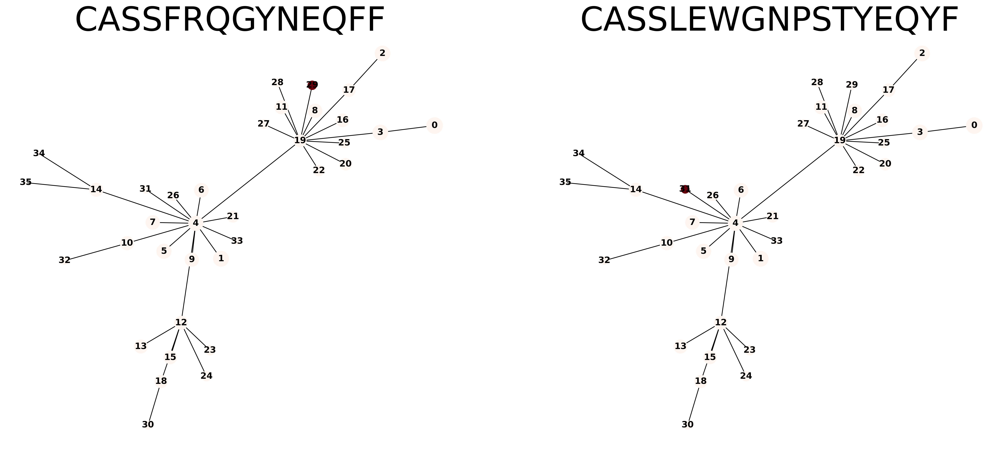

In [10]:
color_AF = cm.Reds(np.linspace(0, 1, 101))
list_bar = ['CASSFRQGYNEQFF',
 'CASSLEWGNPSTYEQYF']

fig, axs = plt.subplots(1, 2, dpi = 300)
fig.set_size_inches(24, 10)
ax = axs.flatten()

for k in range(2):
    
    celltype = np.zeros(6567)
    celltype[TCR["TRB_CDR3"].to_numpy()[include_T][cell_filter[include_sample_T]] == list_bar[k]] = 1
    celltype = celltype.astype(bool)

    freq = np.zeros(36)

    for w in range(36):

        freq[w] = np.sum(assigned_label[np.array(include_sample_T)[cell_filter]][celltype] == w)

    freq = freq ** 2 / np.sum(freq) / cluster_size

    graph = nx.Graph()

    for u in range(len(edge)):

        graph.add_edge(edge[u][0], edge[u][1], weight = edge_weight[u], length = edge_length_normalized[u])

    nx.draw(graph, pos, with_labels = True, font_weight = 'bold', node_size = cluster_size[connect_order], node_color = color_AF[np.round(freq[connect_order] * [100 / np.max(freq[connect_order])]).astype(int), :], ax = ax[k])
    ax[k].set_title(list_bar[k], fontsize = 45)

plt.show()

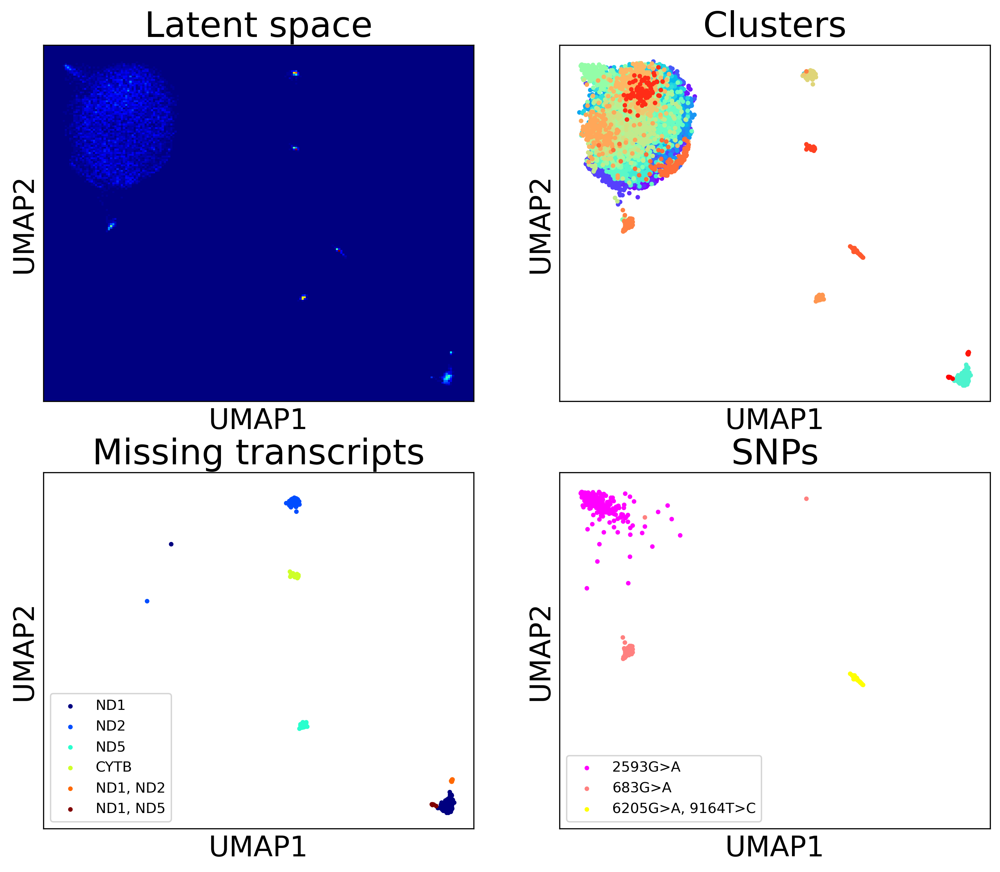

In [2]:
import numpy as np
import pandas as pd
import matplotlib.cm as cm 
import matplotlib.pyplot as plt

embedding_2d = np.genfromtxt("embedding_2d.csv", delimiter=",")
cell_filter = np.array(np.genfromtxt("cell_filter.csv", delimiter=","), dtype=bool)
assigned_label = np.genfromtxt("assigned_label.csv", delimiter=",")

cluster_no = 36

colors = cm.rainbow(np.linspace(0, 1, cluster_no))

clusters = []
    
for g in range(cluster_no):

    clusters.append(np.where(assigned_label == g)[0])

fig, axs = plt.subplots(2, 2, dpi = 300)
fig.set_size_inches(12, 10)

axs[0, 1].set_title("Clusters", fontsize = 25)

for w in range(cluster_no):
    
    axs[0, 1].scatter(embedding_2d[clusters[w], 0], embedding_2d[clusters[w], 1], s = 5, color = colors[w])
    
axs[0, 1].set_xticks([])
axs[0, 1].set_yticks([])
axs[0, 1].set_xlabel("UMAP1", fontsize = 20)
axs[0, 1].set_ylabel("UMAP2", fontsize = 20)

xlim_embedding_2d = axs[0, 1].get_xlim()
ylim_embedding_2d = axs[0, 1].get_ylim()

axs[0, 0].hist2d(embedding_2d[:, 0], embedding_2d[:, 1], bins = (200, 200), cmap = plt.cm.jet, range = np.array([xlim_embedding_2d, ylim_embedding_2d]))
axs[0, 0].set_xticks([])
axs[0, 0].set_yticks([])
axs[0, 0].set_title("Latent space", fontsize = 25)
axs[0, 0].set_xlabel("UMAP1", fontsize = 20)
axs[0, 0].set_ylabel("UMAP2", fontsize = 20)

axs[1, 1].set_title("SNPs", fontsize = 25)

colors = cm.spring(np.linspace(0, 1, 3))

axs[1, 1].scatter(embedding_2d[clusters[19], 0], embedding_2d[clusters[19], 1], s = 5, color = colors[0], label = '2593G>A')

axs[1, 1].scatter(embedding_2d[clusters[29], 0], embedding_2d[clusters[29], 1], s = 5, color = colors[1], label = '683G>A')
    
axs[1, 1].scatter(embedding_2d[clusters[31], 0], embedding_2d[clusters[31], 1], s = 5, color = colors[2], label = '6205G>A, 9164T>C')
    
axs[1, 1].set_xticks([])
axs[1, 1].set_yticks([])
axs[1, 1].set_xlim(xlim_embedding_2d)
axs[1, 1].set_ylim(ylim_embedding_2d)
axs[1, 1].set_xlabel("UMAP1", fontsize = 20)
axs[1, 1].set_ylabel("UMAP2", fontsize = 20)
axs[1, 1].legend(loc ="lower left", fontsize = "10")

axs[1, 0].set_title("Missing transcripts", fontsize = 25)

colors = cm.jet(np.linspace(0, 1, 6))

axs[1, 0].scatter(embedding_2d[clusters[14], 0], embedding_2d[clusters[14], 1], s = 5, color = colors[0], label = 'ND1')
    
axs[1, 0].scatter(embedding_2d[clusters[24], 0], embedding_2d[clusters[24], 1], s = 5, color = colors[1], label = 'ND2')
    
axs[1, 0].scatter(embedding_2d[clusters[28], 0], embedding_2d[clusters[28], 1], s = 5, color = colors[2], label = 'ND5')

axs[1, 0].scatter(embedding_2d[clusters[32], 0], embedding_2d[clusters[32], 1], s = 5, color = colors[3], label = 'CYTB')

axs[1, 0].scatter(embedding_2d[clusters[34], 0], embedding_2d[clusters[34], 1], s = 5, color = colors[4], label = 'ND1, ND2')

axs[1, 0].scatter(embedding_2d[clusters[35], 0], embedding_2d[clusters[35], 1], s = 5, color = colors[5], label = 'ND1, ND5')
    
axs[1, 0].set_xticks([])
axs[1, 0].set_yticks([])
axs[1, 0].set_xlim(xlim_embedding_2d)
axs[1, 0].set_ylim(ylim_embedding_2d)
axs[1, 0].set_xlabel("UMAP1", fontsize = 20)
axs[1, 0].set_ylabel("UMAP2", fontsize = 20)
axs[1, 0].legend(loc ="lower left", fontsize = "10")

plt.show()

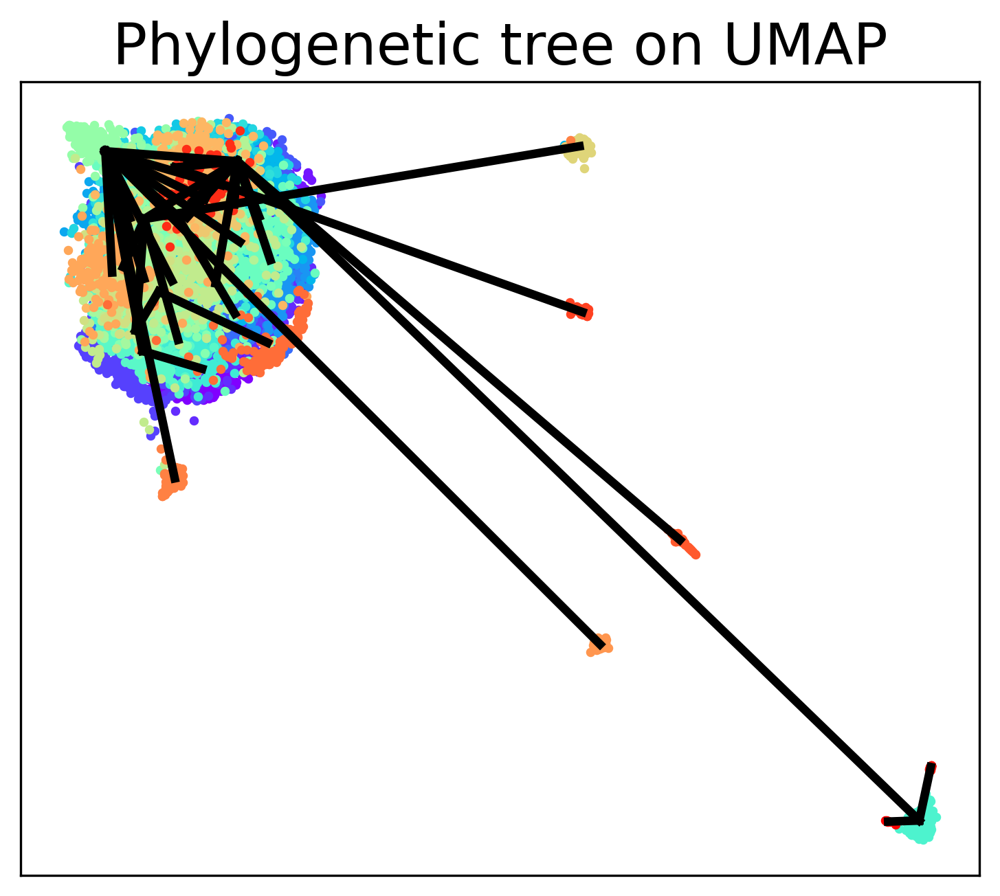

In [9]:
centre_2d = np.empty((cluster_no, 2))

for k in range(cluster_no):
    
    centre_2d[k, :] = np.mean(embedding_2d[clusters[k], :], 0)
    
edge = [(30, 18), (18, 15), (13, 12), (15, 12), (24, 12), (23, 12), (12, 4), (4, 9), (1, 4), (5, 4), (33, 4), (21, 4), (32, 10), (10, 4), (7, 4), (6, 4), (26, 4), (31, 4), (4, 14), (14, 34), (14, 35), (4, 19), (19, 22), (19, 27), (19, 11), (19, 28), (19, 20), (19, 25), (19, 29), (19, 8), (19, 16), (19, 17), (17, 2), (19, 3), (3, 0)]


colors = cm.rainbow(np.linspace(0, 1, cluster_no))

fig, axs = plt.subplots(1, 1, dpi = 300)
fig.set_size_inches(6, 5)

axs.set_title("Phylogenetic tree on UMAP", fontsize = 20)
axs.set_xticks([])
axs.set_yticks([])

for g in range(cluster_no):

    axs.scatter(embedding_2d[clusters[g], 0], embedding_2d[clusters[g], 1], s = 5, color = colors[g])

for g in range(len(edge)):

    axs.plot([centre_2d[edge[g][0], 0], centre_2d[edge[g][1], 0]], [centre_2d[edge[g][0], 1], centre_2d[edge[g][1], 1]], linewidth = 3, color = "black")

plt.show()